<a href="https://colab.research.google.com/github/matteo9910/StressDetectionBasedOnWearableSensorData/blob/main/VerBIO_Public.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import warnings
warnings.filterwarnings('ignore')

In [ ]:
import zipfile
import os
import pandas as pd
import pickle
import matplotlib.pyplot as plt
from scipy.signal import butter, filtfilt, iirnotch
import seaborn as sns
import scipy.stats as stats
import numpy as np
from scipy.stats import shapiro
import math
from scipy.stats import mannwhitneyu
from scipy.signal import welch
import ipywidgets as widgets
from IPython.display import display
import statsmodels.api as sm
from statsmodels.formula.api import ols
from scipy.signal import resample
from scipy.signal import find_peaks
import scipy.signal
from scipy.interpolate import interp1d
import glob
from glob import glob
import math

In [ ]:
def read_signal_file(filepath, signal, condition):
    try:
        df = pd.read_csv(filepath, skiprows=1)

        if condition == 'PPT':
            if signal == 'ACC' and df.shape[1] >= 4:
                df = df.iloc[:, 1:4]
                df.columns = ['ACC1', 'ACC2', 'ACC3']
            elif signal in ['BVP', 'EDA', 'TEMP'] and df.shape[1] >= 2:
                df = df.iloc[:, [1]]
                df.columns = [signal]
            else:
                raise ValueError(f"Formato inatteso in {filepath}")
        else:
            if signal == 'ACC' and df.shape[1] == 3:
                df.columns = ['ACC1', 'ACC2', 'ACC3']
            elif signal in ['BVP', 'EDA', 'TEMP'] and df.shape[1] == 1:
                df.columns = [signal]
            else:
                raise ValueError(f"Formato inatteso in {filepath}")

        return df

    except Exception as e:
        print(f"[ERROR] Errore nel file {filepath}: {e}")
        return None

In [ ]:
def upsample_signals(signals_dict, target_freq=64):
    """
    Effettua l'upsampling di ogni segnale nel dizionario signals_dict alla lunghezza massima
    tra tutti i segnali, basata sulla frequenza target.
    """
    max_duration = max(len(signal) for signal in signals_dict.values()) / target_freq
    target_length = int(max_duration * target_freq)

    upsampled_signals = {}
    for name, signal in signals_dict.items():
        resampled_signal = resample(signal, target_length)
        upsampled_signals[name] = resampled_signal

    return pd.DataFrame(upsampled_signals)

In [ ]:
def load_subject_data(subject, base_dir, valid_tests_map):
    phases = ['PRE', 'POST']
    conditions = ['RELAX', 'PPT']
    signals = ['ACC', 'BVP', 'EDA', 'TEMP']
    data = []

    for phase in phases:
        for condition in conditions:
            signal_dict = {}
            for signal in signals:
                file_path = os.path.join(base_dir, phase, "E4", subject, f"{signal}_{condition}.csv")
                df_signal = read_signal_file(file_path, signal, condition)
                if df_signal is not None:
                    for col in df_signal.columns:
                        signal_dict[col] = df_signal[col].values

            if signal_dict:
                df_upsampled = upsample_signals(signal_dict)
                df_upsampled["subject"] = subject
                df_upsampled["session"] = phase
                df_upsampled["phase"] = condition
                data.append(df_upsampled)

    for test_name in valid_tests_map[subject]:
        for condition in conditions:
            signal_dict = {}
            for signal in signals:
                file_path = os.path.join(base_dir, "TEST", test_name, "E4", subject, f"{signal}_{condition}.csv")
                df_signal = read_signal_file(file_path, signal, condition)
                if df_signal is not None:
                    for col in df_signal.columns:
                        signal_dict[col] = df_signal[col].values

            if signal_dict:
                df_upsampled = upsample_signals(signal_dict)
                df_upsampled["subject"] = subject
                df_upsampled["session"] = test_name
                df_upsampled["phase"] = condition
                data.append(df_upsampled)

    if data:
        df_final = pd.concat(data, ignore_index=True)
        signal_cols = ['ACC1', 'ACC2', 'ACC3', 'BVP', 'EDA', 'TEMP']
        meta_cols = ['subject', 'session', 'phase']
        all_cols = [col for col in signal_cols if col in df_final.columns] + meta_cols
        return df_final[all_cols]
    else:
        print(f"Nessun dato caricato per {subject}")
        return pd.DataFrame()

In [ ]:
def load_all_subjects_data(base_dir, complete_subjects_map):
    all_data = []
    for subject, valid_tests in complete_subjects_map.items():
        print(f"Caricamento soggetto {subject} con TEST validi: {valid_tests}")
        df_subject = load_subject_data(subject, base_dir, complete_subjects_map)
        if not df_subject.empty:
            all_data.append(df_subject)
    if all_data:
        return pd.concat(all_data, ignore_index=True)
    else:
        print("Nessun dato disponibile per i soggetti completi.")
        return pd.DataFrame()

In [ ]:
base_dir = "/content/drive/MyDrive/VerBIO_Public"

complete_subjects_map = {
    "P005": ["TEST01", "TEST05"],
    "P008": ["TEST01", "TEST05"],
    "P023": ["TEST01", "TEST05"],
    "P032": ["TEST01", "TEST05"],
    "P035": ["TEST01", "TEST05"],
    "P037": ["TEST01", "TEST05"],
    "P038": ["TEST01"],
    "P041": ["TEST01", "TEST05"],
    "P043": ["TEST01"],
    "P044": ["TEST01", "TEST05"],
    "P046": ["TEST01"],
    "P047": ["TEST01", "TEST05"],
    "P049": ["TEST01"],
    "P058": ["TEST01"],
    "P062": ["TEST01", "TEST05"],
    "P065": ["TEST01", "TEST05"],
    "P071": ["TEST01", "TEST05"],
}

df_all = load_all_subjects_data(base_dir, complete_subjects_map)

Caricamento soggetto P005 con TEST validi: ['TEST01', 'TEST05']
Caricamento soggetto P008 con TEST validi: ['TEST01', 'TEST05']
Caricamento soggetto P023 con TEST validi: ['TEST01', 'TEST05']
Caricamento soggetto P032 con TEST validi: ['TEST01', 'TEST05']
Caricamento soggetto P035 con TEST validi: ['TEST01', 'TEST05']
Caricamento soggetto P037 con TEST validi: ['TEST01', 'TEST05']
Caricamento soggetto P038 con TEST validi: ['TEST01']
Caricamento soggetto P041 con TEST validi: ['TEST01', 'TEST05']
Caricamento soggetto P043 con TEST validi: ['TEST01']
Caricamento soggetto P044 con TEST validi: ['TEST01', 'TEST05']
Caricamento soggetto P046 con TEST validi: ['TEST01']
Caricamento soggetto P047 con TEST validi: ['TEST01', 'TEST05']
Caricamento soggetto P049 con TEST validi: ['TEST01']
Caricamento soggetto P058 con TEST validi: ['TEST01']
Caricamento soggetto P062 con TEST validi: ['TEST01', 'TEST05']
Caricamento soggetto P065 con TEST validi: ['TEST01', 'TEST05']
Caricamento soggetto P071 

In [ ]:
df_all.head()

,ACC1,ACC2,ACC3,BVP,EDA,TEMP,subject,session,phase
0,12.000000,13.000000,60.000000,-8.26,0.133470,32.050000,P005,PRE,RELAX
1,5.769194,15.372568,68.929877,-10.13,0.130896,32.054514,P005,PRE,RELAX
2,14.000000,13.000000,61.000000,-12.01,0.128816,32.058249,P005,PRE,RELAX
3,18.849692,12.256620,55.569971,-13.52,0.127238,32.061199,P005,PRE,RELAX
4,15.000000,14.000000,61.000000,-14.26,0.126157,32.063375,P005,PRE,RELAX


In [ ]:
def plot_boxplots_relax_vs_ppt(df):
    # Seleziona solo colonne numeriche, escludendo label
    numeric_cols = df.select_dtypes(include='number').columns
    signal_cols = [col for col in numeric_cols if col not in ['label']]

    n = len(signal_cols)
    cols = 3
    rows = math.ceil(n / cols)

    fig, axes = plt.subplots(rows, cols, figsize=(cols * 6, rows * 5))
    axes = axes.flatten()

    palette = {"RELAX": "#1f77b4", "PPT": "#ff7f0e"}  # Blu e Arancione

    for idx, signal in enumerate(signal_cols):
        ax = axes[idx]
        sns.boxplot(
            data=df[df['phase'].isin(['RELAX', 'PPT'])],
            x='phase',
            y=signal,
            palette=palette,
            ax=ax
        )
        ax.set_title(f"{signal} (RELAX vs PPT)")
        ax.grid(True)

    # Nasconde eventuali subplot vuoti
    for j in range(n, len(axes)):
        fig.delaxes(axes[j])

    plt.tight_layout()
    plt.show()

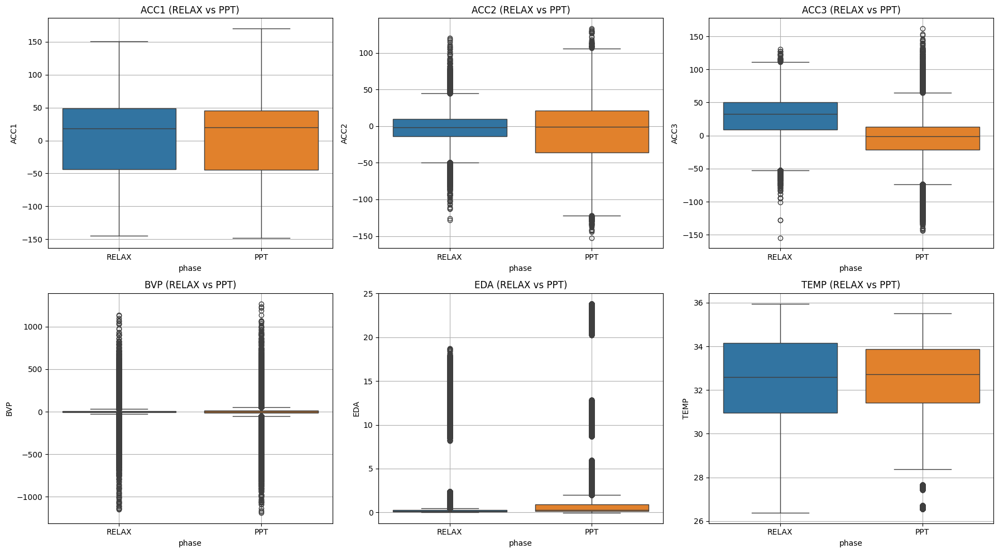

In [ ]:
plot_boxplots_relax_vs_ppt(df_all)

In [ ]:
from scipy.stats import ttest_ind

def test_statistical_difference(df):
    results = []
    numeric_cols = df.select_dtypes(include='number').columns
    signal_cols = [col for col in numeric_cols if col not in ['label']]

    for signal in signal_cols:
        relax = df[df['phase'] == 'RELAX'][signal].dropna()
        ppt = df[df['phase'] == 'PPT'][signal].dropna()

        if len(relax) > 1 and len(ppt) > 1:
            stat, p = ttest_ind(relax, ppt, equal_var=False)
            results.append({
                'Signal': signal,
                'p-value': round(p, 5),
                'Significant': p < 0.05
            })

    return pd.DataFrame(results)

In [ ]:
ttest_results = test_statistical_difference(df_all)
display(ttest_results)

,Signal,p-value,Significant
0,ACC1,0.00000,True
1,ACC2,0.00000,True
2,ACC3,0.00000,True
3,BVP,0.89012,False
4,EDA,0.00000,True
5,TEMP,0.00047,True


In [ ]:
# Calcola le lunghezze dei segnali nella fase PPT per ogni soggetto e sessione
ppt_lengths = (
    df_all[df_all['phase'] == 'PPT']
    .groupby(['subject', 'session'])
    .size()
    .to_dict()
)

In [ ]:
def upsample_fused_column_to_length(fused_values, target_length):
    """
    Esegue il resampling della colonna Fused a una lunghezza target specifica
    utilizzando scipy.signal.resample.
    """
    fused_resampled = resample(fused_values, target_length)
    return fused_resampled


def create_fused_dataset(base_dir, complete_subjects_map, ppt_lengths):
    all_data = []

    for subject, valid_tests in complete_subjects_map.items():
        subject_data = []

        # --- Fasi PRE e POST ---
        for phase in ["PRE", "POST"]:
            anno_path = os.path.join(base_dir, phase, "Annotation", f"{phase}_{subject}_annotation.csv")
            if os.path.exists(anno_path):
                df = pd.read_csv(anno_path)
                if 'Fused' in df.columns:
                    key = (subject, phase)
                    if key in ppt_lengths:
                        target_len = ppt_lengths[key]
                        upsampled = upsample_fused_column_to_length(df['Fused'].values, target_len)
                        df_upsampled = pd.DataFrame({
                            "Fused_score": upsampled,
                            "subject": subject,
                            "session": phase
                        })
                        subject_data.append(df_upsampled)
                    else:
                        print(f"[WARN] Lunghezza non trovata per {key}, saltato.")
                else:
                    print(f"[WARN] Colonna 'Fused' non trovata in {anno_path}")
            else:
                print(f"[WARN] File non trovato: {anno_path}")

        # --- Fase TEST ---
        for test in valid_tests:
            anno_path = os.path.join(base_dir, "TEST", test, "Annotation", f"{test}_{subject}_annotation.csv")
            if os.path.exists(anno_path):
                df = pd.read_csv(anno_path)
                if 'Fused' in df.columns:
                    key = (subject, test)
                    if key in ppt_lengths:
                        target_len = ppt_lengths[key]
                        upsampled = upsample_fused_column_to_length(df['Fused'].values, target_len)
                        df_upsampled = pd.DataFrame({
                            "Fused_score": upsampled,
                            "subject": subject,
                            "session": test
                        })
                        subject_data.append(df_upsampled)
                    else:
                        print(f"[WARN] Lunghezza non trovata per {key}, saltato.")
                else:
                    print(f"[WARN] Colonna 'Fused' non trovata in {anno_path}")
            else:
                print(f"[WARN] File non trovato: {anno_path}")

        # --- Aggregazione per soggetto ---
        if subject_data:
            all_data.append(pd.concat(subject_data, ignore_index=True))

    # --- Dataset finale ---
    if all_data:
        return pd.concat(all_data, ignore_index=True)
    else:
        print("Nessun dato disponibile.")
        return pd.DataFrame()

In [ ]:
complete_subjects_map = {
    "P005": ["TEST01", "TEST05"],
    "P008": ["TEST01", "TEST05"],
    "P023": ["TEST01", "TEST05"],
    "P032": ["TEST01", "TEST05"],
    "P035": ["TEST01", "TEST05"],
    "P037": ["TEST01", "TEST05"],
    "P038": ["TEST01"],
    "P041": ["TEST01", "TEST05"],
    "P043": ["TEST01"],
    "P044": ["TEST01", "TEST05"],
    "P046": ["TEST01"],
    "P047": ["TEST01", "TEST05"],
    "P049": ["TEST01"],
    "P058": ["TEST01"],
    "P062": ["TEST01", "TEST05"],
    "P065": ["TEST01", "TEST05"],
    "P071": ["TEST01", "TEST05"]
}

base_dir = "/content/drive/MyDrive/VerBIO_Public"

subjects_annotation = create_fused_dataset(base_dir, complete_subjects_map, ppt_lengths)

In [ ]:
subjects_annotation.head()

,Fused_score,subject,session
0,0.005876,P005,PRE
1,0.001657,P005,PRE
2,-0.002391,P005,PRE
3,-0.006267,P005,PRE
4,-0.009969,P005,PRE


In [ ]:
subjects_annotation.groupby(['subject', 'session']).size()

subject  session
P005     POST       16850
         PRE        11271
         TEST01     13275
         TEST05     10887
P008     POST       15789
                    ...  
P065     TEST05     14294
P071     POST       15841
         PRE        17998
         TEST01     14709
         TEST05      9709
Length: 63, dtype: int64

In [ ]:
df_all[df_all['phase'] == 'PPT'].groupby(['subject', 'session']).size()

subject  session
P005     POST       16850
         PRE        11271
         TEST01     13275
         TEST05     10887
P008     POST       15789
                    ...  
P065     TEST05     14294
P071     POST       15841
         PRE        17998
         TEST01     14709
         TEST05      9709
Length: 63, dtype: int64

In [ ]:
def label_dataset(df_signals, df_annotations, threshold=0.2):
    """
    Etichetta il dataset dei segnali:
    - label = 0 per tutti i record nella fase RELAX
    - label = 1 per i valori in fase PPT dove il Fused_score > threshold
      altrimenti 0.
    """
    # Inizializza colonna label con zeri
    df_signals['label'] = 0

    # Trova tutte le righe in fase PPT
    mask_ppt = df_signals['phase'] == 'PPT'
    df_ppt = df_signals[mask_ppt]

    # Etichettatura per soggetto e session
    for (subject, session), group in df_ppt.groupby(['subject', 'session']):
        # Estrai fused score allineato
        fused_values = df_annotations[
            (df_annotations['subject'] == subject) &
            (df_annotations['session'] == session)
        ]['Fused_score'].values

        # Protezione contro mismatch
        signal_idx = df_signals[
            (df_signals['subject'] == subject) &
            (df_signals['session'] == session) &
            (df_signals['phase'] == 'PPT')
        ].index

        if len(signal_idx) == len(fused_values):
            df_signals.loc[signal_idx, 'label'] = (fused_values > threshold).astype(int)
        else:
            print(f"[WARN] Mismatch di lunghezza per {subject} - {session}: "
                  f"{len(signal_idx)} vs {len(fused_values)}")

    return df_signals

In [ ]:
df = label_dataset(df_all, subjects_annotation)

In [ ]:
df.head()

,ACC1,ACC2,ACC3,BVP,EDA,TEMP,subject,session,phase,label
0,12.000000,13.000000,60.000000,-8.26,0.133470,32.050000,P005,PRE,RELAX,0
1,5.769194,15.372568,68.929877,-10.13,0.130896,32.054514,P005,PRE,RELAX,0
2,14.000000,13.000000,61.000000,-12.01,0.128816,32.058249,P005,PRE,RELAX,0
3,18.849692,12.256620,55.569971,-13.52,0.127238,32.061199,P005,PRE,RELAX,0
4,15.000000,14.000000,61.000000,-14.26,0.126157,32.063375,P005,PRE,RELAX,0


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2159612 entries, 0 to 2159611
Data columns (total 10 columns):
 #   Column   Dtype  
---  ------   -----  
 0   ACC1     float64
 1   ACC2     float64
 2   ACC3     float64
 3   BVP      float64
 4   EDA      float64
 5   TEMP     float64
 6   subject  object 
 7   session  object 
 8   phase    object 
 9   label    int64  
dtypes: float64(6), int64(1), object(3)
memory usage: 164.8+ MB


In [ ]:
df.describe()

,ACC1,ACC2,ACC3,BVP,EDA,TEMP,label
count,2.159612e+06,2.159612e+06,2.159612e+06,2.159612e+06,2.159612e+06,2.159612e+06,2.159612e+06
mean,5.537891e+00,-2.094674e+00,1.285213e+01,-1.148349e-02,7.125680e-01,3.245926e+01,3.151126e-01
std,4.564637e+01,2.981659e+01,3.148243e+01,5.105985e+01,2.126496e+00,2.010616e+00,4.645608e-01
min,-1.476892e+02,-1.522740e+02,-1.544291e+02,-1.187200e+03,-3.896454e-02,2.637496e+01,0.000000e+00
25%,-4.400000e+01,-1.798167e+01,-9.000000e+00,-8.340000e+00,1.041351e-01,3.121319e+01,0.000000e+00
50%,1.824339e+01,-1.898498e+00,1.227897e+01,3.600000e-01,2.151499e-01,3.267925e+01,0.000000e+00
75%,4.737183e+01,1.494794e+01,3.798685e+01,9.800000e+00,4.571115e-01,3.409125e+01,1.000000e+00
max,1.701855e+02,1.331136e+02,1.618245e+02,1.269400e+03,2.384075e+01,3.595930e+01,1.000000e+00


In [ ]:
df.isna().sum()

,0
ACC1,0
ACC2,0
ACC3,0
BVP,0
EDA,0
TEMP,0
subject,0
session,0
phase,0
label,0


LABEL DISTRIBUTION ANALYSIS

In [ ]:
freq_absolute_global = df["label"].value_counts()
freq_relative_global = df["label"].value_counts(normalize=True)

global_distribution = pd.DataFrame({
    'Frequenza Assoluta': freq_absolute_global,
    'Frequenza Relativa (%)': (freq_relative_global * 100).round(2)
})

global_distribution

,Frequenza Assoluta,Frequenza Relativa (%)
label,,
0,1479091,68.49
1,680521,31.51


In [ ]:
ppt_df = df[df['phase'] == 'PPT']

phase_distribution = ppt_df.groupby(['session', 'label']).size().unstack(fill_value=0)

phase_distribution['Totale'] = phase_distribution.sum(axis=1)
phase_distribution['% Label 0'] = ((phase_distribution[0] / phase_distribution['Totale']) * 100).round(2)
phase_distribution['% Label 1'] = ((phase_distribution[1] / phase_distribution['Totale']) * 100).round(2)

phase_distribution = phase_distribution[['Totale', 0, 1, '% Label 0', '% Label 1']]
phase_distribution.columns = ['Totale', 'Label 0', 'Label 1', 'Label 0 (%)', 'Label 1 (%)']

phase_distribution

,Totale,Label 0,Label 1,Label 0 (%),Label 1 (%)
session,,,,,
POST,280734,103500,177234,36.87,63.13
PRE,279194,83905,195289,30.05,69.95
TEST01,273701,65028,208673,23.76,76.24
TEST05,151711,52386,99325,34.53,65.47


GRAPHICAL ANALYSIS (RAW SIGNALS)

In [ ]:
def plot_segnali_fasi_e_label(df, segnali=None, n_points=None):
    import matplotlib.pyplot as plt

    if segnali is None:
        segnali = ['ACC1', 'ACC2', 'ACC3', 'BVP', 'EDA', 'TEMP']

    soggetti = df['subject'].unique()

    for soggetto in soggetti:
        df_soggetto = df[df['subject'] == soggetto]
        print(f"\nSoggetto: {soggetto}")

        for segnale in segnali:
            fig, ax = plt.subplots(figsize=(16, 3))
            offset = 0

            # RELAX - solo baseline (label 0)
            relax_baseline = df_soggetto[(df_soggetto['phase'] == 'RELAX') & (df_soggetto['label'] == 0)][segnale].values
            if n_points is not None:
                relax_baseline = relax_baseline[:n_points]
            if len(relax_baseline) > 0:
                ax.plot(range(offset, offset + len(relax_baseline)), relax_baseline,
                        label='RELAX - Baseline', color='green', linewidth=0.8)
                offset += len(relax_baseline)

            # PPT - baseline (label 0)
            ppt_baseline = df_soggetto[(df_soggetto['phase'] == 'PPT') & (df_soggetto['label'] == 0)][segnale].values
            if n_points is not None:
                ppt_baseline = ppt_baseline[:n_points]
            if len(ppt_baseline) > 0:
                ax.plot(range(offset, offset + len(ppt_baseline)), ppt_baseline,
                        label='PPT - Baseline', color='orange', linewidth=0.8)
                offset += len(ppt_baseline)

            # PPT - stress (label 1)
            ppt_stress = df_soggetto[(df_soggetto['phase'] == 'PPT') & (df_soggetto['label'] == 1)][segnale].values
            if n_points is not None:
                ppt_stress = ppt_stress[:n_points]
            if len(ppt_stress) > 0:
                ax.plot(range(offset, offset + len(ppt_stress)), ppt_stress,
                        label='PPT - Stress', color='red', linewidth=0.8)
                offset += len(ppt_stress)

            ax.set_title(f"Soggetto: {soggetto} - Segnale: {segnale.upper()}", fontsize=14)
            ax.set_xlabel("Campioni")
            ax.set_ylabel("Ampiezza")
            ax.legend()
            ax.grid(True)
            plt.tight_layout()
            plt.show()


Soggetto: P005


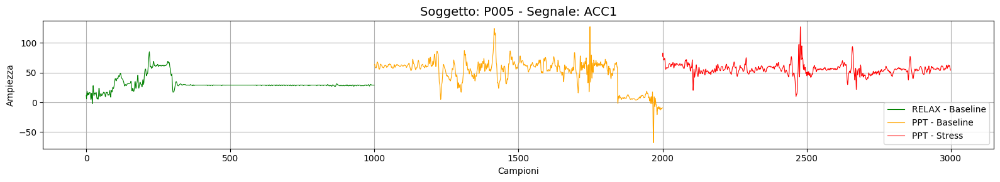

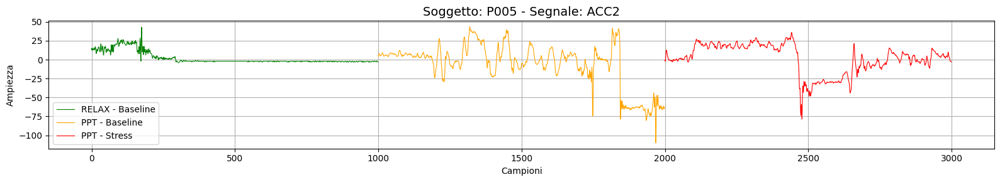

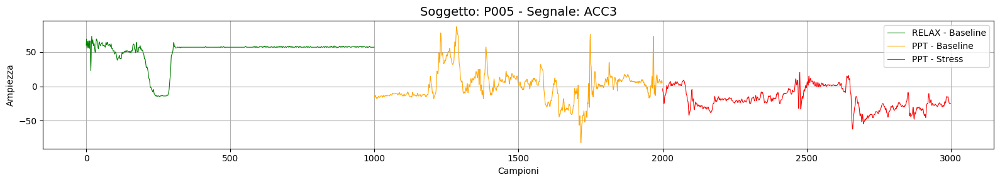

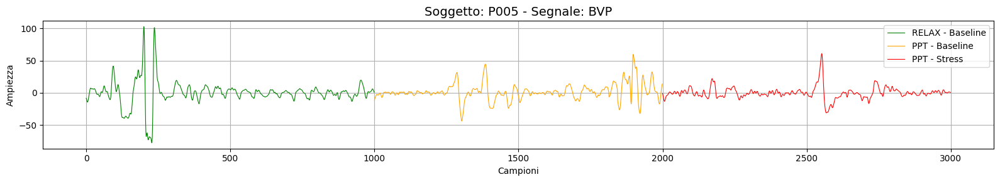

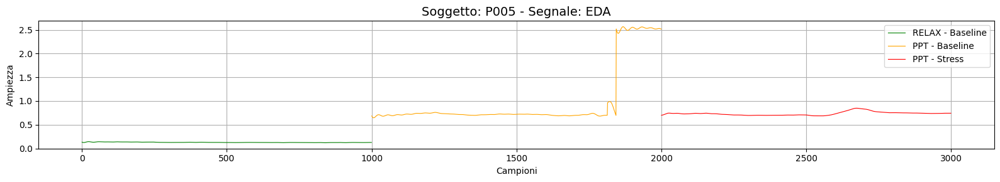

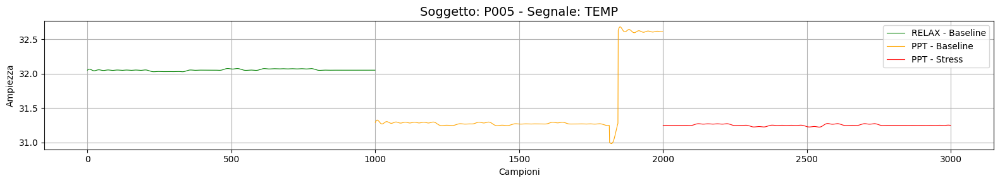


Soggetto: P008


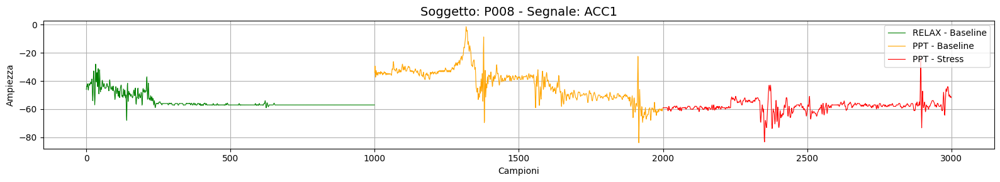

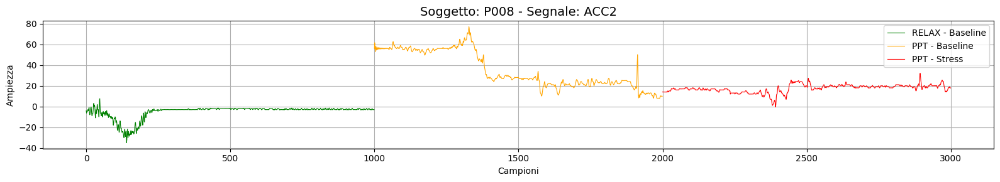

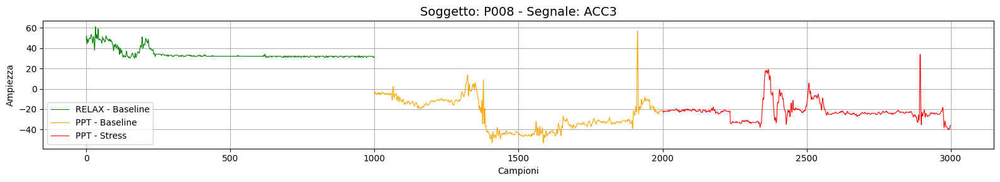

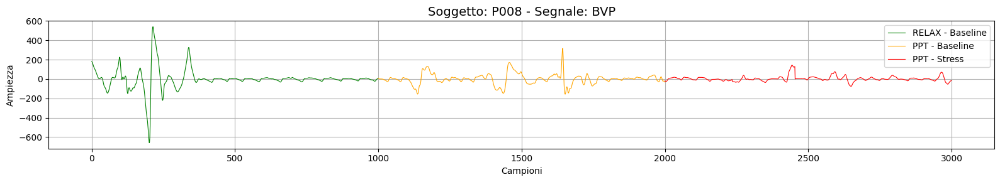

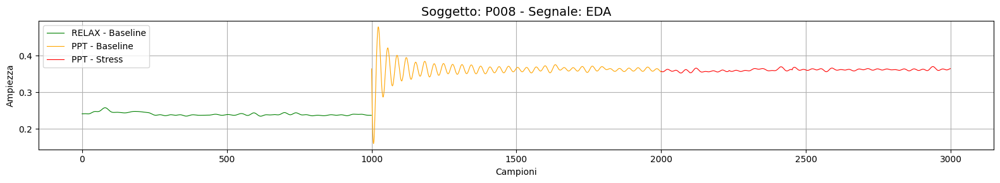

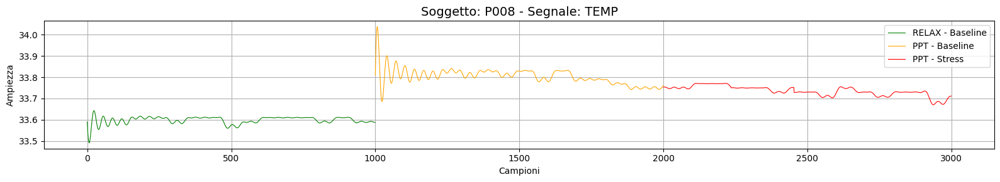


Soggetto: P023


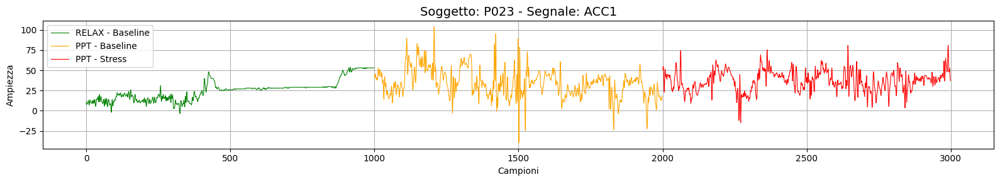

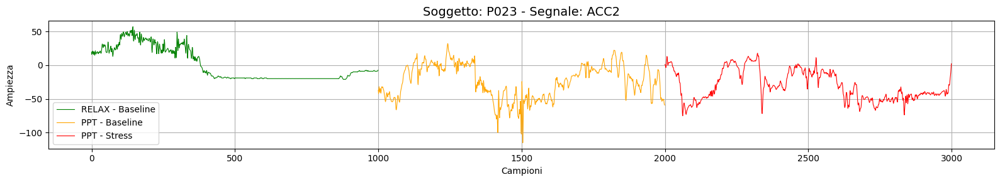

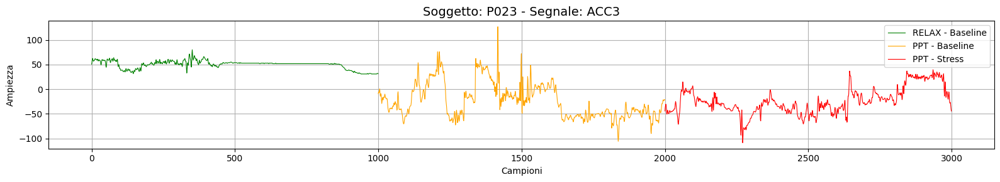

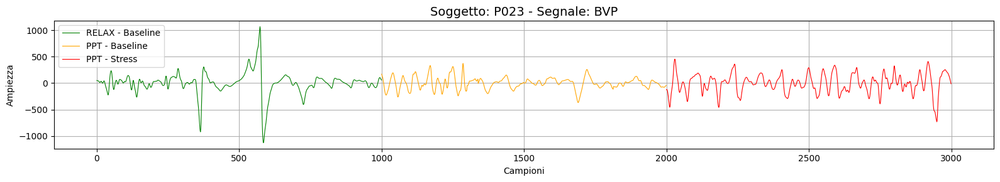

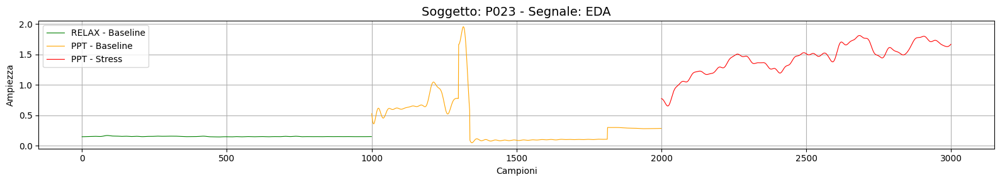

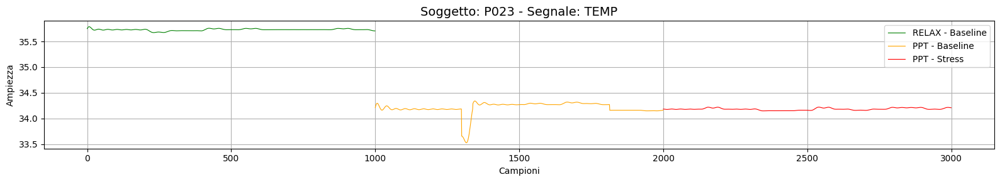


Soggetto: P032


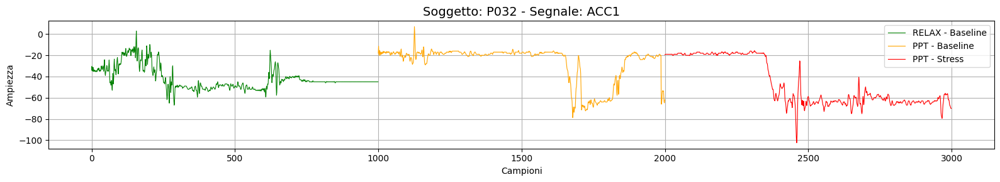

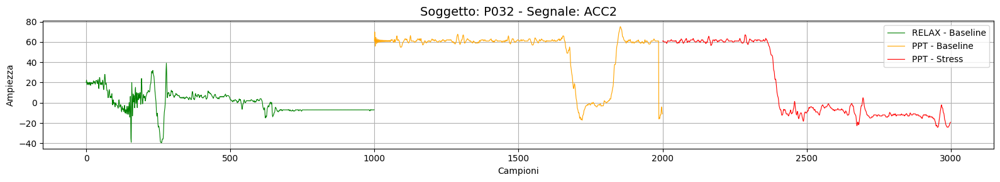

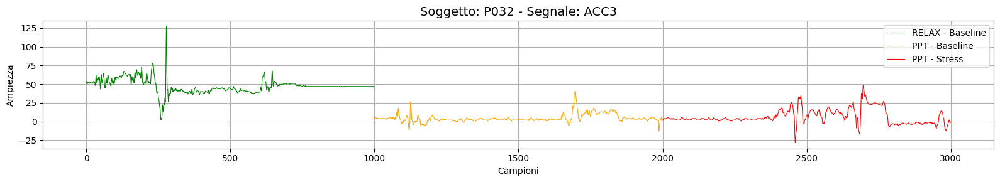

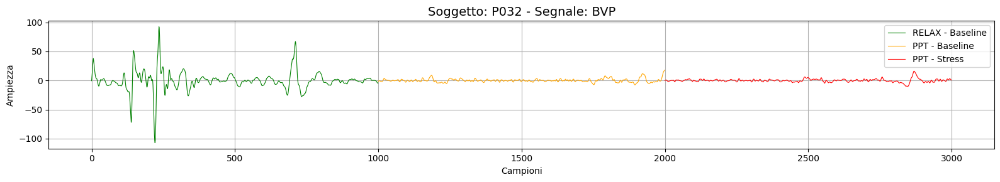

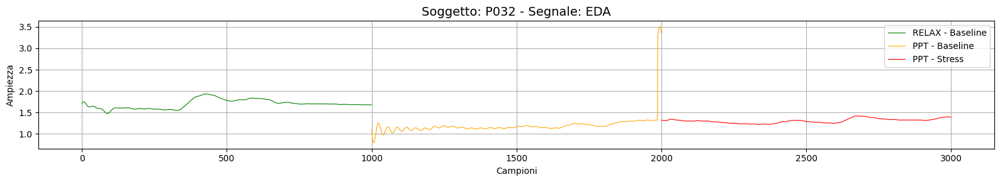

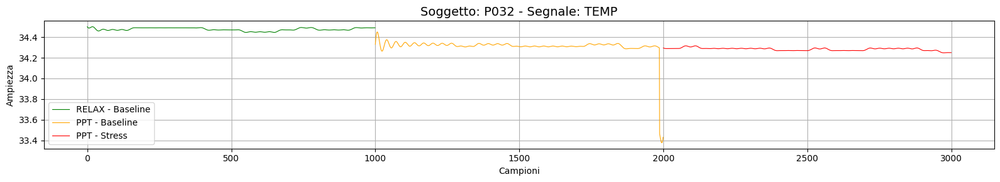


Soggetto: P035


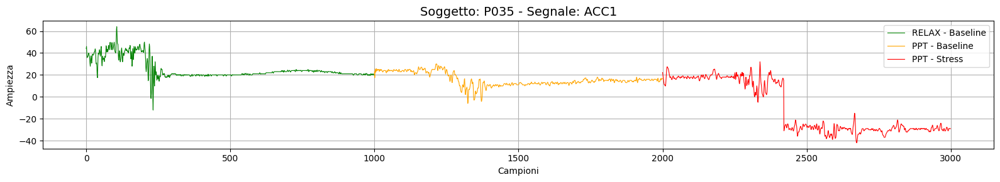

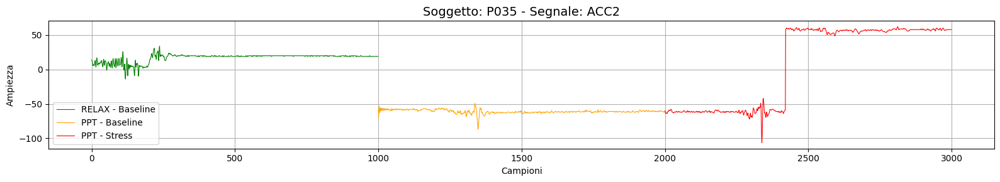

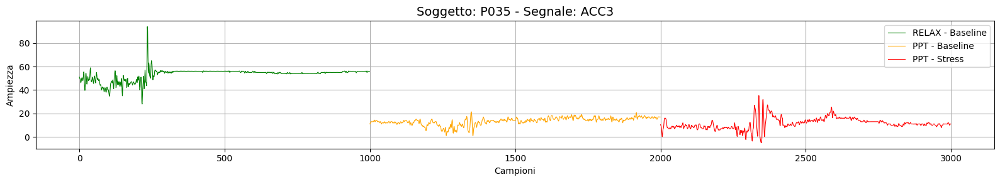

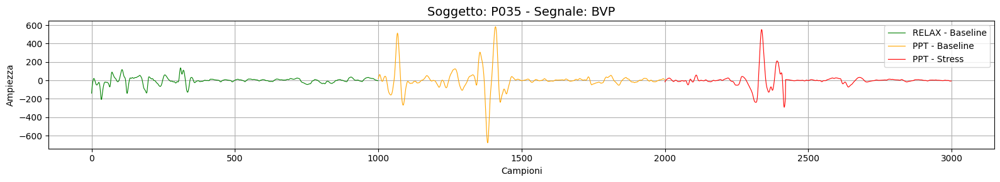

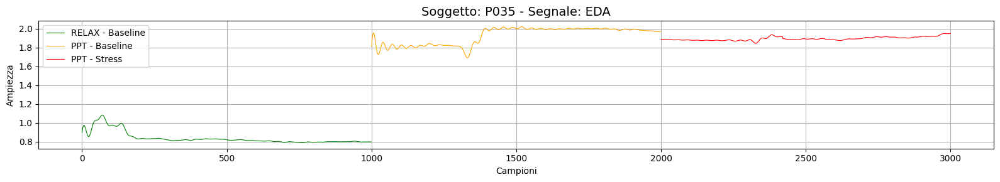

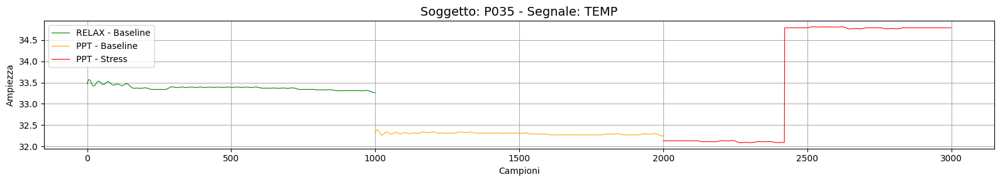


Soggetto: P037


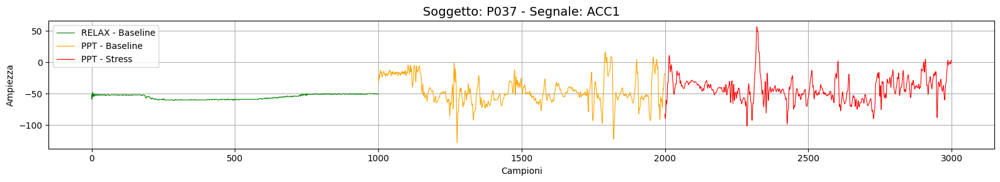

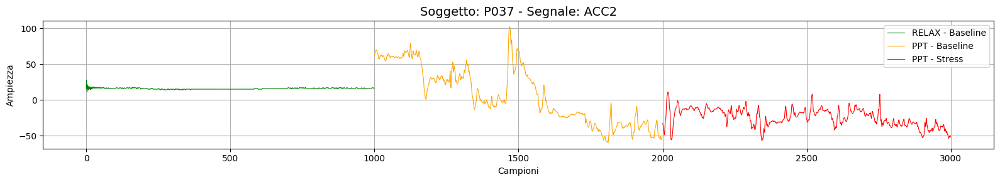

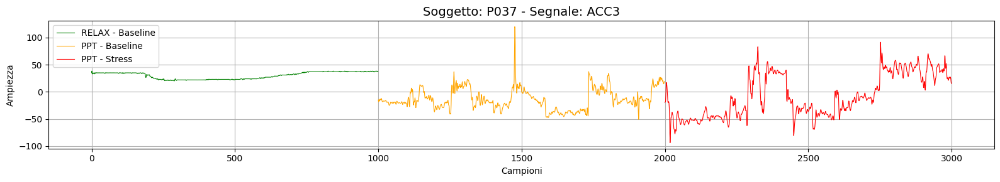

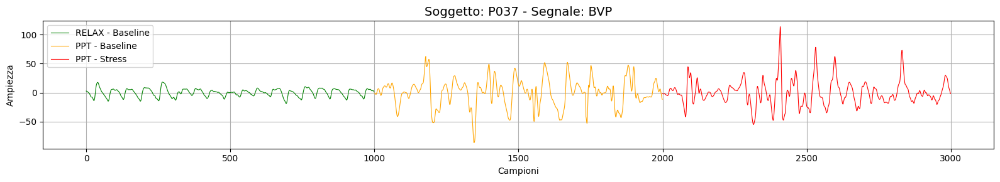

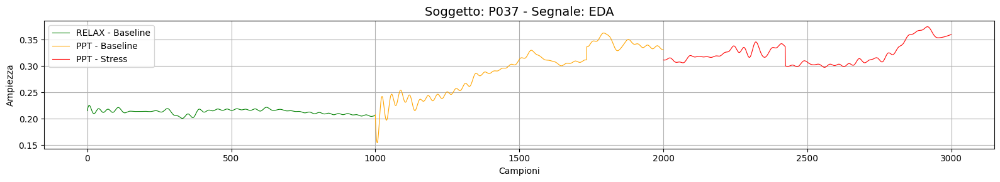

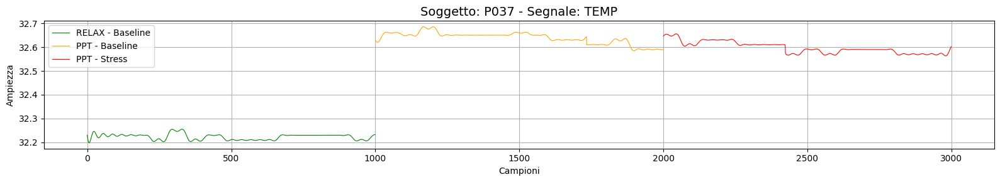


Soggetto: P038


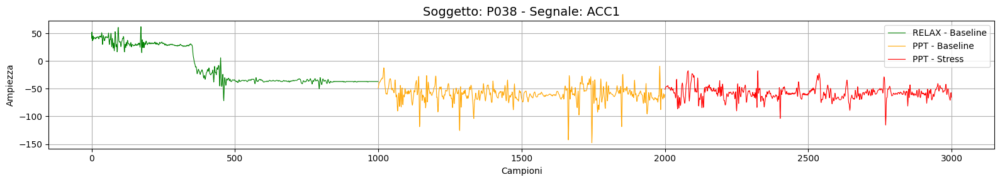

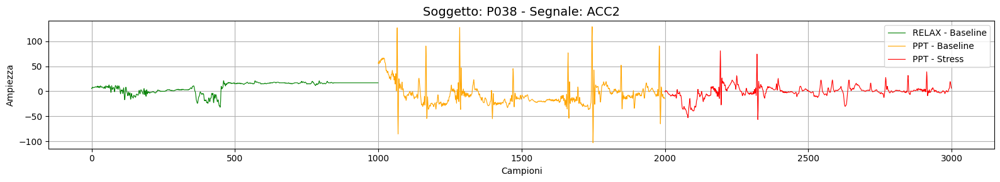

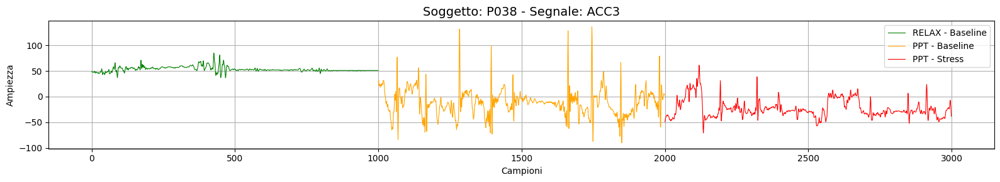

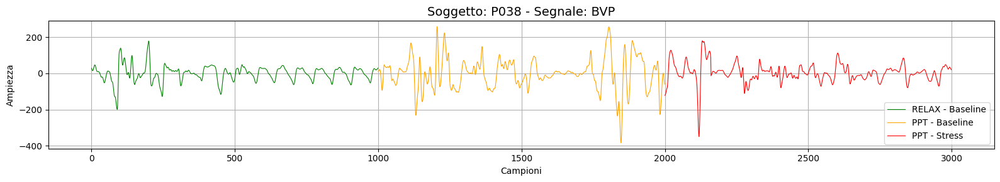

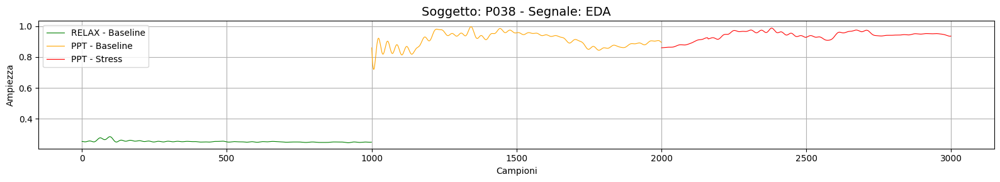

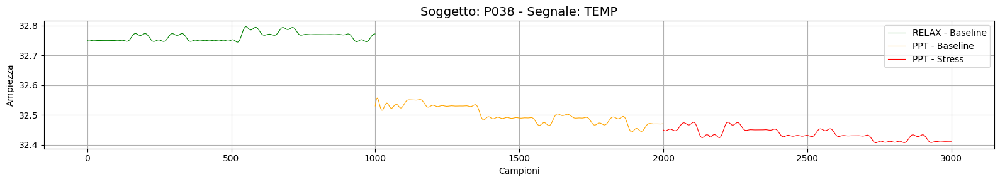


Soggetto: P041


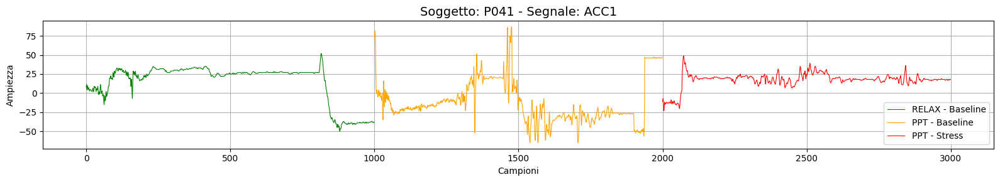

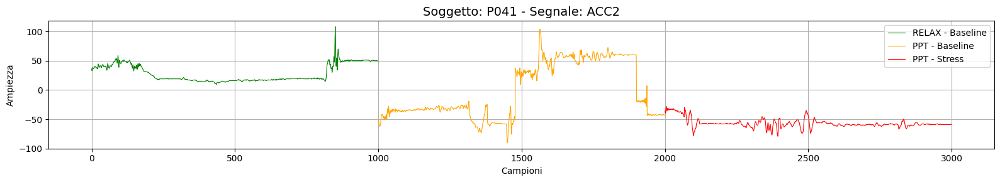

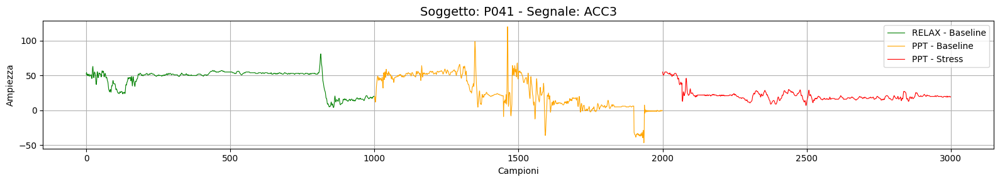

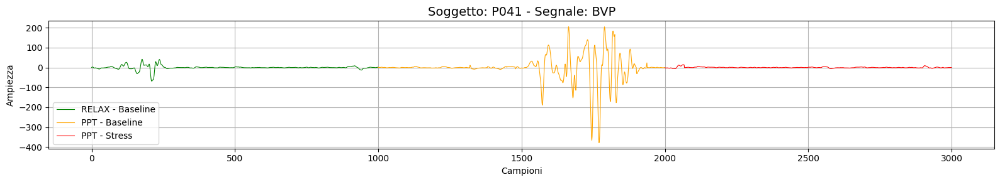

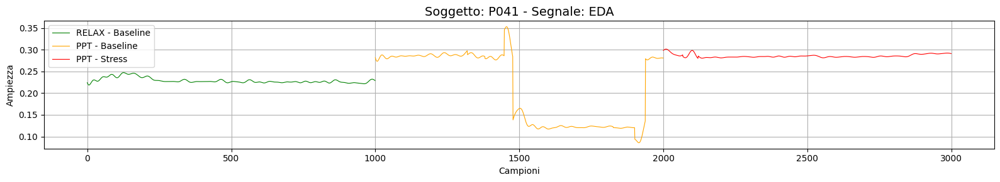

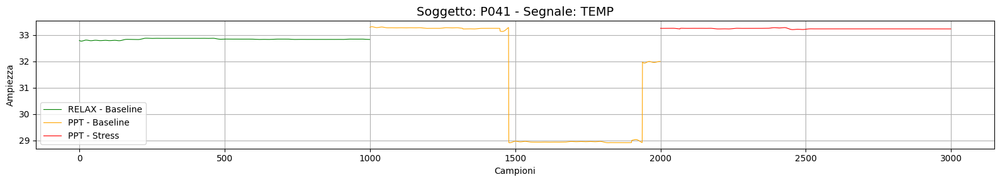


Soggetto: P043


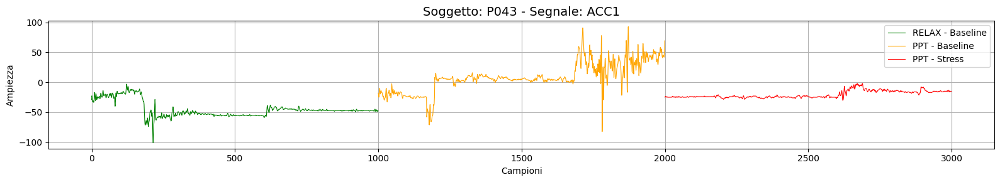

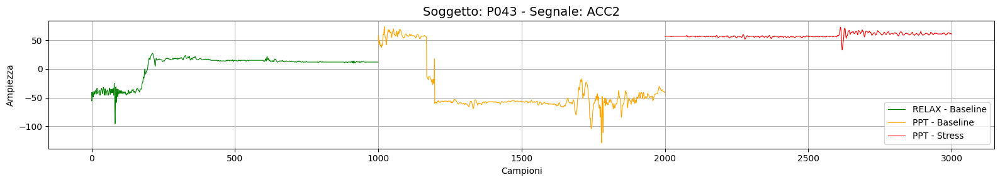

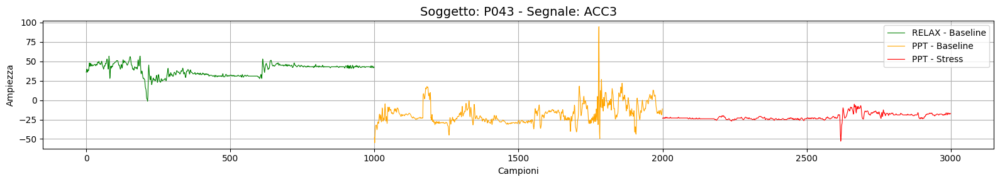

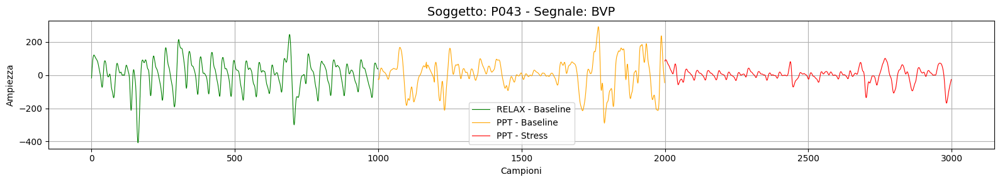

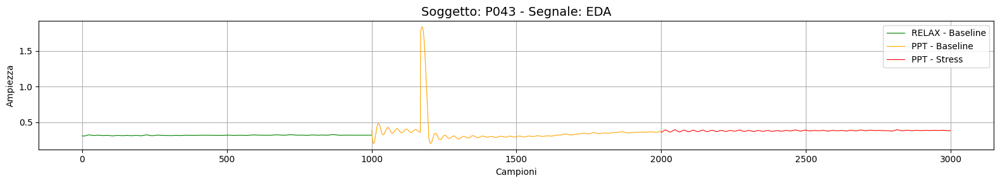

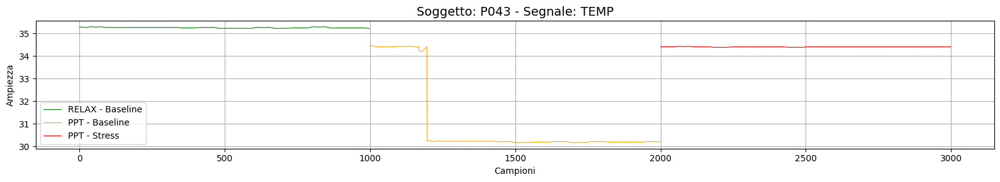


Soggetto: P044


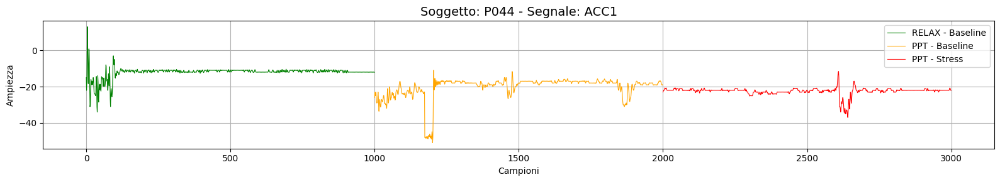

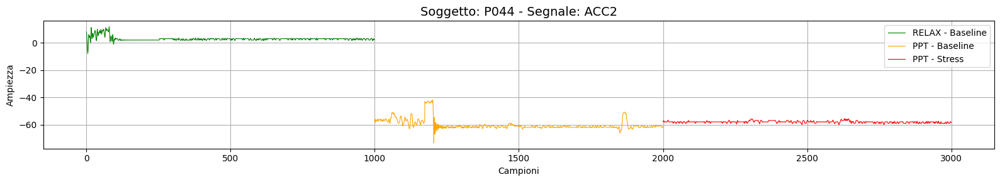

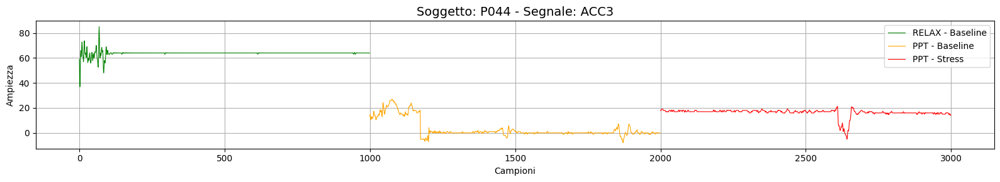

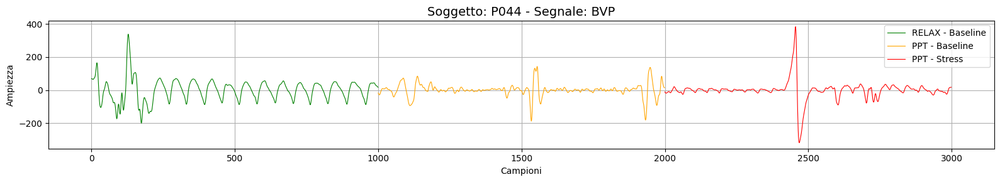

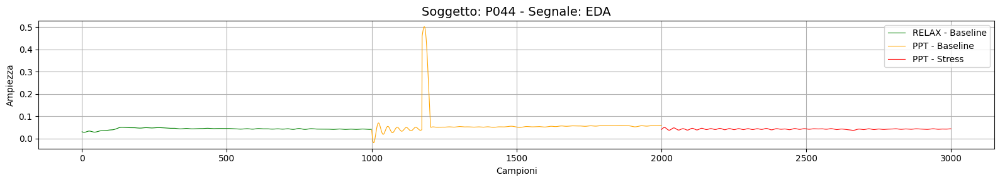

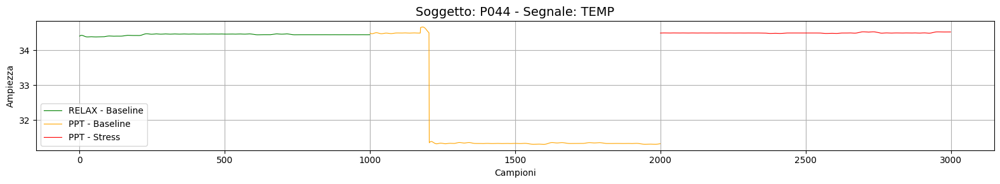


Soggetto: P046


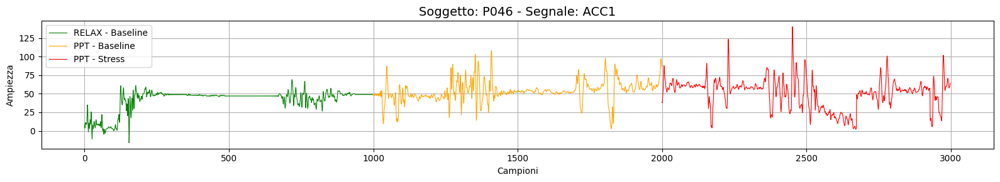

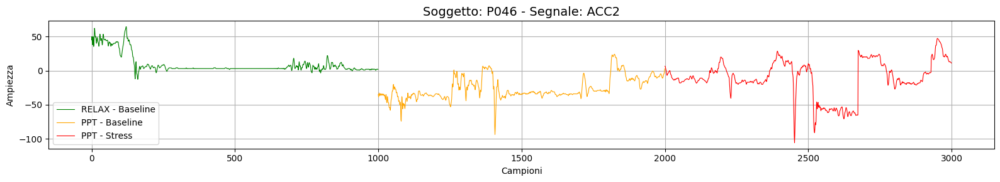

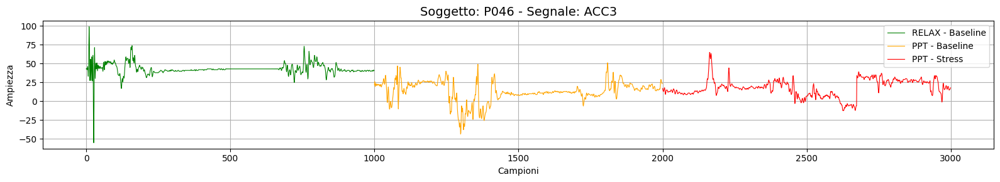

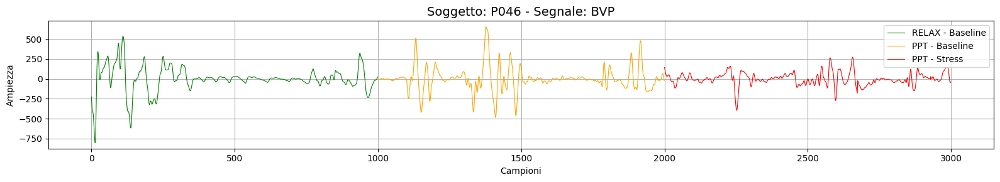

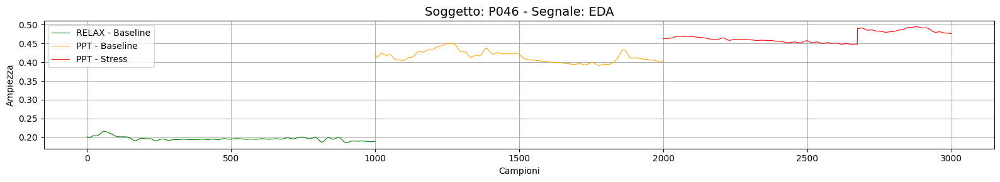

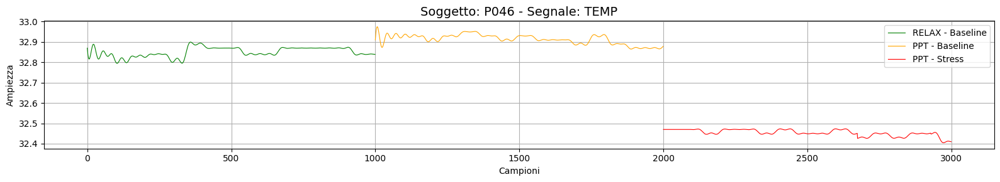


Soggetto: P047


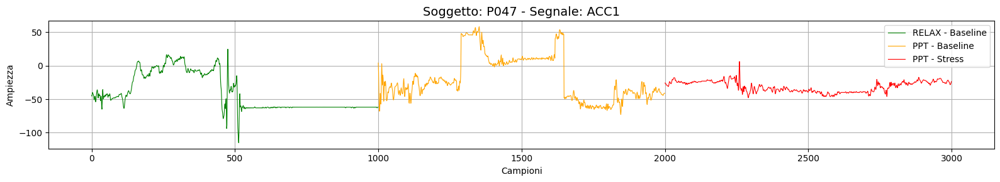

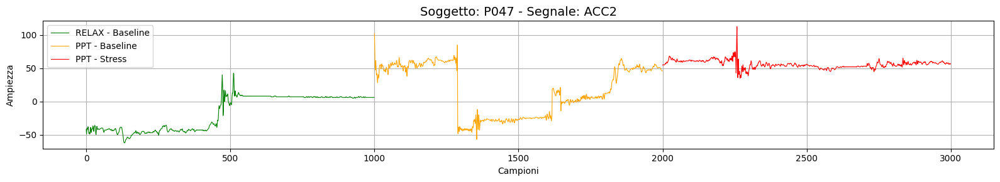

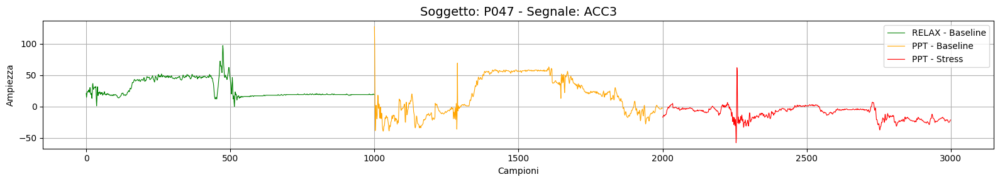

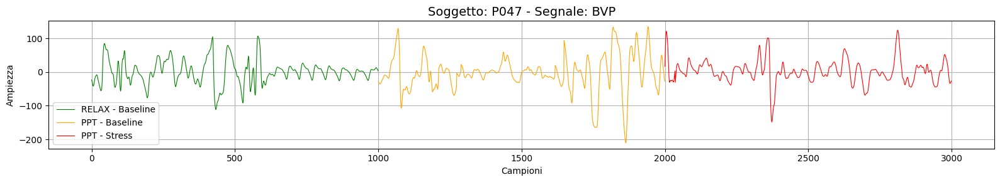

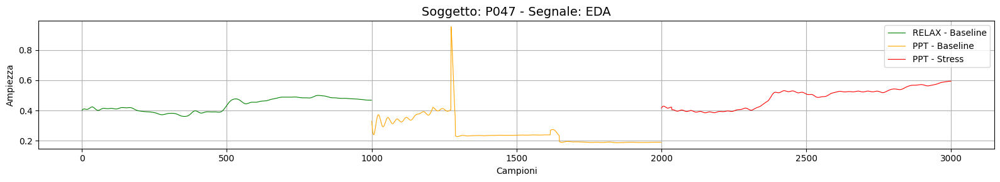

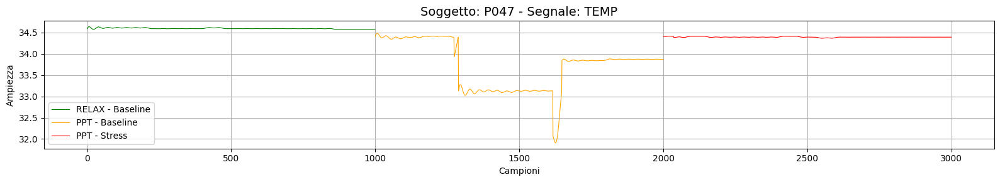


Soggetto: P049


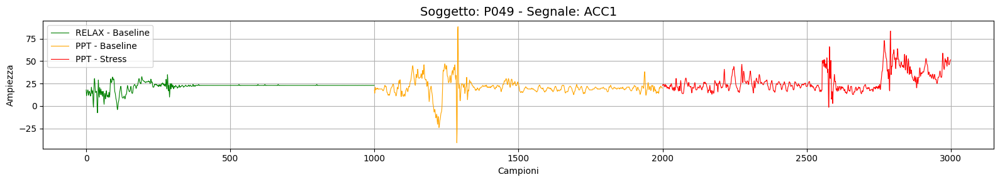

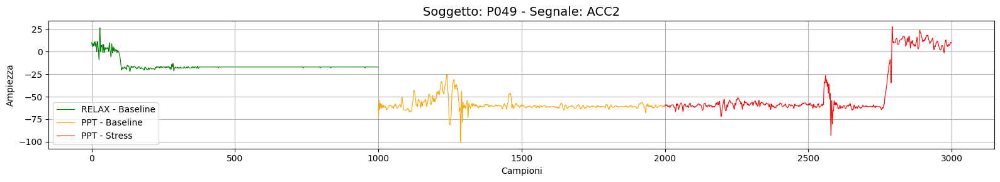

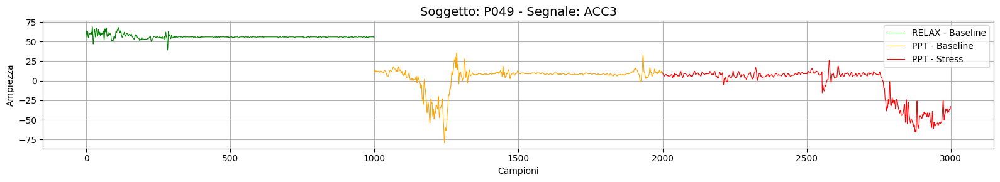

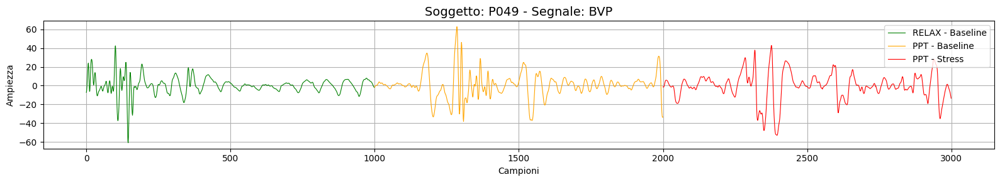

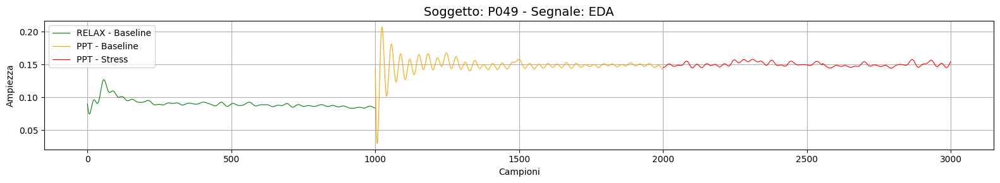

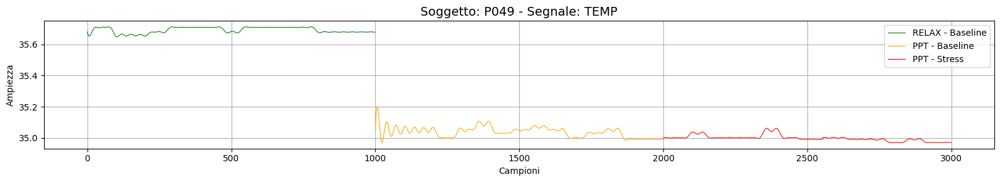


Soggetto: P058


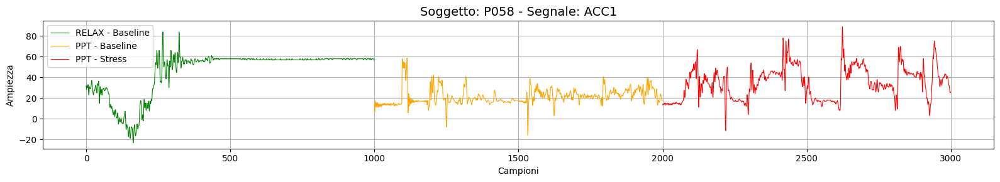

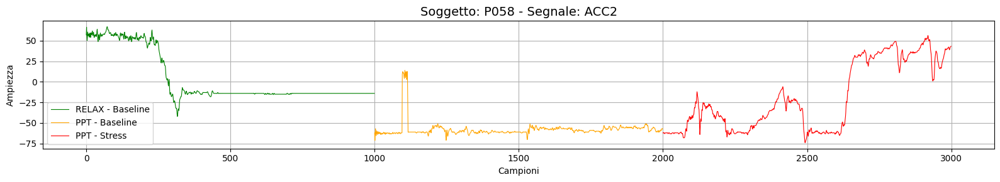

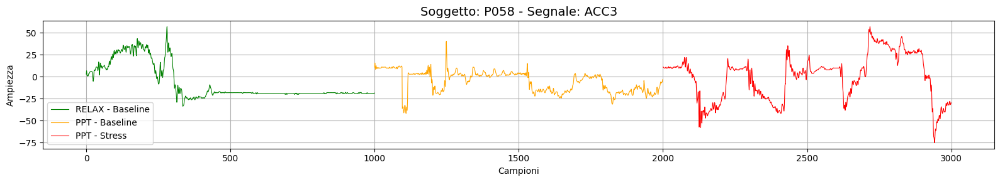

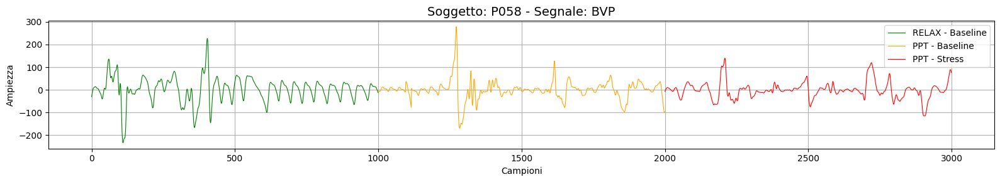

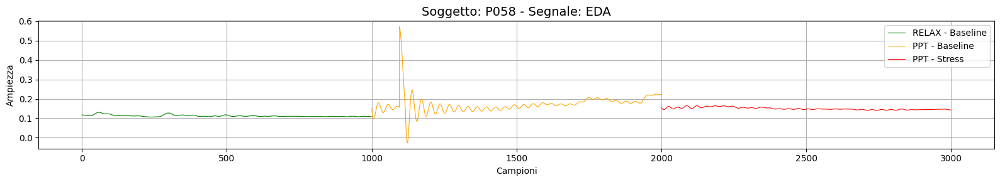

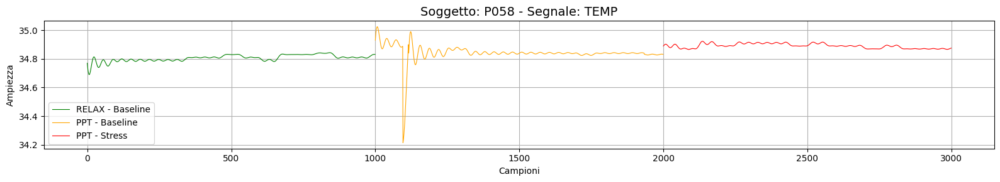


Soggetto: P062


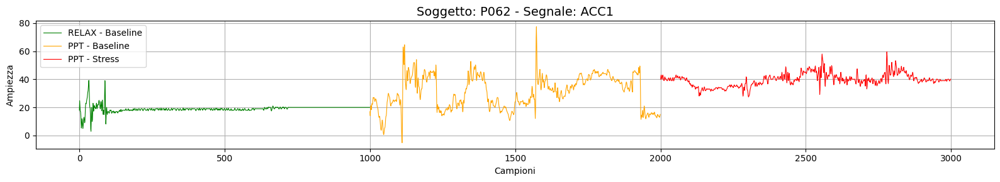

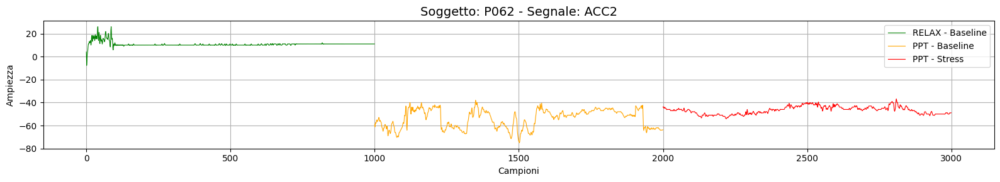

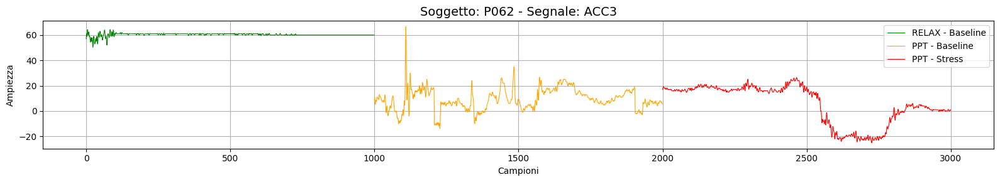

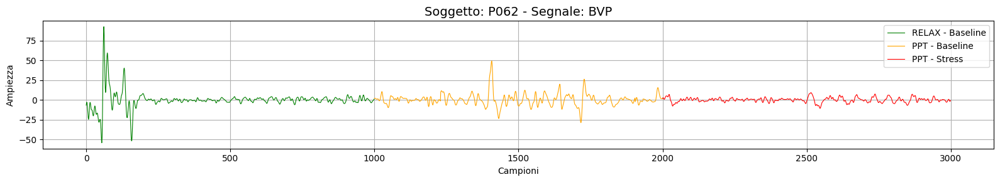

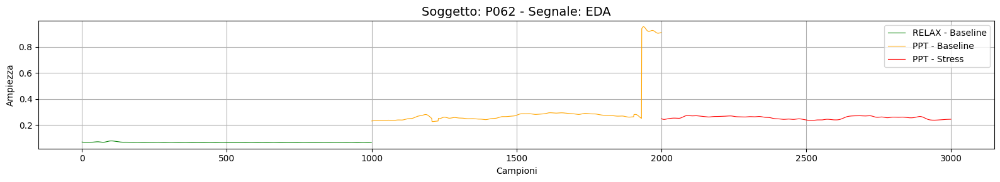

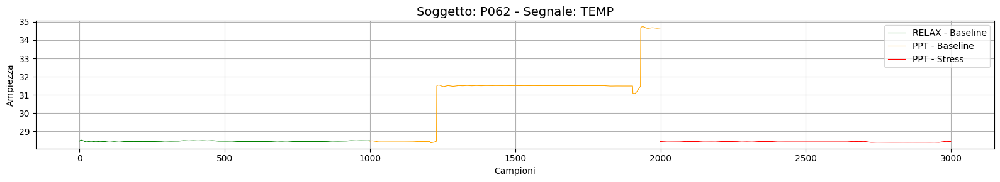


Soggetto: P065


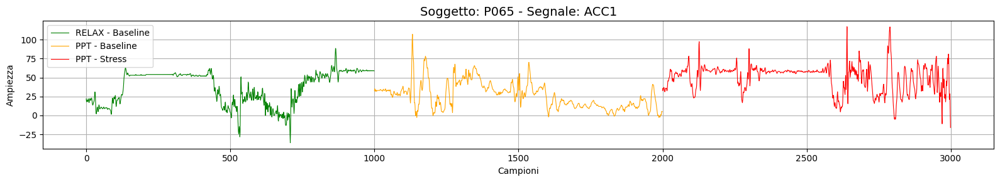

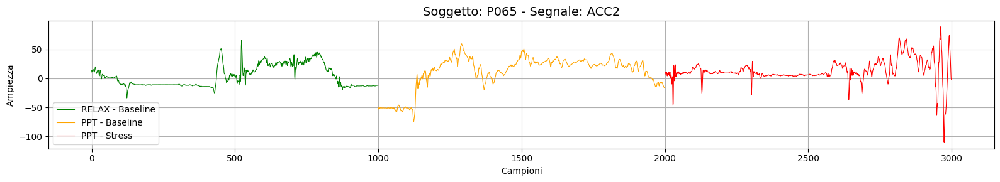

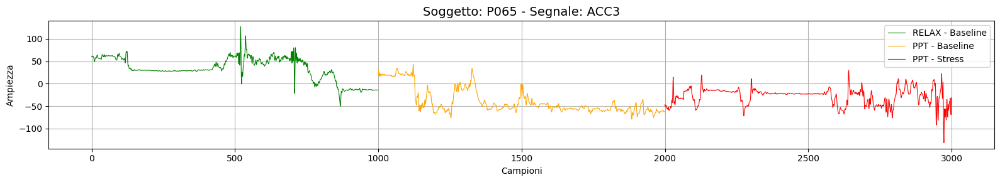

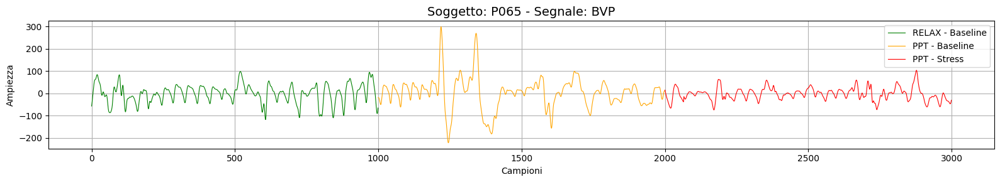

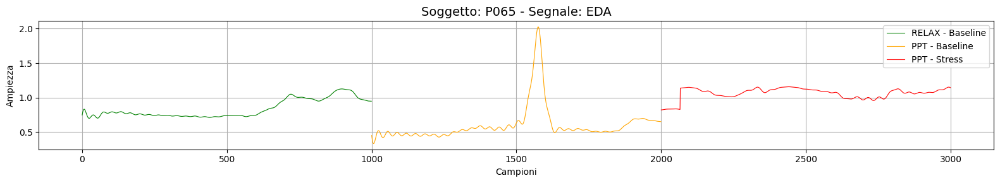

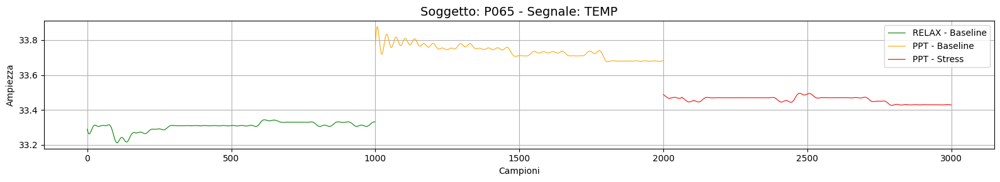


Soggetto: P071


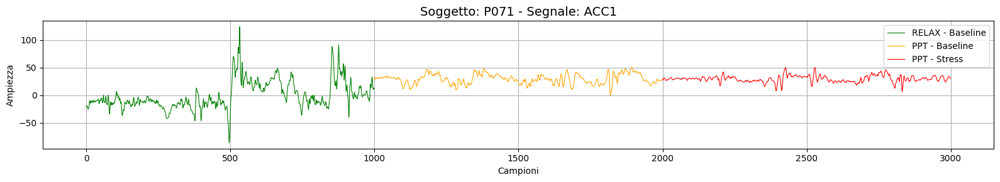

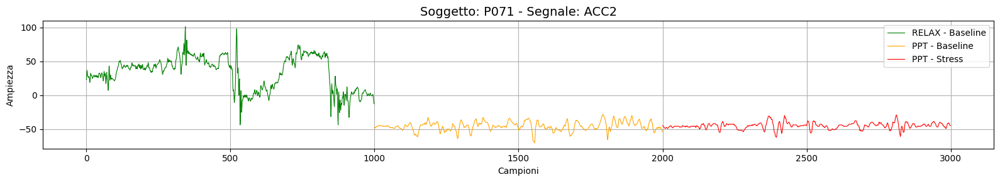

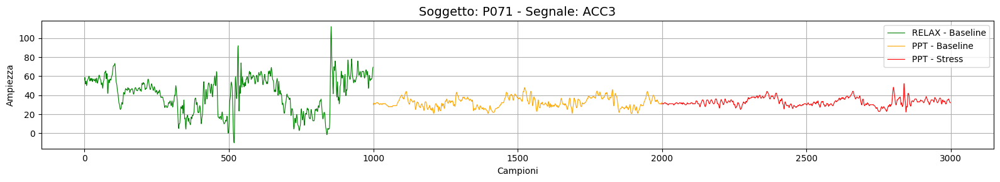

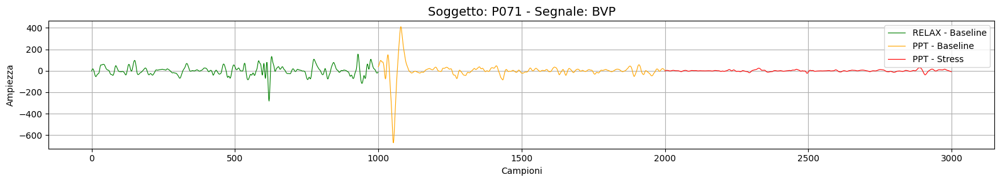

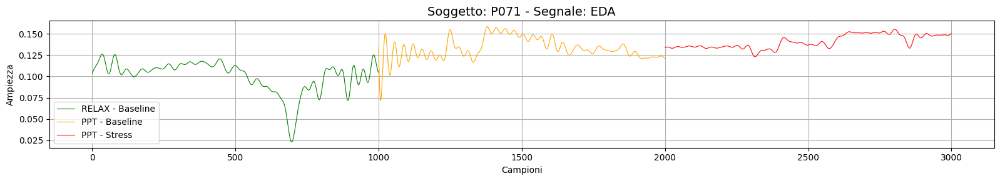

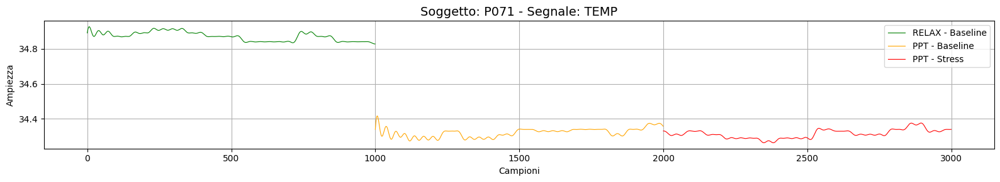

In [ ]:
plot_segnali_fasi_e_label(df, n_points=1000)

In [ ]:
# Raggruppa per soggetto e label nella fase PPT
etichetta_ppt = df[df['phase'] == 'PPT'].groupby(['subject', 'label']).size().unstack(fill_value=0)

# Rinomina le colonne per chiarezza
etichetta_ppt.columns = ['Label 0 (Baseline)', 'Label 1 (Stress)']

# Aggiungi anche una colonna con il totale
etichetta_ppt['Totale'] = etichetta_ppt.sum(axis=1)

# Ordina per soggetti con più label 1 (stress)
etichetta_ppt = etichetta_ppt.sort_values(by='Label 1 (Stress)', ascending=False)

pd.set_option('display.max_rows', None)  # opzionale: mostra tutti i soggetti
etichetta_ppt

,Label 0 (Baseline),Label 1 (Stress),Totale
subject,,,
P047,1451,68613,70064
P032,3025,64488,67513
P041,2070,54518,56588
P071,4869,53388,58257
P062,2399,53219,55618
P058,2549,52197,54746
P043,3080,48661,51741
P023,11647,46430,58077
P005,6765,45518,52283


In [ ]:
def analizza_variabilita_stress(df, segnali=None):
    if segnali is None:
        segnali = ['ACC1', 'ACC2', 'ACC3', 'BVP', 'EDA', 'TEMP']

    soggetti = df['subject'].unique()

    for soggetto in soggetti:
        df_stress = df[(df['subject'] == soggetto) &
                       (df['phase'] == 'PPT') &
                       (df['label'] == 1)]

        if df_stress.empty:
            print(f"\n⚠️ Nessuna condizione di stress per il soggetto {soggetto}")
            continue

        print(f"\n📊 Statistiche soggetto {soggetto} (condizione PPT - Stress):")
        stats = df_stress[segnali].describe().T[['mean', 'std', 'min', '50%', 'max']]
        stats.columns = ['Media', 'Deviazione Std', 'Min', 'Mediana', 'Max']
        print(stats.round(3))

        # Istogramma + curva di densità
        for segnale in segnali:
            plt.figure(figsize=(7, 3))
            sns.histplot(df_stress[segnale], kde=True, color='red', bins=50)
            plt.title(f"Soggetto {soggetto} - {segnale.upper()} (PPT - Stress)")
            plt.xlabel("Valore")
            plt.ylabel("Frequenza")
            plt.grid(True)
            plt.tight_layout()
            plt.show()


📊 Statistiche soggetto P005 (condizione PPT - Stress):
       Media  Deviazione Std      Min  Mediana      Max
ACC1  -0.459          53.724 -143.558   22.394  136.910
ACC2  -3.292          23.626  -85.005   -6.588   90.631
ACC3   3.951          27.873  -90.611    0.683  144.420
BVP   -0.123          17.785 -269.770    0.040  184.980
EDA    1.735           0.996    0.330    1.543    3.371
TEMP  32.128           0.559   30.983   32.287   32.657


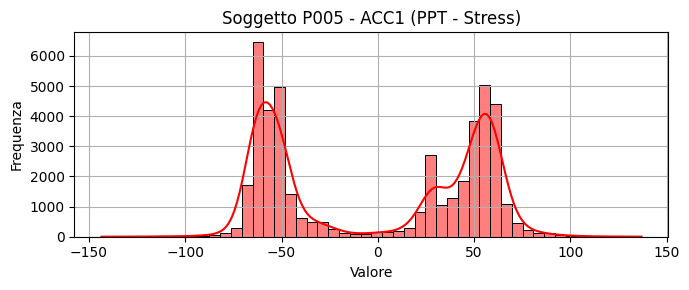

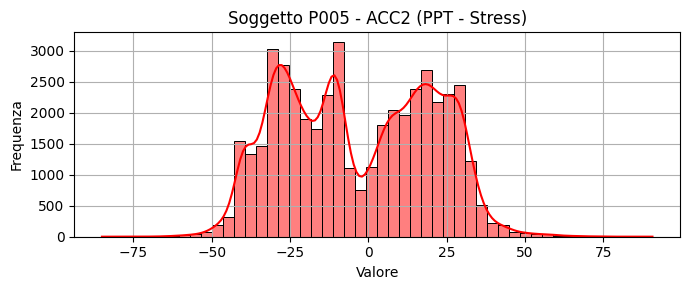

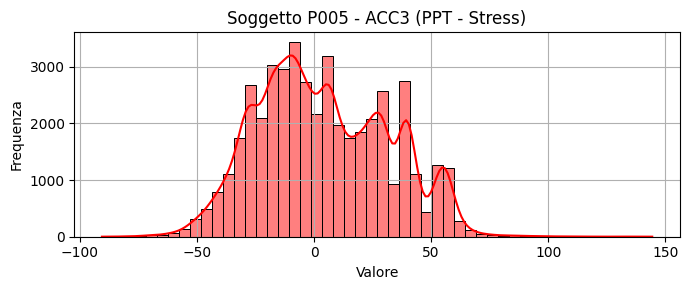

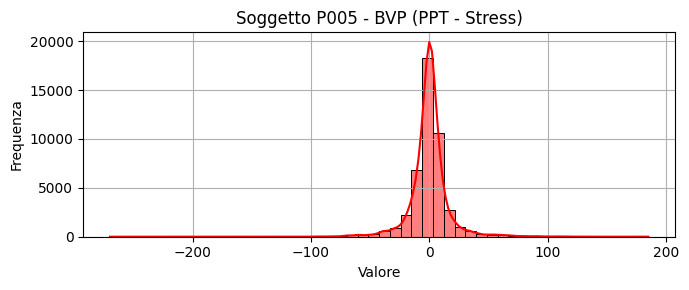

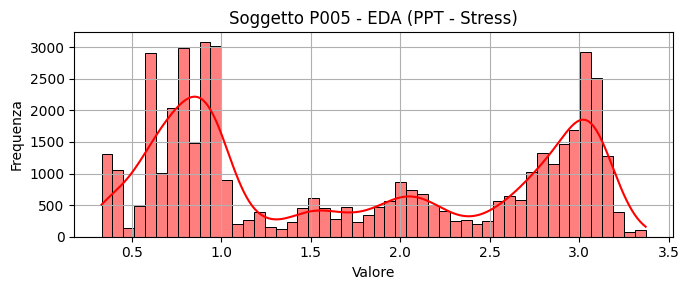

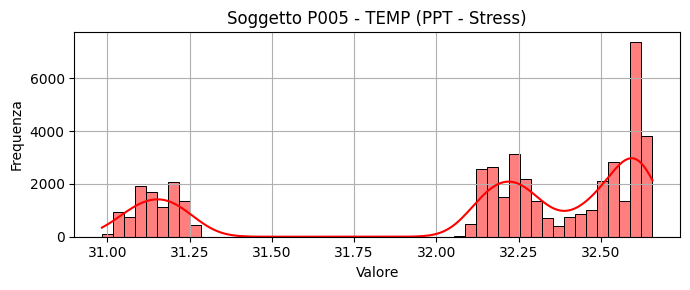


📊 Statistiche soggetto P008 (condizione PPT - Stress):
       Media  Deviazione Std      Min  Mediana      Max
ACC1 -57.145           9.350 -123.923  -58.952   -0.453
ACC2  10.725          14.385  -56.860   12.277   67.059
ACC3 -12.786          20.838  -98.672  -16.961   83.267
BVP    0.459          85.395 -680.510    1.515  592.010
EDA    0.302           0.273    0.095    0.224    1.832
TEMP  33.443           1.124   31.039   33.730   34.576


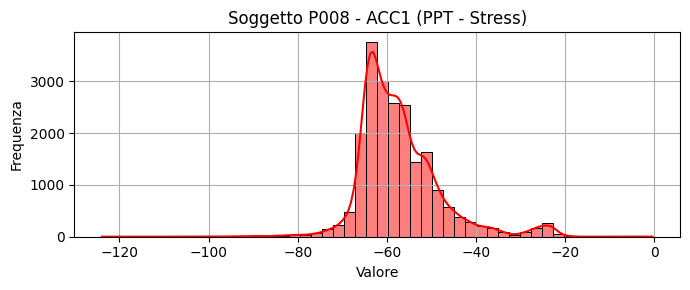

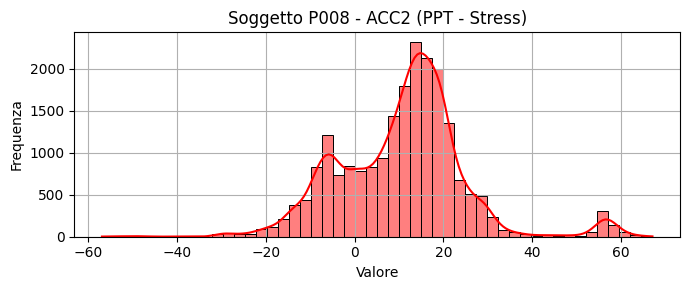

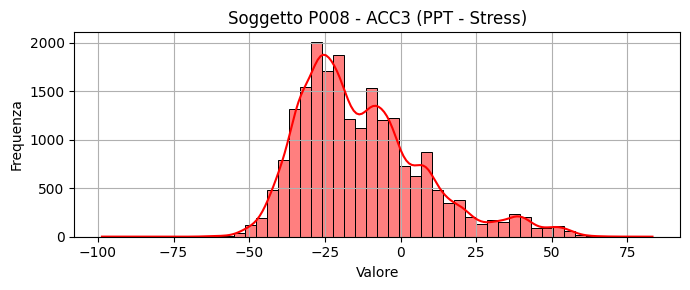

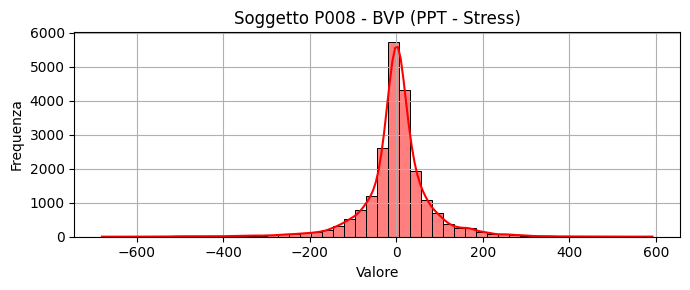

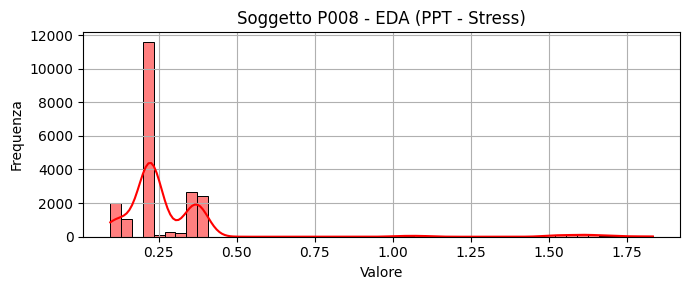

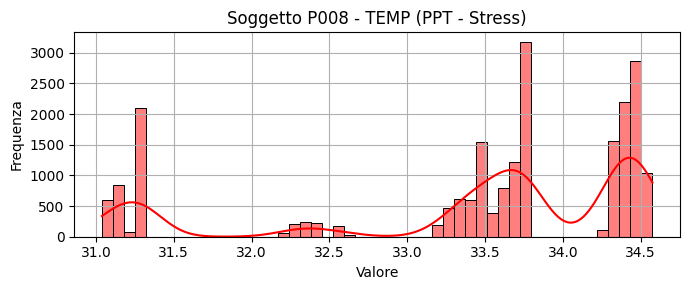


📊 Statistiche soggetto P023 (condizione PPT - Stress):
       Media  Deviazione Std      Min  Mediana      Max
ACC1  19.068          41.195 -127.378   31.253  140.741
ACC2   0.474          24.616 -144.413    3.536   75.019
ACC3 -20.967          34.474 -133.497  -25.976  123.026
BVP    0.202         106.092 -808.660    1.235  579.580
EDA    0.750           0.902    0.025    0.227    3.914
TEMP  32.691           1.605   30.442   33.729   34.318


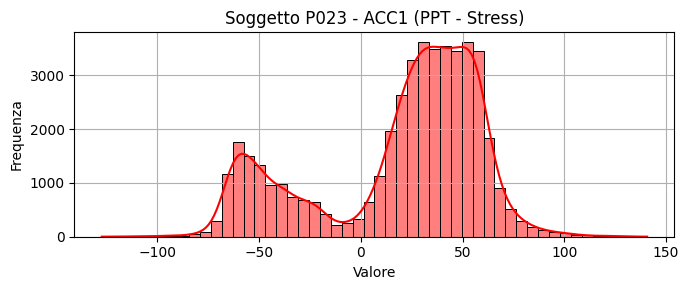

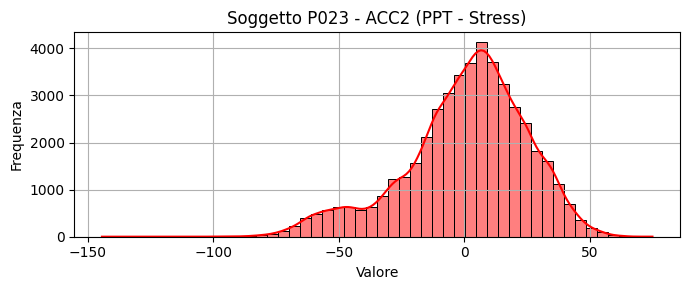

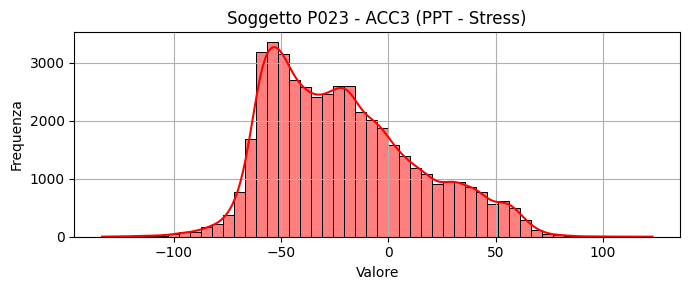

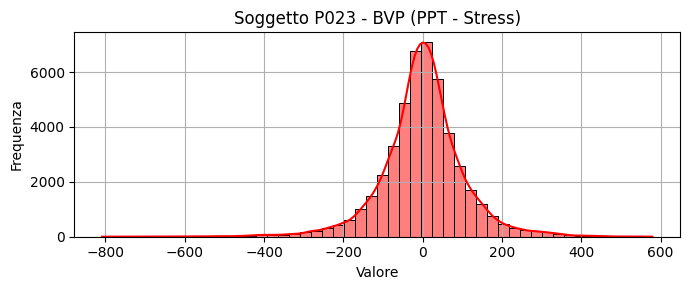

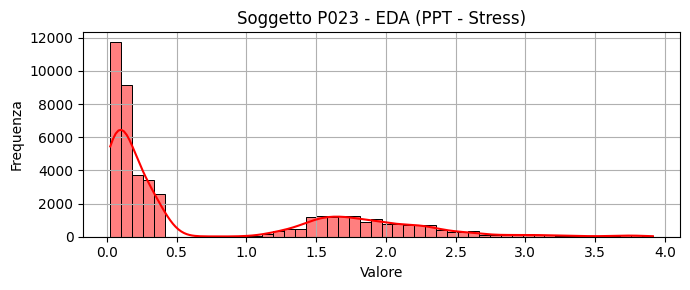

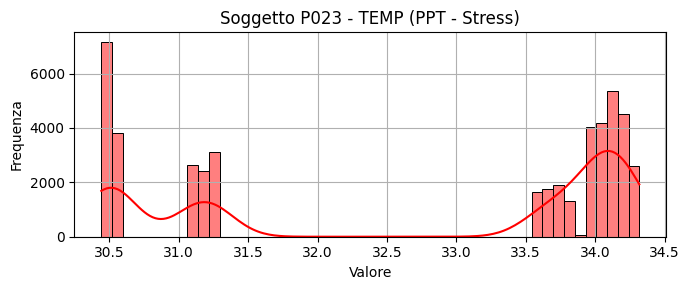


📊 Statistiche soggetto P032 (condizione PPT - Stress):
       Media  Deviazione Std      Min  Mediana     Max
ACC1 -21.349          36.568 -113.610    9.845  47.897
ACC2 -39.862          24.841  -69.362  -58.860  67.042
ACC3  -5.793          12.806  -61.333   -1.542  64.690
BVP   -0.002           3.088  -32.980    0.000  30.760
EDA    1.539           0.902    0.058    1.626   3.434
TEMP  33.356           0.538   32.481   33.429  34.316


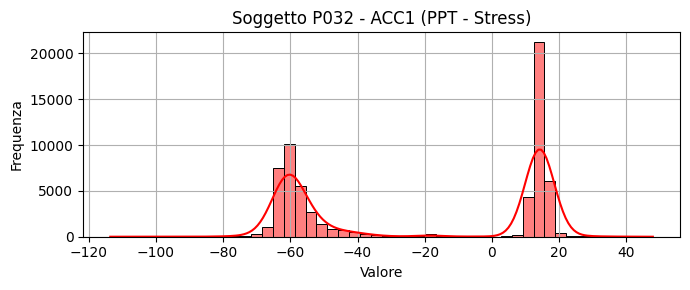

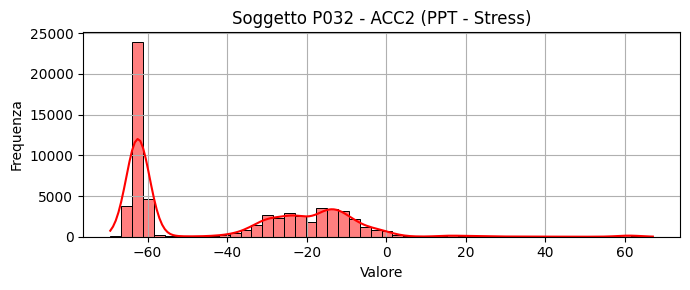

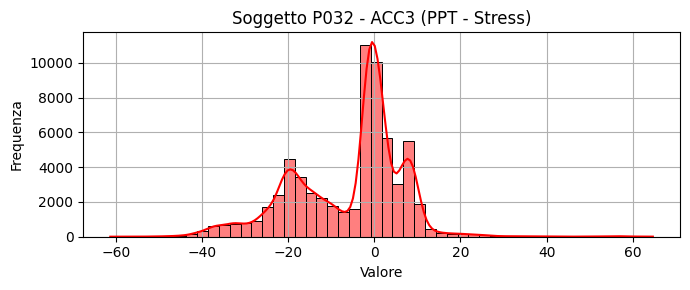

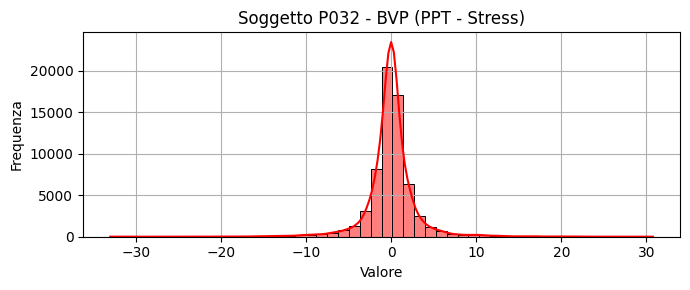

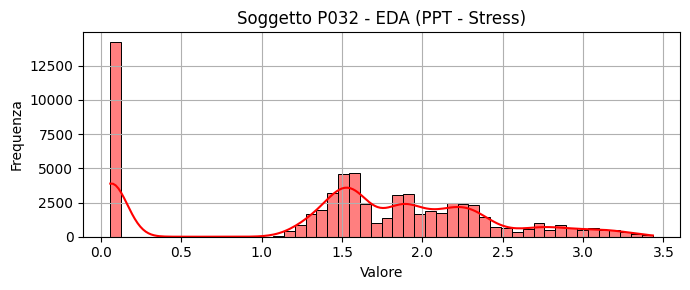

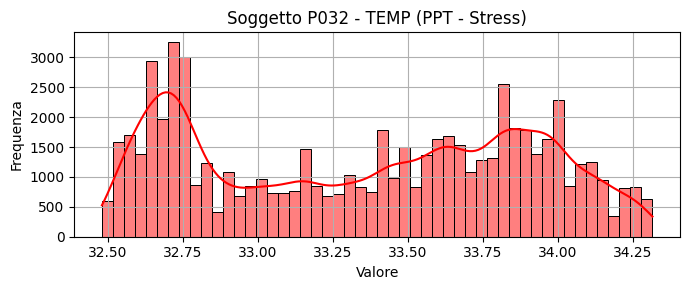


📊 Statistiche soggetto P035 (condizione PPT - Stress):
       Media  Deviazione Std      Min  Mediana      Max
ACC1 -25.108          42.255 -128.066  -31.220  109.156
ACC2  17.297          37.717 -106.547   19.823  106.856
ACC3   9.707           9.895  -57.662    9.950  102.567
BVP    0.223          40.413 -291.360    0.220  552.910
EDA    3.775           1.425    1.844    3.288    5.978
TEMP  34.265           0.779   32.084   34.609   34.815


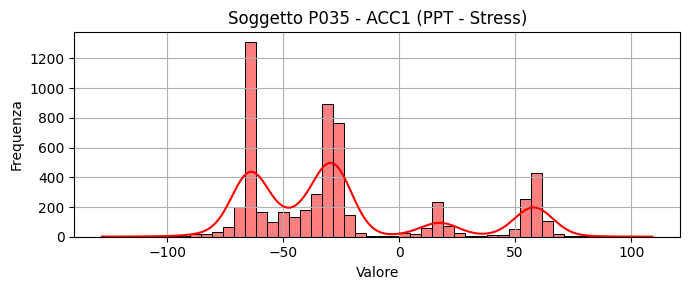

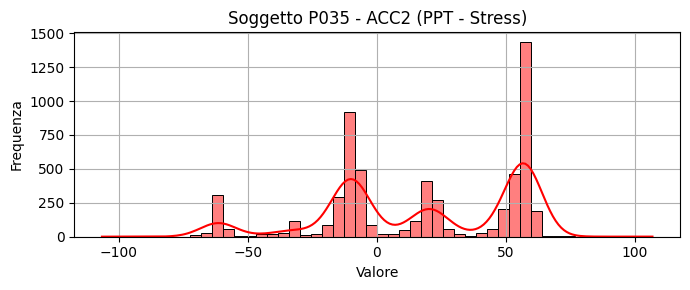

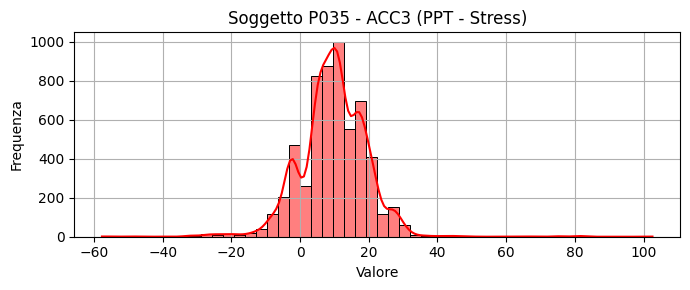

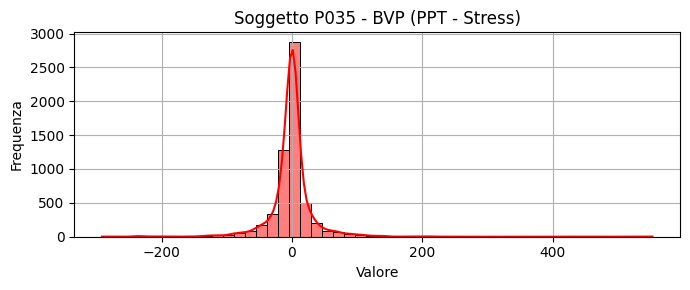

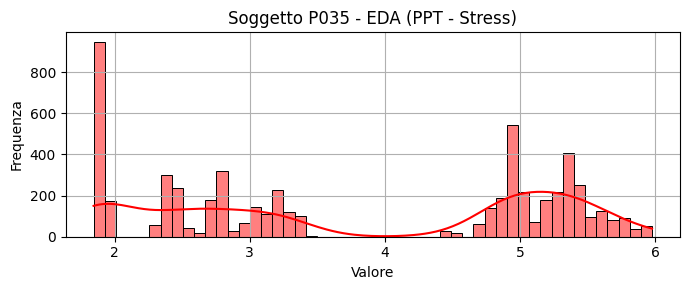

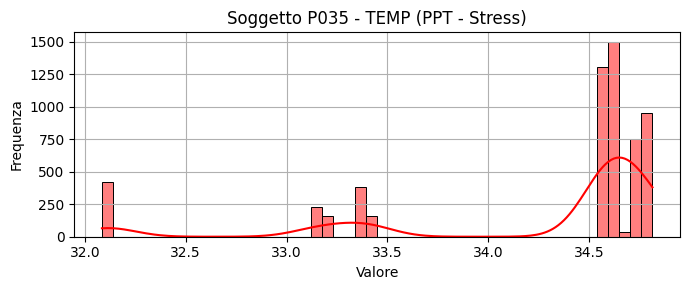


📊 Statistiche soggetto P037 (condizione PPT - Stress):
       Media  Deviazione Std      Min  Mediana      Max
ACC1  -1.491          45.703 -144.132   12.274  135.126
ACC2  -0.292          28.004  -67.134    3.809   79.323
ACC3 -23.002          30.429 -122.224  -29.112  125.007
BVP    0.321          31.745 -251.720   -1.255  164.690
EDA    0.227           0.147    0.036    0.108    0.617
TEMP  30.643           1.893   27.552   29.088   32.719


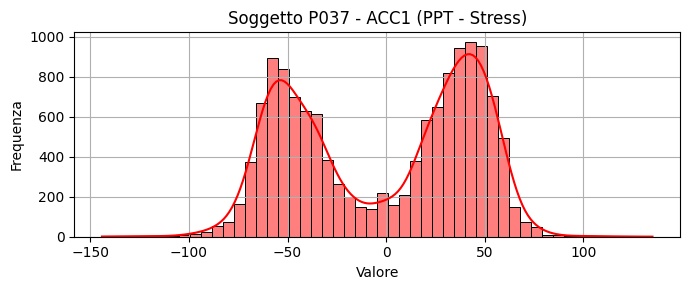

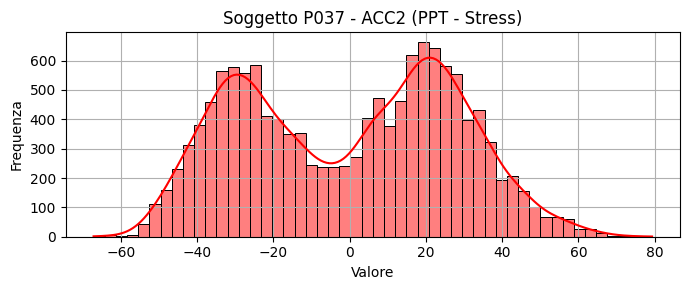

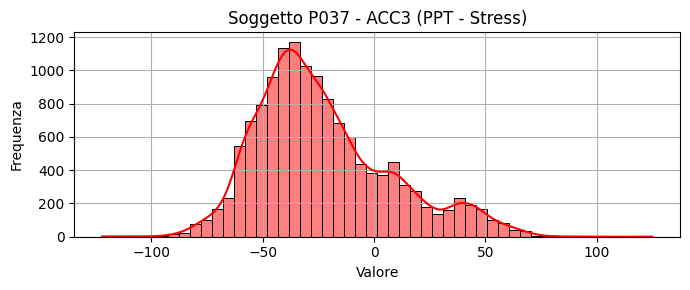

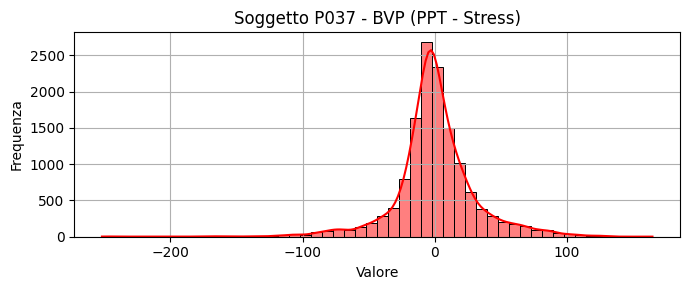

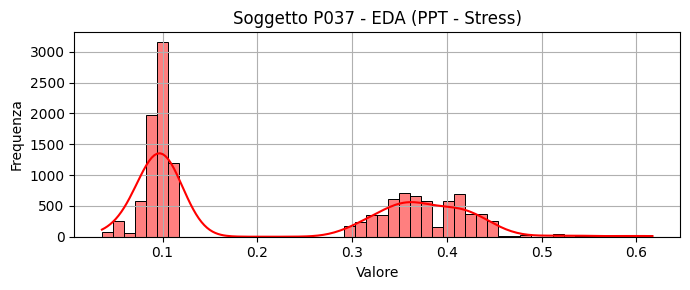

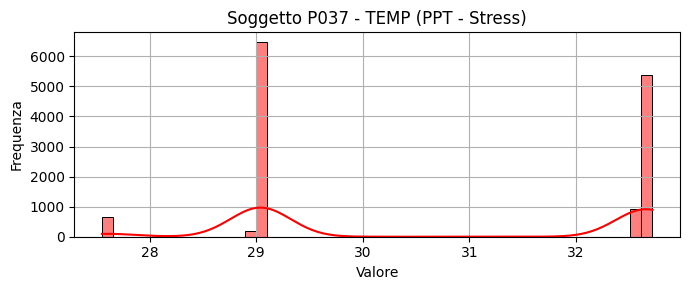


📊 Statistiche soggetto P038 (condizione PPT - Stress):
       Media  Deviazione Std      Min  Mediana      Max
ACC1 -34.546          20.327 -115.562  -37.000   72.180
ACC2  32.762          34.568  -89.000   48.963  129.156
ACC3  13.330          14.635  -70.835   17.831  113.654
BVP    0.220          38.756 -349.990    1.390  297.970
EDA    9.315           5.757    0.739    9.580   23.713
TEMP  32.703           0.489   31.366   32.970   33.037


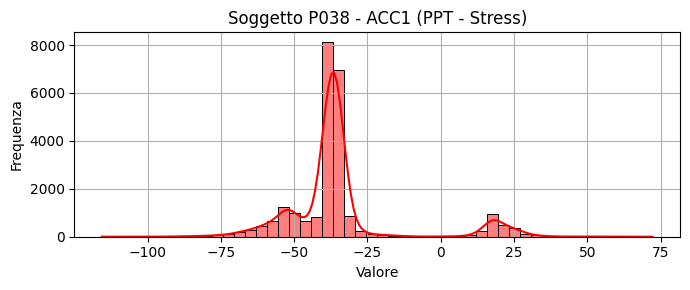

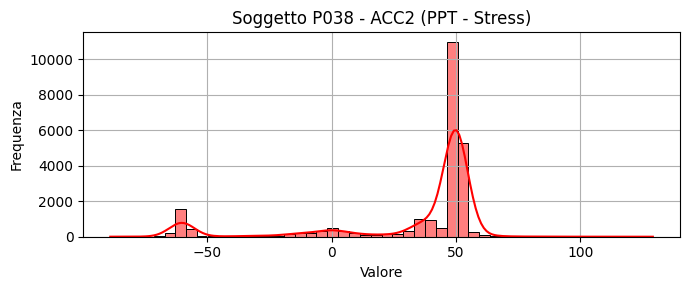

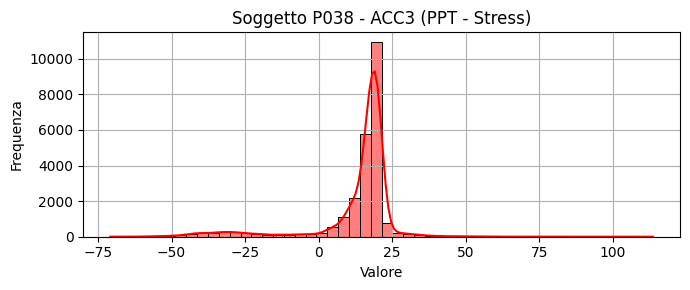

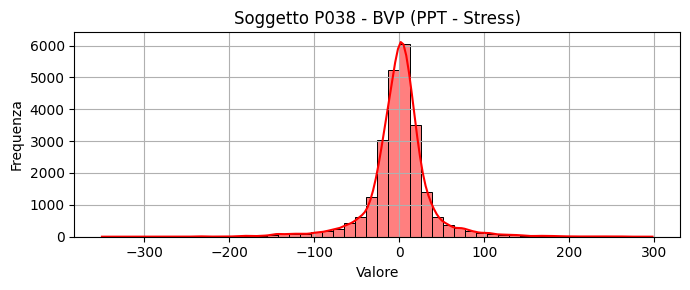

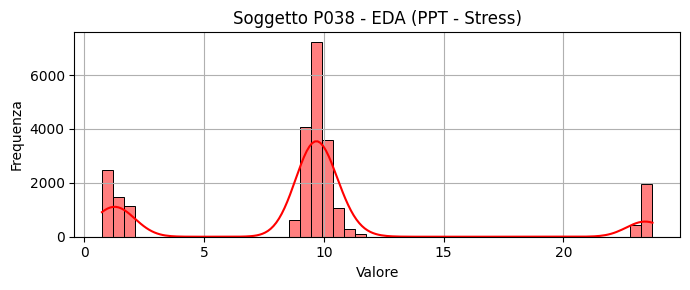

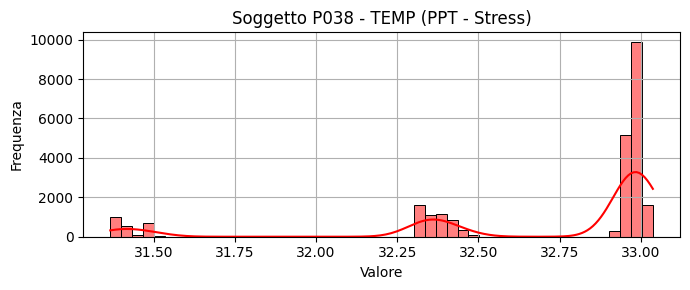


📊 Statistiche soggetto P041 (condizione PPT - Stress):
       Media  Deviazione Std       Min  Mediana      Max
ACC1   9.069          47.477  -143.059   23.178  143.825
ACC2   3.987          37.541  -137.499    9.979  130.024
ACC3  -0.647          24.112  -143.254    3.001  153.613
BVP    0.019          92.443 -1056.000    0.000  748.680
EDA    0.245           0.092     0.025    0.289    0.386
TEMP  31.554           1.653    28.839   31.990   33.279


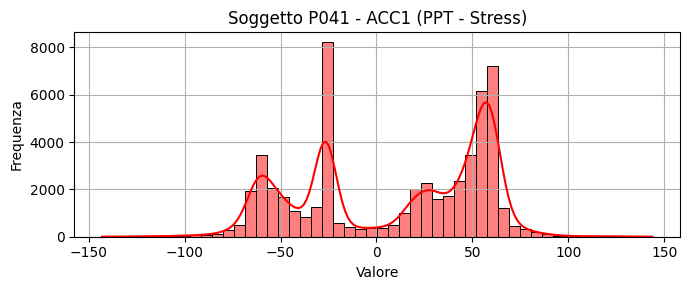

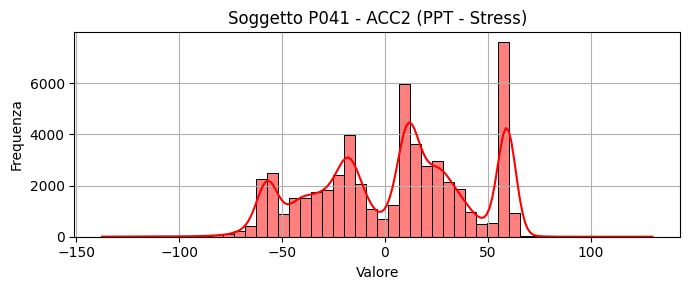

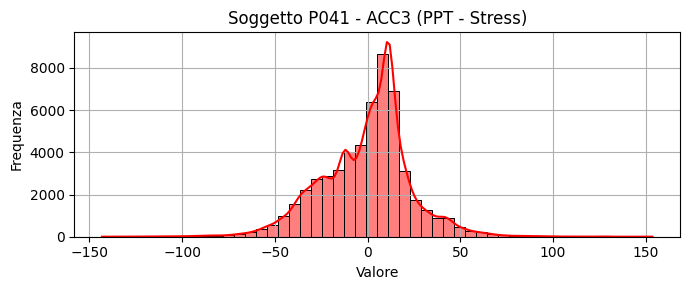

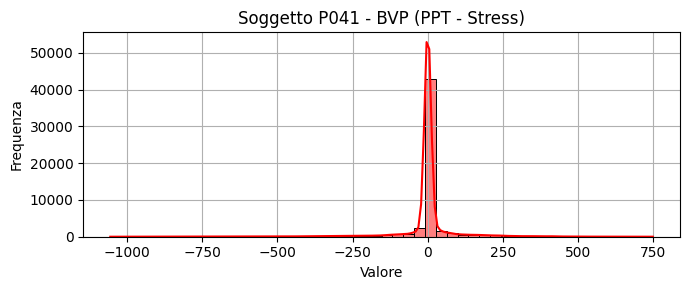

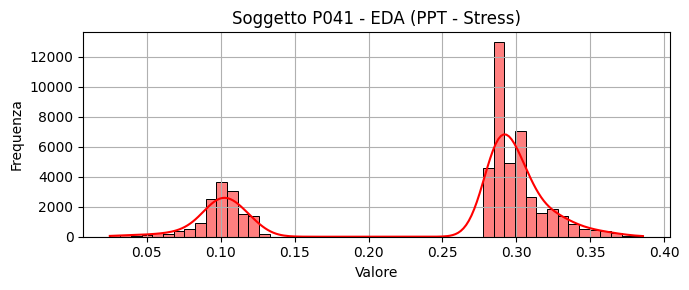

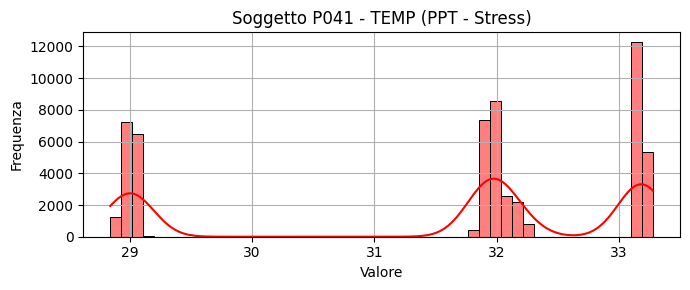


📊 Statistiche soggetto P043 (condizione PPT - Stress):
       Media  Deviazione Std      Min  Mediana      Max
ACC1   6.434          39.751 -125.702   20.217  137.808
ACC2 -18.865          39.739 -129.656  -40.337   99.891
ACC3   2.904          25.906 -128.581    1.982  140.091
BVP   -0.004          93.043 -582.690    3.050  472.810
EDA    0.674           0.216    0.357    0.675    1.794
TEMP  31.612           2.118   29.583   30.150   34.436


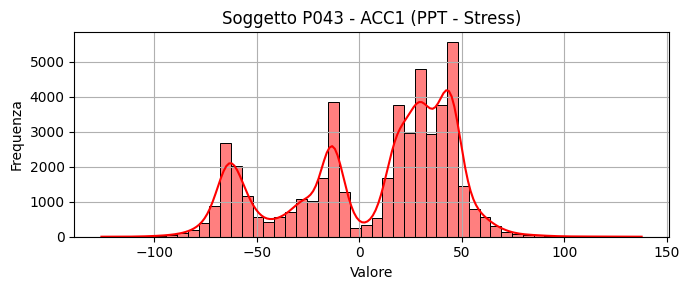

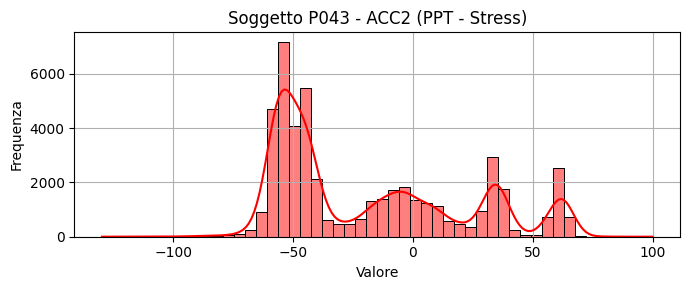

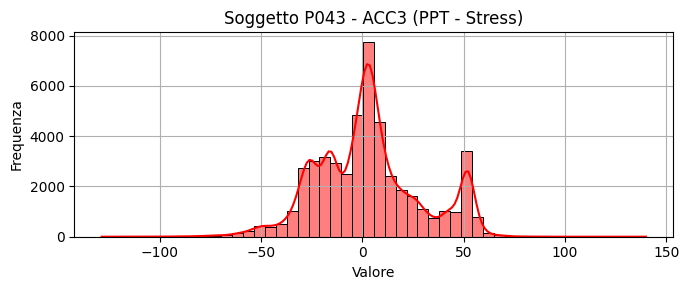

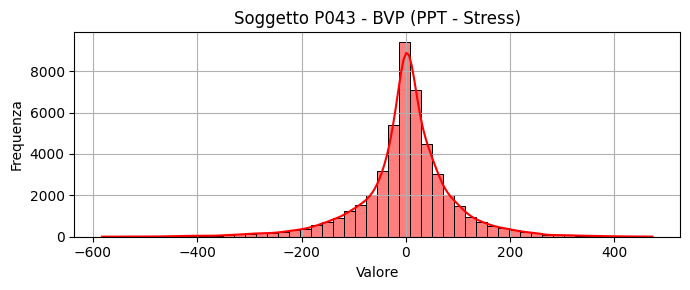

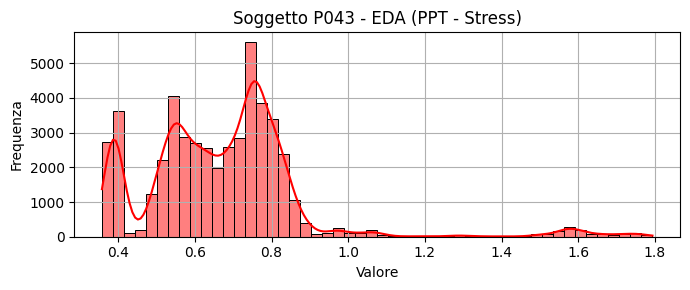

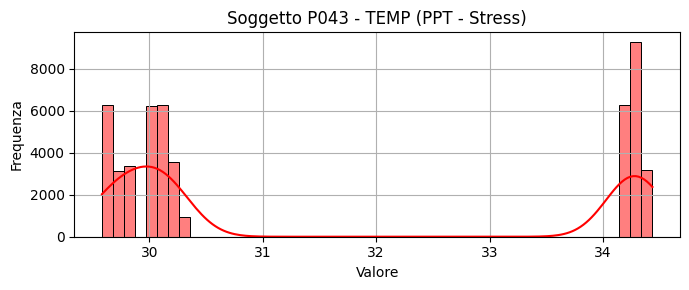


📊 Statistiche soggetto P044 (condizione PPT - Stress):
       Media  Deviazione Std      Min  Mediana      Max
ACC1 -32.051          26.829 -118.767  -42.037   57.693
ACC2   4.816          46.643  -72.531   27.059   68.859
ACC3   5.690          15.268  -89.044   10.241   59.740
BVP    0.236          73.657 -776.560    0.350  737.510
EDA    0.186           0.178    0.001    0.121    0.756
TEMP  32.758           1.660   30.500   33.050   34.665


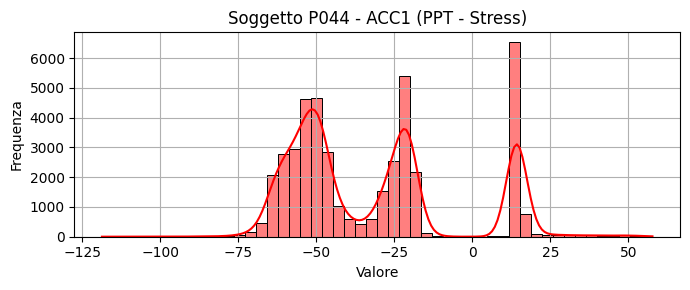

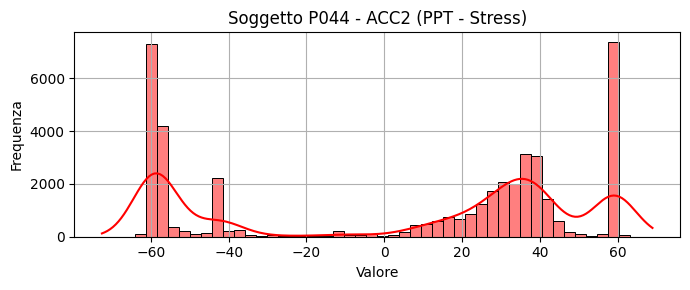

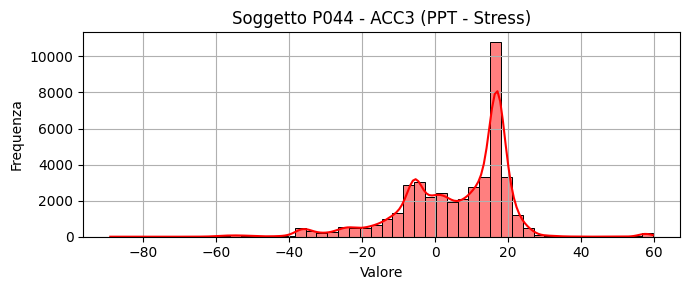

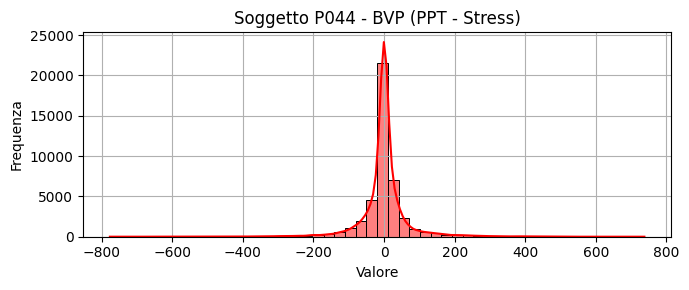

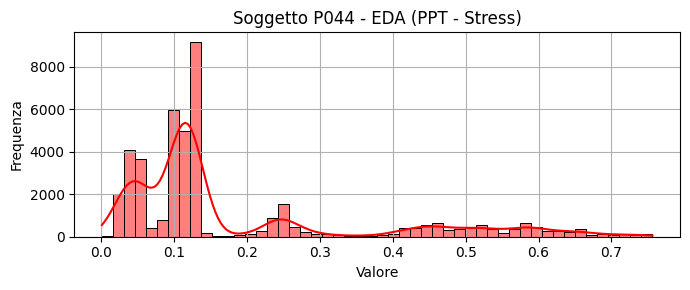

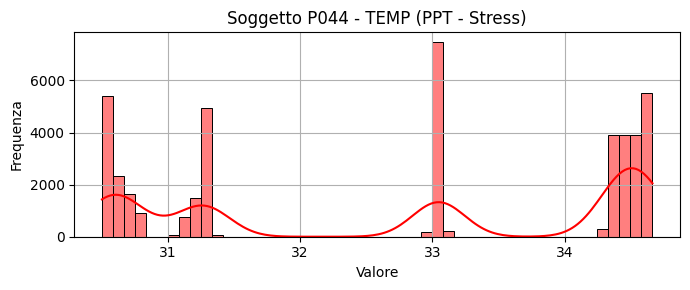


📊 Statistiche soggetto P046 (condizione PPT - Stress):
       Media  Deviazione Std      Min  Mediana      Max
ACC1   4.946          57.101 -146.343   19.000  152.516
ACC2   3.226          23.285 -142.198    7.000  112.786
ACC3  -1.083          21.202 -105.264   -0.820  122.112
BVP    0.164          91.954 -813.860    1.330  996.810
EDA    0.261           0.084    0.166    0.249    0.495
TEMP  32.157           0.118   31.991   32.128   32.485


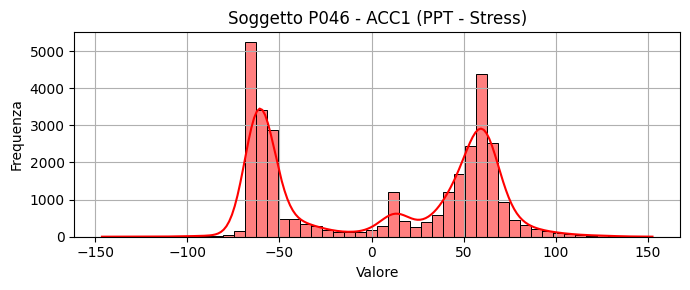

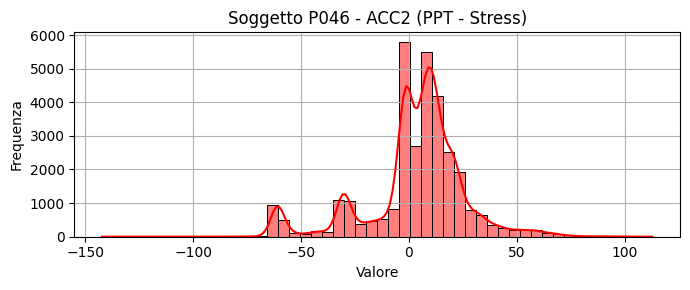

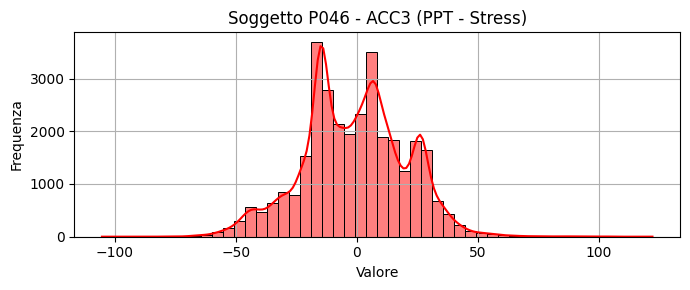

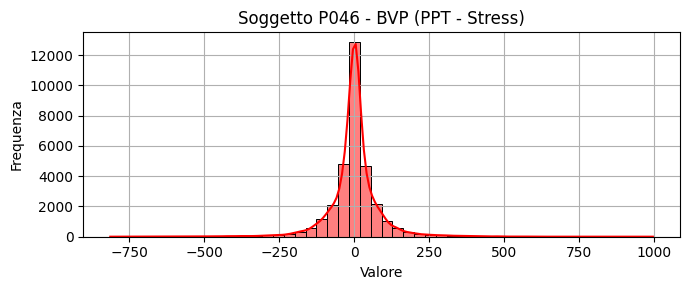

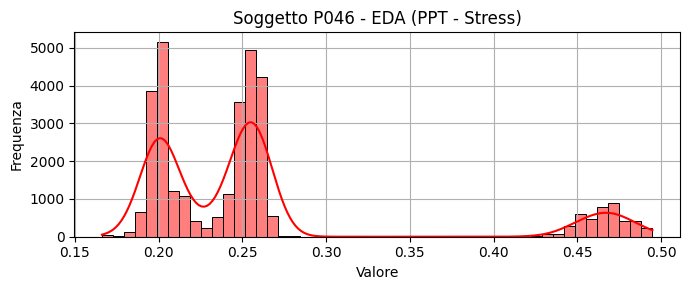

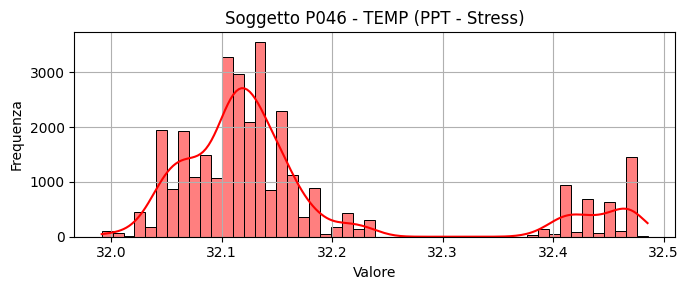


📊 Statistiche soggetto P047 (condizione PPT - Stress):
       Media  Deviazione Std      Min  Mediana      Max
ACC1 -22.267          45.777 -103.000  -40.583  135.757
ACC2   1.631          32.180 -100.809  -11.786  112.324
ACC3 -13.215          19.480 -113.125  -11.000   68.509
BVP    0.007          29.188 -357.000    0.770  324.860
EDA    0.295           0.173    0.189    0.211    1.085
TEMP  32.607           1.524   30.163   33.025   34.415


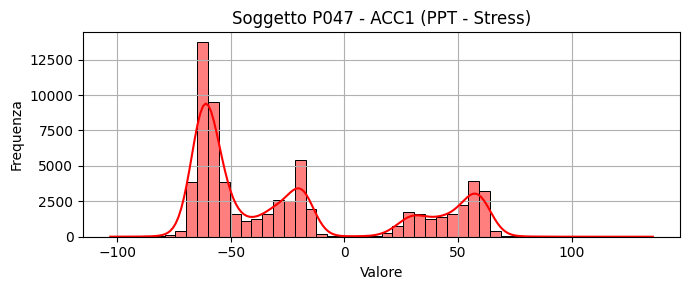

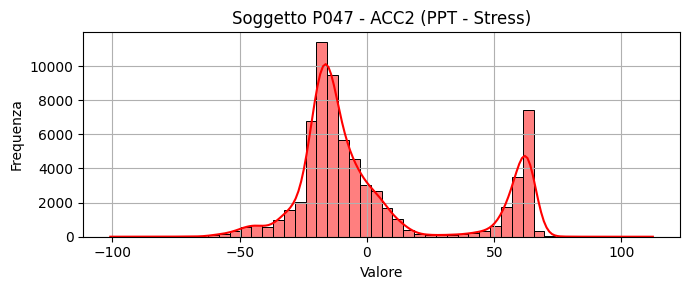

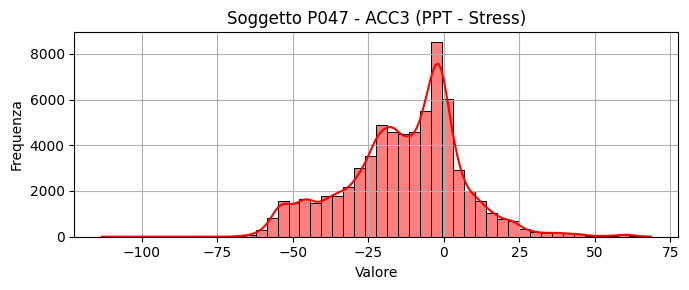

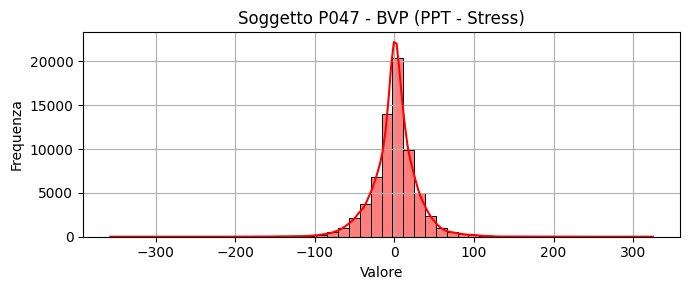

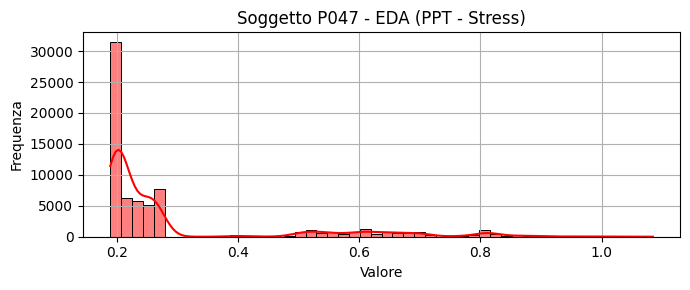

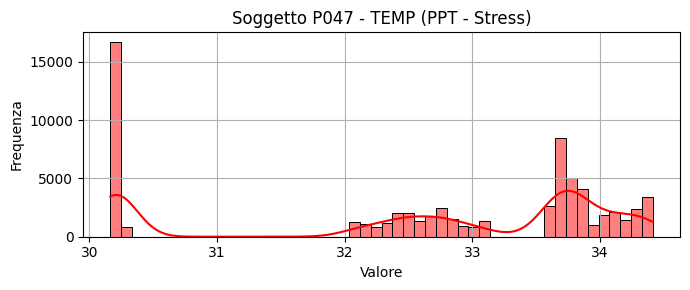


📊 Statistiche soggetto P049 (condizione PPT - Stress):
       Media  Deviazione Std       Min  Mediana       Max
ACC1  17.347          44.163   -94.000   40.024   118.385
ACC2 -15.052          25.936  -126.223  -22.012    71.370
ACC3  -8.382          30.214  -112.022  -11.000   127.390
BVP   -0.242          73.723 -1087.700    0.270  1269.400
EDA    0.442           0.569    -0.009    0.164     2.378
TEMP  32.301           2.319    28.903   32.250    35.062


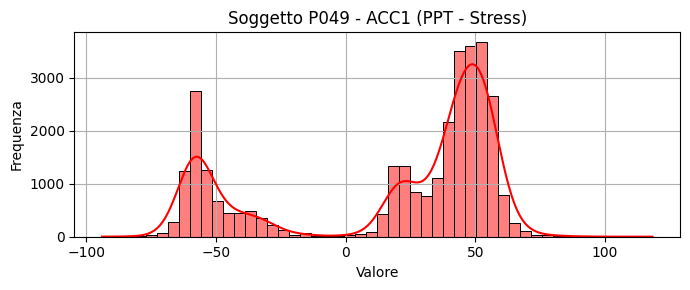

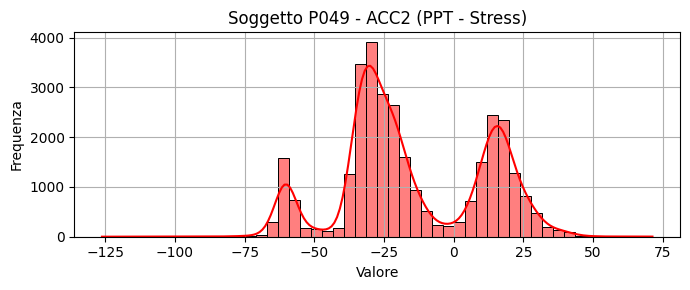

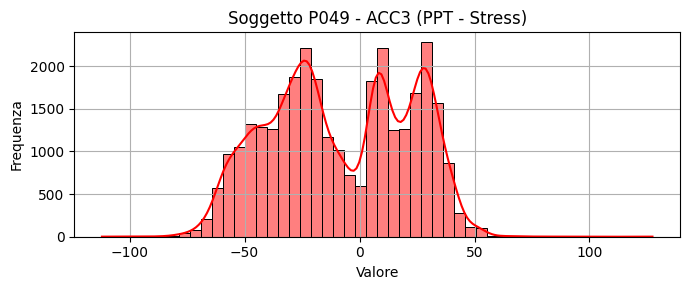

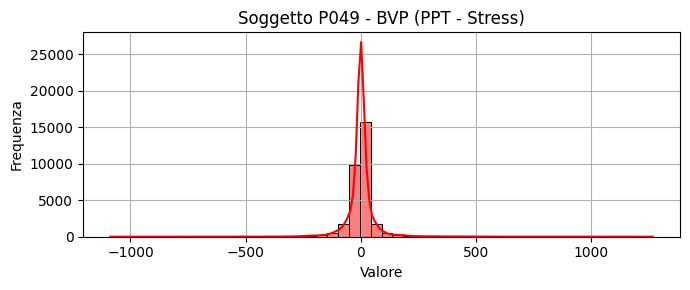

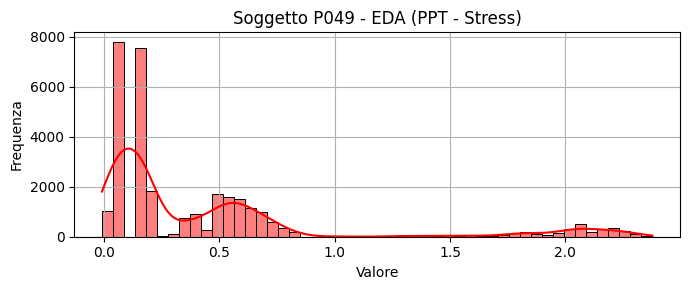

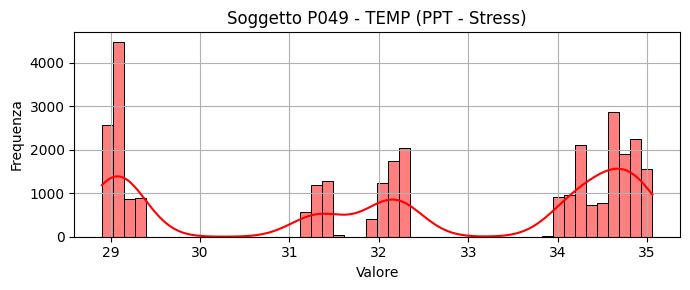


📊 Statistiche soggetto P058 (condizione PPT - Stress):
       Media  Deviazione Std      Min  Mediana      Max
ACC1  35.707          16.777  -38.899   33.045  109.000
ACC2  -6.610          40.811 -110.160    8.765   63.456
ACC3  -4.588          28.871 -101.735    0.825   75.853
BVP   -0.000          45.198 -264.680    0.180  365.790
EDA    0.406           0.371    0.053    0.217    1.469
TEMP  32.020           3.664   26.542   34.369   34.923


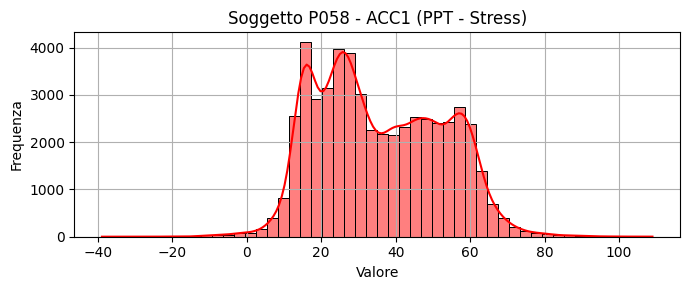

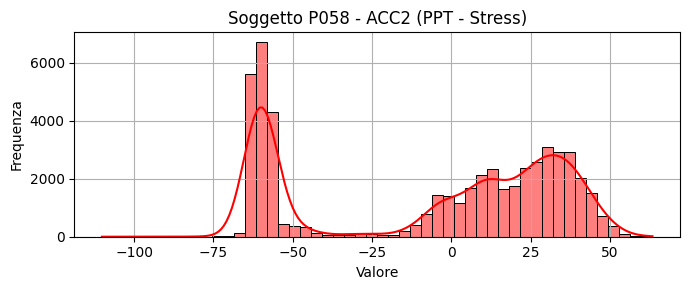

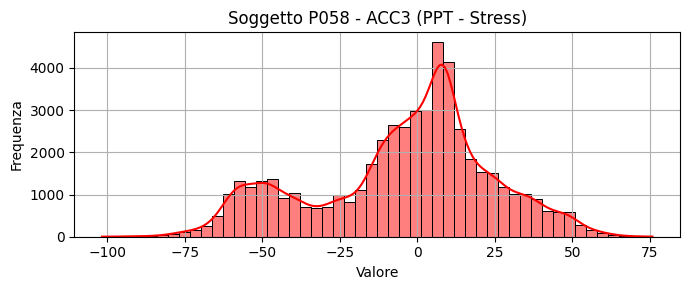

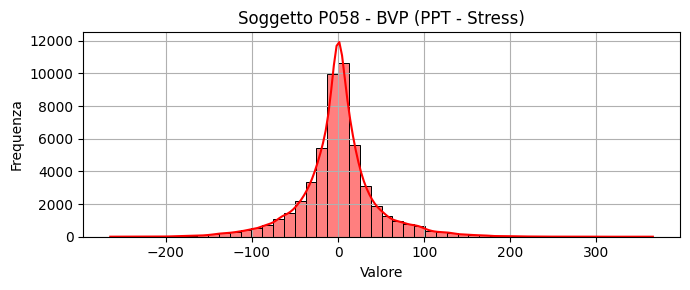

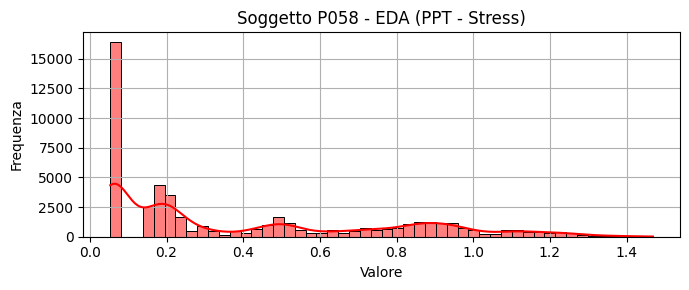

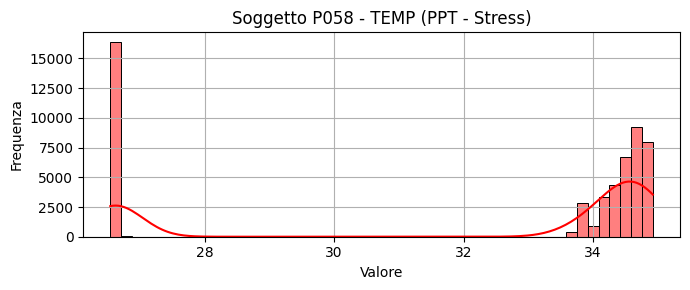


📊 Statistiche soggetto P062 (condizione PPT - Stress):
       Media  Deviazione Std      Min  Mediana      Max
ACC1  41.153           3.643   12.431   40.710   76.115
ACC2 -46.826           3.304  -57.001  -47.933  -25.676
ACC3   2.398          10.423  -51.843    5.077   36.295
BVP    0.001           8.074 -203.920   -0.080  101.830
EDA    0.446           0.242    0.207    0.390    1.063
TEMP  31.802           2.337   28.381   32.601   34.719


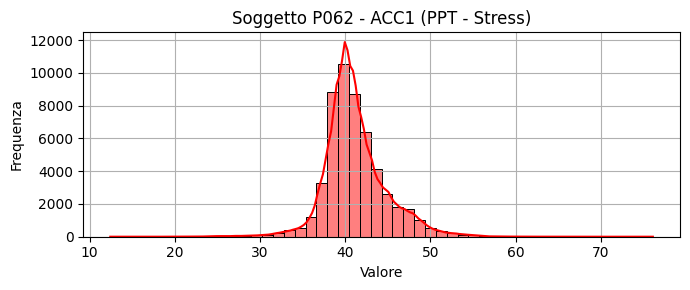

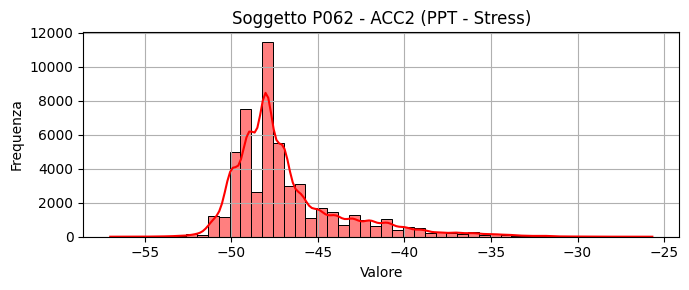

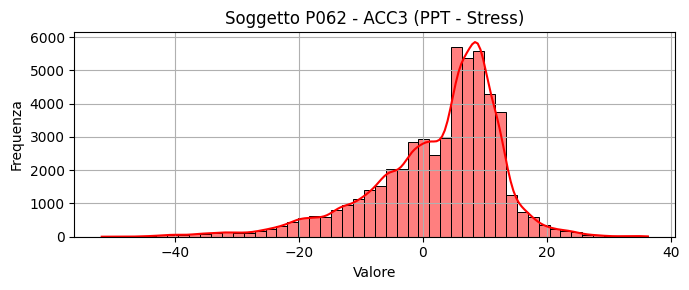

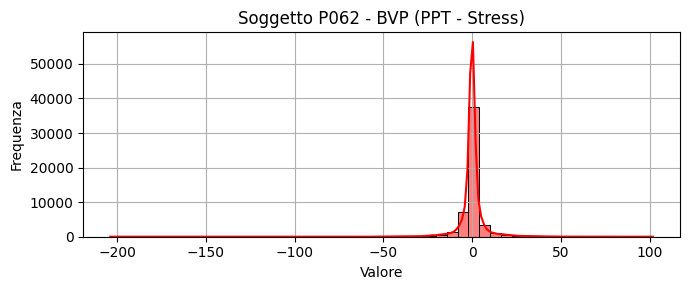

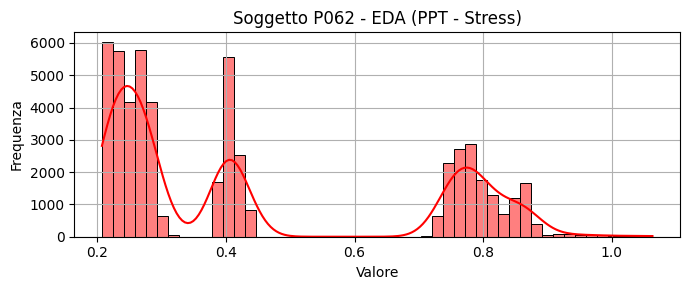

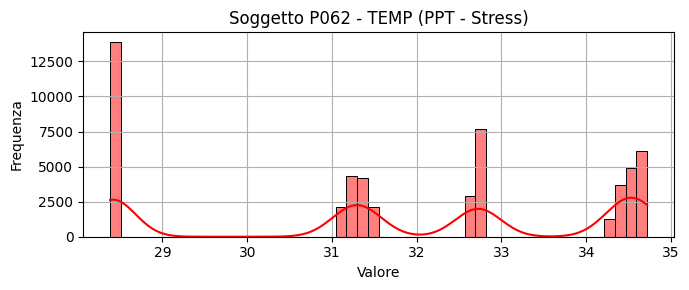


📊 Statistiche soggetto P065 (condizione PPT - Stress):
       Media  Deviazione Std      Min  Mediana      Max
ACC1  45.263          18.990  -79.010   48.930  150.962
ACC2  10.134          20.692 -152.274   10.000   96.357
ACC3 -19.020          32.268 -144.121  -25.465  115.534
BVP   -0.005          66.278 -553.810   -1.000  627.250
EDA    0.210           0.450   -0.008    0.003    1.511
TEMP  33.050           0.425   32.244   33.183   33.498


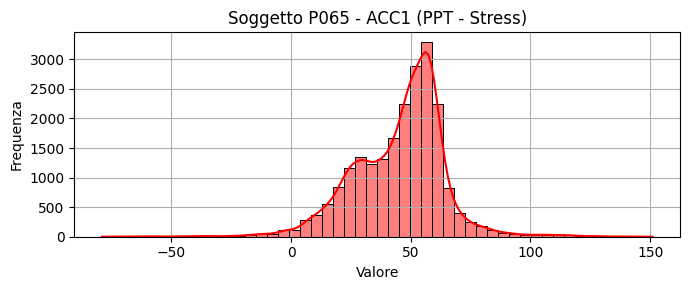

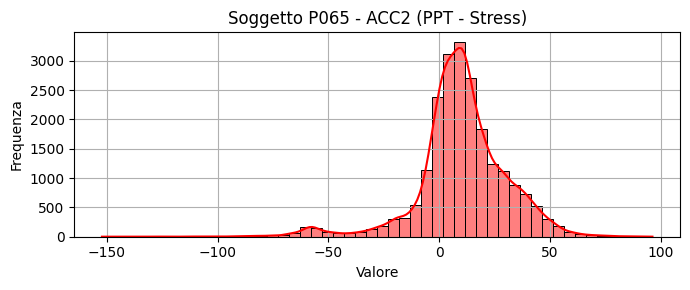

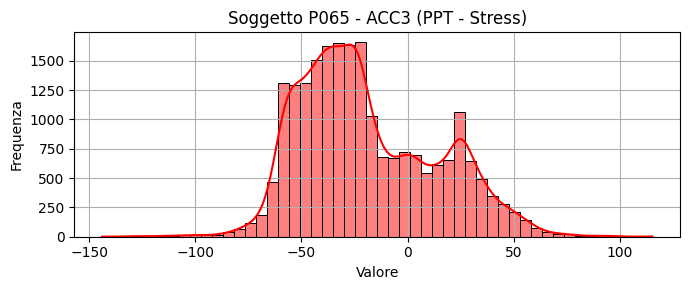

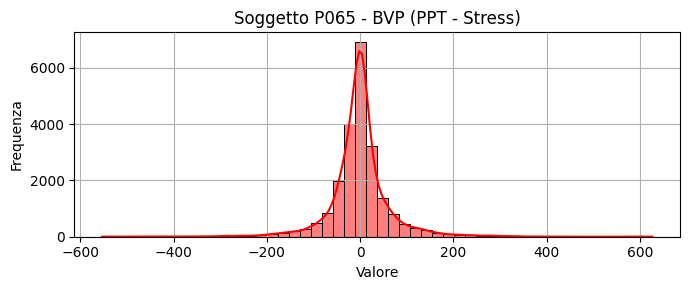

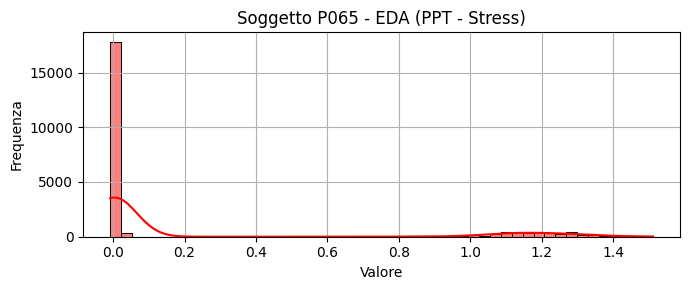

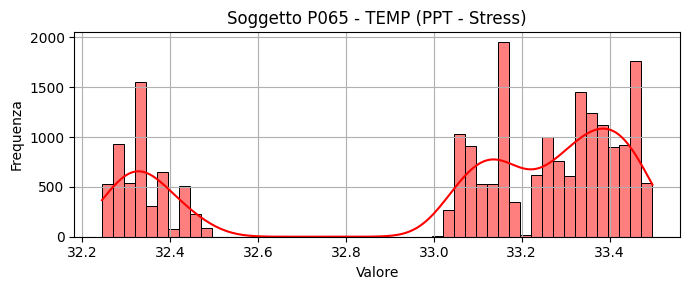


📊 Statistiche soggetto P071 (condizione PPT - Stress):
       Media  Deviazione Std      Min  Mediana      Max
ACC1  19.724          44.765 -138.440   35.042  138.900
ACC2  -9.711          31.725 -141.095  -14.375  117.840
ACC3  10.465          26.497 -129.341   17.297  120.923
BVP    0.008          21.476 -300.820    0.130  221.480
EDA    0.263           0.222    0.051    0.155    2.451
TEMP  34.358           0.560   33.323   34.296   35.416


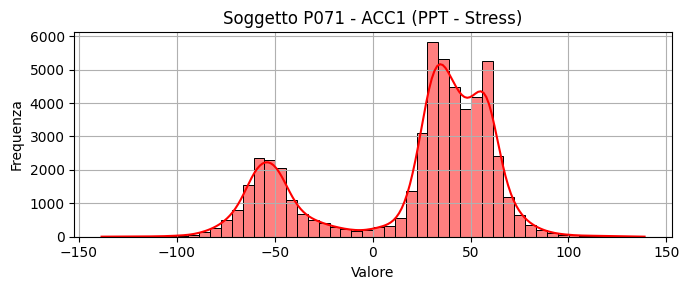

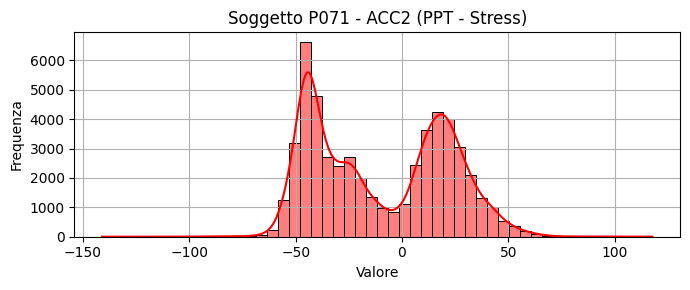

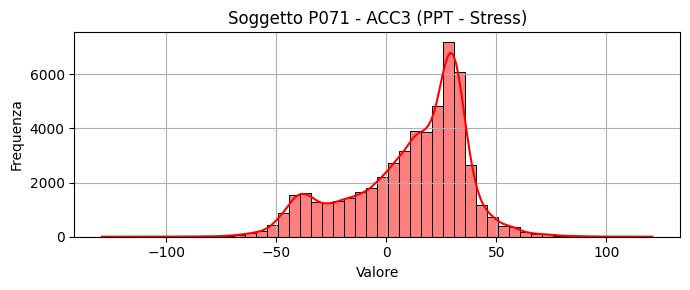

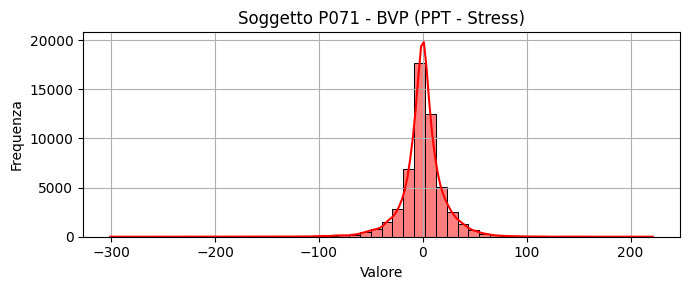

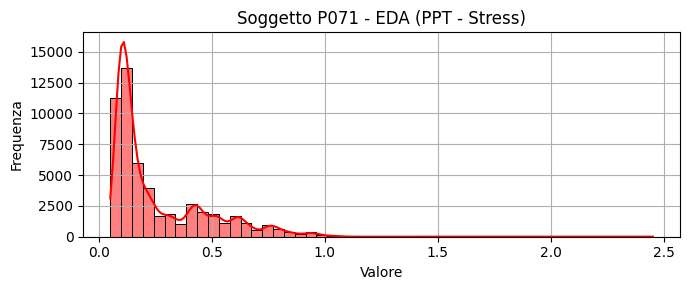

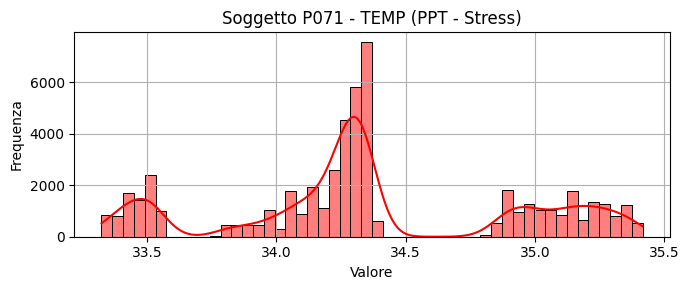

In [ ]:
analizza_variabilita_stress(df)

In [ ]:
def remove_subjects_without_positive_labels(df, label_col='label', subject_col='subject'):
    """
    Rimuove tutti i datapoint dei soggetti che non hanno nessuna etichetta positiva (label == 1).

    Parameters:
        df (pd.DataFrame): Il dataset completo.
        label_col (str): Il nome della colonna delle etichette.
        subject_col (str): Il nome della colonna dei soggetti.

    Returns:
        df_filtered (pd.DataFrame): Il dataframe filtrato.
        removed_subjects (list): Lista dei soggetti rimossi.
    """
    # Trova i soggetti che hanno almeno una label == 1
    subjects_with_positive = df[df[label_col] == 1][subject_col].unique()

    # Trova i soggetti che NON hanno etichette positive
    all_subjects = df[subject_col].unique()
    removed_subjects = sorted(list(set(all_subjects) - set(subjects_with_positive)))

    # Filtra il dataframe per rimuovere i soggetti da escludere
    df_filtered = df[~df[subject_col].isin(removed_subjects)].reset_index(drop=True)

    return df_filtered, removed_subjects

In [ ]:
df, soggetti_rimossi = remove_subjects_without_positive_labels(df)

print("Soggetti rimossi:", soggetti_rimossi)

Soggetti rimossi: []


In [ ]:
pip install neurokit2

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 696.5/696.5 kB 12.8 MB/s eta 0:00:00


In [ ]:
import neurokit2 as nk

In [ ]:
ppg_raw = df["BVP"].values

fs = 64

ppg_signals, ppg_info = nk.ppg_process(ppg_raw, sampling_rate=fs)

ppg_clean = ppg_signals["PPG_Clean"]

df['BVP_CLEAN'] = ppg_clean

In [ ]:
def plot_raw_vs_clean_from_single_df(df, raw_col, clean_col, n_points=None):

    soggetti = df['subject'].unique()

    for soggetto in soggetti:
        df_soggetto = df[df['subject'] == soggetto]

        for condizione, label in zip(['Baseline', 'Stress'], [0, 1]):
            subset = df_soggetto[df_soggetto['label'] == label]
            raw_signal = subset[raw_col].values
            clean_signal = subset[clean_col].values

            if n_points:
                raw_signal = raw_signal[:n_points]
                clean_signal = clean_signal[:n_points]

            plt.figure(figsize=(15, 3))
            plt.plot(raw_signal, label='Raw', color='gray', alpha=0.5)
            plt.plot(clean_signal, label='Clean', color='blue', alpha=0.8)
            plt.title(f"Soggetto: {soggetto} - Condizione: {condizione} - Segnale: {raw_col.upper()}")
            plt.xlabel("Campioni")
            plt.ylabel("Ampiezza")
            plt.legend()
            plt.grid(True)
            plt.tight_layout()
            plt.show()

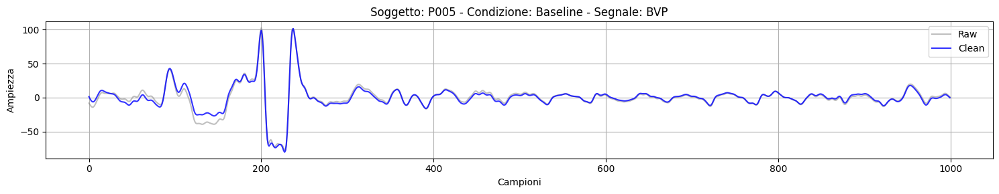

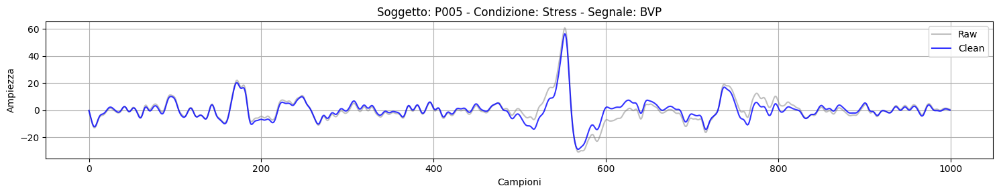

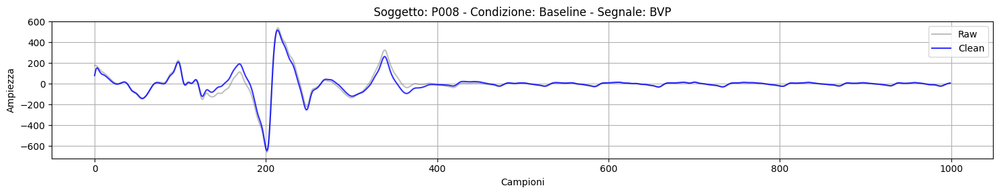

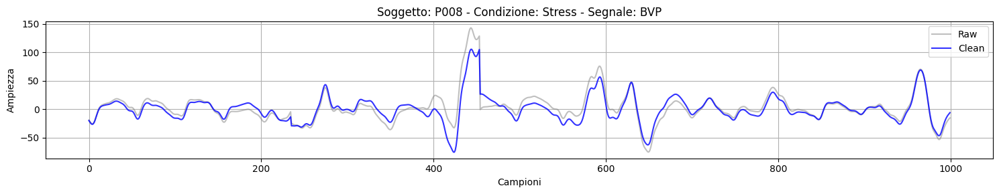

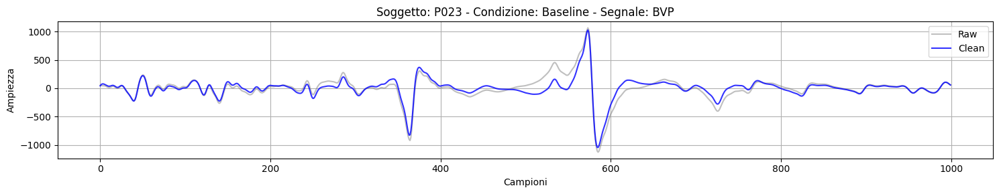

...

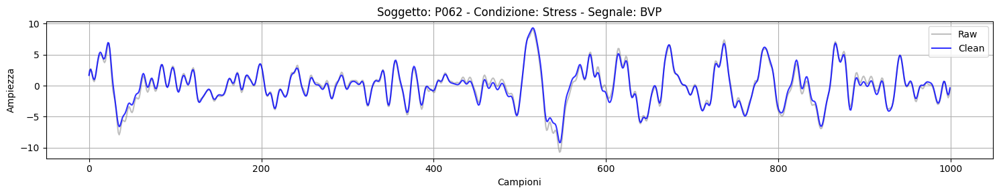

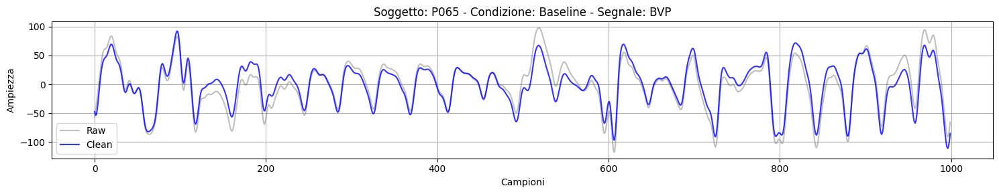

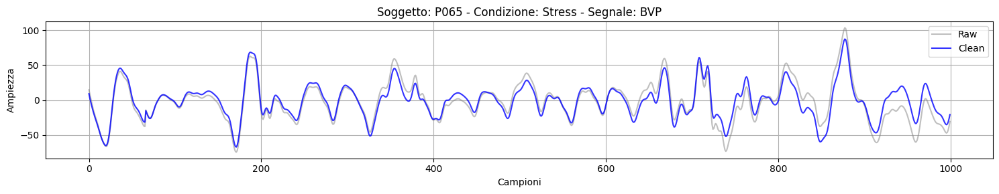

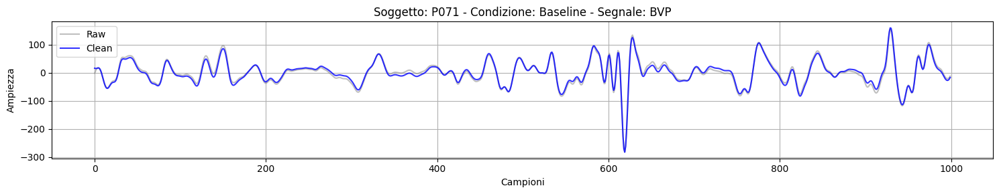

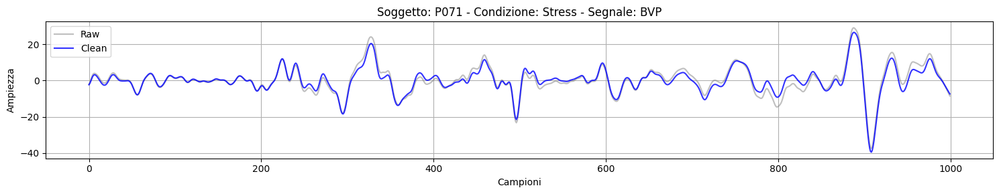

In [ ]:
plot_raw_vs_clean_from_single_df(df, 'BVP', 'BVP_CLEAN', n_points = 1000)

In [ ]:
from scipy.signal import find_peaks

# Parametri
fs = 64  # frequenza di campionamento
window_sec = 60
overlap = 0.75
window_size = int(fs * window_sec)
step_size = int(window_size * (1 - overlap))

# Lista per raccogliere le feature
features_list = []

# Scorri per finestra
for start in range(0, len(df) - window_size, step_size):
    window = df["BVP_CLEAN"].iloc[start:start + window_size].values
    labels = df["label"].iloc[start:start + window_size].values
    subject = df["subject"].iloc[start]
    phase = df["phase"].iloc[start]
    session = df["session"].iloc[start]

    # Conta le etichette nella finestra
    counts = np.bincount(labels.astype(int), minlength=2)
    total = counts.sum()
    dominant_label = np.argmax(counts)
    dominant_ratio = counts[dominant_label] / total

    # Scarta la finestra se nessuna classe è predominante almeno al 70%
    if dominant_ratio < 0.7:
        continue

    label = dominant_label  # assegna label predominante

    try:
        # HRV features (NeuroKit2)
        signals, info = nk.ppg_peaks(window, sampling_rate=fs)
        hrv_features = nk.hrv(info, sampling_rate=fs, show=False)

        # --- Time-domain features manuali (Scipy) ---
        peaks, _ = find_peaks(window, distance=fs * 0.5, height=0)
        if len(peaks) < 2:
            raise ValueError("Troppi pochi picchi")

        # Amplitude
        amplitudes = window[peaks]
        amp_mean = np.mean(amplitudes)

        # Rise time
        rise_times = []
        for peak in peaks:
            if peak == 0:
                continue
            min_idx = np.argmin(window[:peak])
            rise_time = (peak - min_idx) / fs
            rise_times.append(rise_time)
        rise_time_mean = np.mean(rise_times)

        # Duration (IBI)
        ibi = np.diff(peaks) / fs
        duration_mean = np.mean(ibi)

        # Inserisci le feature nel DataFrame
        hrv_features["PPG_Amplitude"] = amp_mean
        hrv_features["PPG_RiseTime"] = rise_time_mean
        hrv_features["PPG_Duration"] = duration_mean
        hrv_features["label"] = label
        hrv_features["subject"] = subject
        hrv_features["phase"] = phase
        hrv_features["session"] = session

        features_list.append(hrv_features)

    except Exception as e:
        print(f"Errore nella finestra {start}-{start + window_size}: {e}")

# Combina tutte le feature in un unico DataFrame
bvp_features = pd.concat(features_list, ignore_index=True) if features_list else pd.DataFrame()

In [ ]:
print("Shape of BVP Features:",bvp_features.shape)
bvp_features.head()

Shape of BVP Features: (1977, 90)


,HRV_MeanNN,HRV_SDNN,HRV_SDANN1,HRV_SDNNI1,HRV_SDANN2,HRV_SDNNI2,HRV_SDANN5,HRV_SDNNI5,HRV_RMSSD,HRV_SDSD,...,HRV_KFD,HRV_LZC,PPG_Amplitude,PPG_RiseTime,PPG_Duration,label,subject,phase,session,HRV_DFA_alpha2
0,774.465461,241.082297,NaN,NaN,NaN,NaN,NaN,NaN,363.338649,365.727612,...,3.505378,1.315353,11.754638,26.448333,0.805321,0,P005,RELAX,PRE,NaN
1,761.160714,227.699015,NaN,NaN,NaN,NaN,NaN,NaN,327.306506,329.473459,...,3.557895,1.139416,8.777484,10.878495,0.792083,0,P005,RELAX,PRE,NaN
2,762.378247,227.041769,NaN,NaN,NaN,NaN,NaN,NaN,304.170445,306.154532,...,2.784000,1.302189,8.843158,20.045847,0.784792,0,P005,RELAX,PRE,NaN
3,763.392857,196.316732,NaN,NaN,NaN,NaN,NaN,NaN,260.292597,262.012245,...,3.367048,1.139416,7.955898,20.556818,0.773438,0,P005,RELAX,PRE,NaN
4,746.594551,165.391042,NaN,NaN,NaN,NaN,NaN,NaN,220.122664,221.556692,...,5.517238,1.128149,7.331028,8.750000,0.788035,0,P005,RELAX,PRE,NaN


In [ ]:
bvp_features = bvp_features.replace([np.inf, -np.inf], np.nan)

In [ ]:
bvp_features.isna().sum()

,0
HRV_MeanNN,0
HRV_SDNN,0
HRV_SDANN1,1977
HRV_SDNNI1,1977
HRV_SDANN2,1977
HRV_SDNNI2,1977
HRV_SDANN5,1977
HRV_SDNNI5,1977
HRV_RMSSD,0
HRV_SDSD,0


In [ ]:
def drop_columns_with_nans(df, threshold=0.5):

    nan_ratio = df.isna().mean()
    columns_to_keep = nan_ratio[nan_ratio <= threshold].index
    return df[columns_to_keep]

In [ ]:
bvp_features = drop_columns_with_nans(bvp_features)

In [ ]:
bvp_features.isna().sum()

,0
HRV_MeanNN,0
HRV_SDNN,0
HRV_RMSSD,0
HRV_SDSD,0
HRV_CVNN,0
HRV_CVSD,0
HRV_MedianNN,0
HRV_MadNN,0
HRV_MCVNN,0
HRV_IQRNN,0


In [ ]:
bvp_features = bvp_features.fillna(bvp_features.median(numeric_only=True))

In [ ]:
sum(bvp_features.isna().sum())

0

In [ ]:
def drop_highly_correlated_features(df, threshold=0.8, exclude_cols=['label', 'subject', 'phase', 'session']):

    df_corr = df.drop(columns=exclude_cols)
    corr_matrix = df_corr.corr().abs()

    upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))

    to_drop = [column for column in upper.columns if any(upper[column] > threshold)]

    df_reduced = df.drop(columns=to_drop)

    for col in exclude_cols:
        if col in df.columns and col not in df_reduced.columns:
            df_reduced[col] = df[col]

    return df_reduced, to_drop

In [ ]:
bvp_features, removed_cols = drop_highly_correlated_features(bvp_features, exclude_cols=['label', 'subject', 'phase', 'session'])

print("Colonne rimosse:", removed_cols)
print("Dimensione dataset:", bvp_features.shape)

Colonne rimosse: ['HRV_RMSSD', 'HRV_SDSD', 'HRV_CVNN', 'HRV_CVSD', 'HRV_MCVNN', 'HRV_IQRNN', 'HRV_Prc80NN', 'HRV_pNN20', 'HRV_MaxNN', 'HRV_TP', 'HRV_HFn', 'HRV_LnHF', 'HRV_SD1', 'HRV_SD2', 'HRV_S', 'HRV_CSI', 'HRV_CVI', 'HRV_CSI_Modified', 'HRV_IALS', 'HRV_PSS', 'HRV_SI', 'HRV_AI', 'HRV_C1a', 'HRV_SD1d', 'HRV_SD1a', 'HRV_C2a', 'HRV_SD2d', 'HRV_SD2a', 'HRV_Cd', 'HRV_Ca', 'HRV_SDNNd', 'HRV_SDNNa', 'HRV_MFDFA_alpha1_Delta', 'HRV_MFDFA_alpha1_Asymmetry', 'HRV_MFDFA_alpha1_Increment', 'HRV_ShanEn', 'HRV_RCMSEn']
Dimensione dataset: (1977, 44)


In [ ]:
def plot_numerical_features(df, label_col="label"):

    numerical_cols = df.select_dtypes(include='number').columns.drop(label_col, errors='ignore')

    for col in numerical_cols:
        fig, axes = plt.subplots(1, 3, figsize=(18, 6))

        mean = df[col].mean()
        median = df[col].median()
        std_dev = df[col].std()
        iqr = df[col].quantile(0.75) - df[col].quantile(0.25)
        skewness = stats.skew(df[col].dropna())
        kurt = stats.kurtosis(df[col].dropna())

        sns.histplot(df[col], bins=50, kde=True, ax=axes[0], color='steelblue')
        axes[0].set_title(f"Distribution of {col}")
        axes[0].set_ylabel("Density")

        sns.boxplot(y=df[col], ax=axes[1], color='steelblue')
        axes[1].set_title(f"Boxplot of {col}")

        stats.probplot(df[col].dropna(), dist="norm", plot=axes[2])
        axes[2].set_title(f"QQ-plot of {col}")

        stat_text = (
            f"Mean: {mean:.2f}\n"
            f"Median: {median:.2f}\n"
            f"SD: {std_dev:.2f}\n"
            f"IQR: {iqr:.2f}\n"
            f"Skewness: {skewness:.2f}\n"
            f"Kurtosis: {kurt:.2f}"
        )

        axes[0].text(
            0.02, 0.98, stat_text, transform=axes[0].transAxes,
            fontsize=10, verticalalignment='top',
            bbox=dict(boxstyle="round,pad=0.3", edgecolor="black", facecolor="lightgrey")
        )

        plt.tight_layout()
        plt.show()

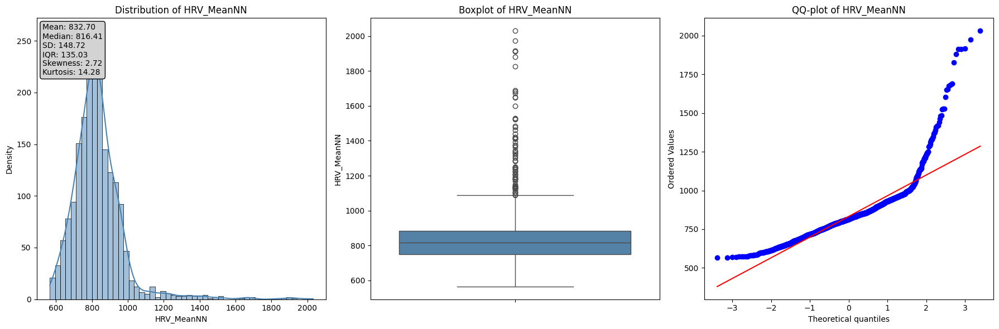

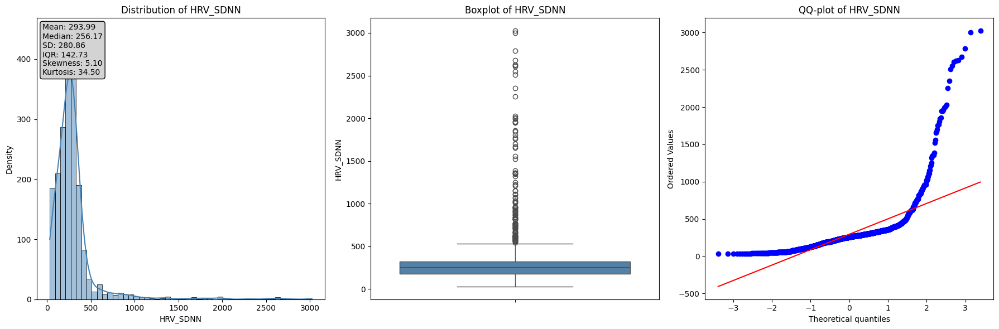

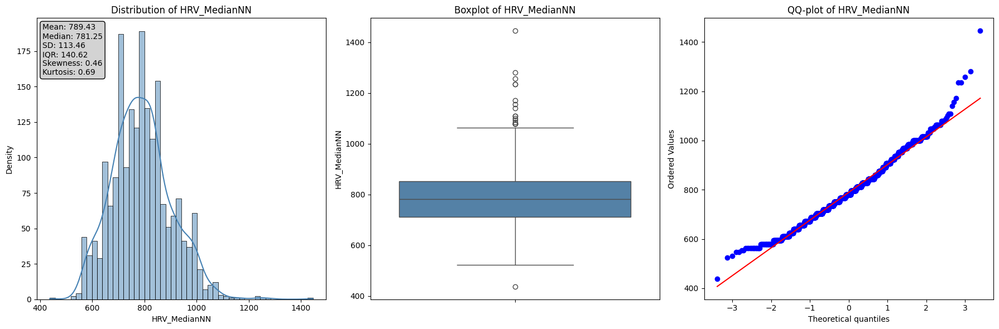

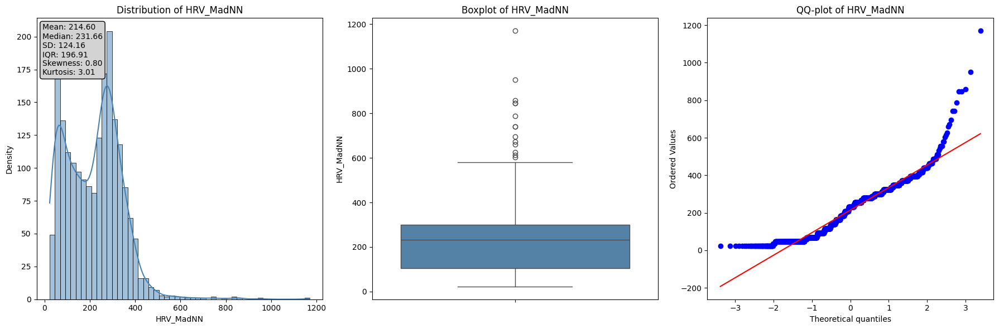

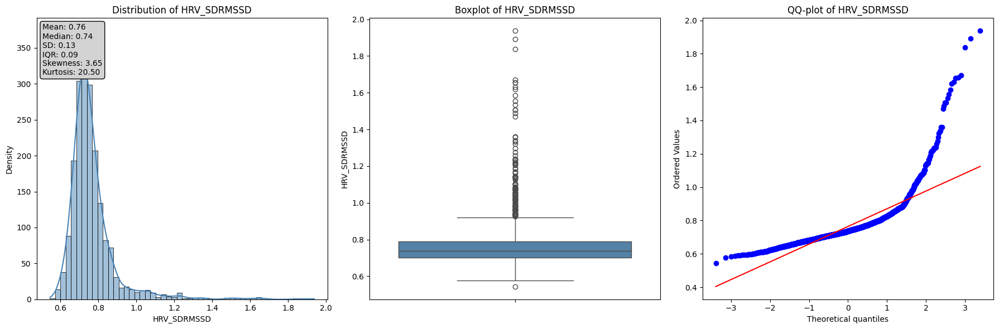

...

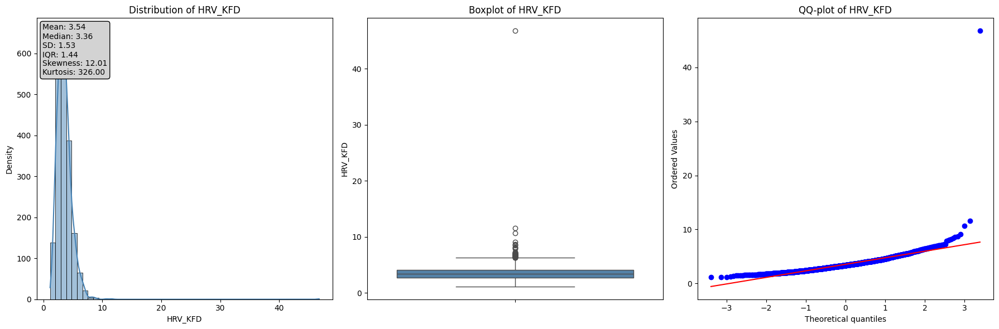

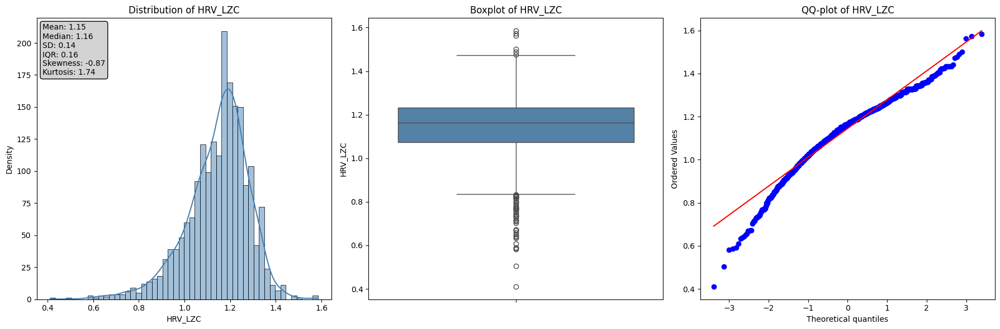

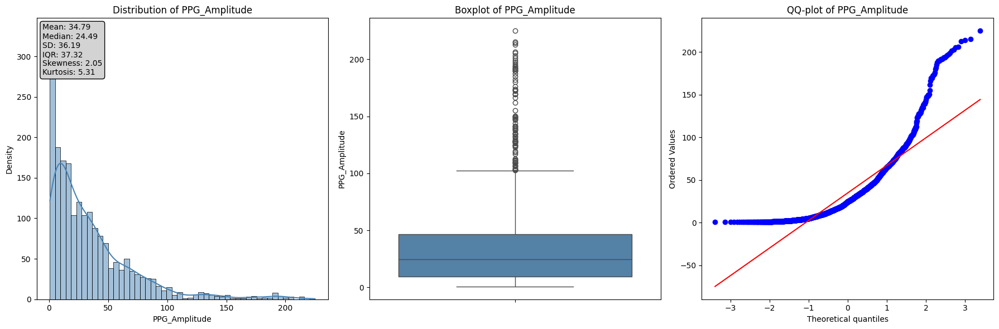

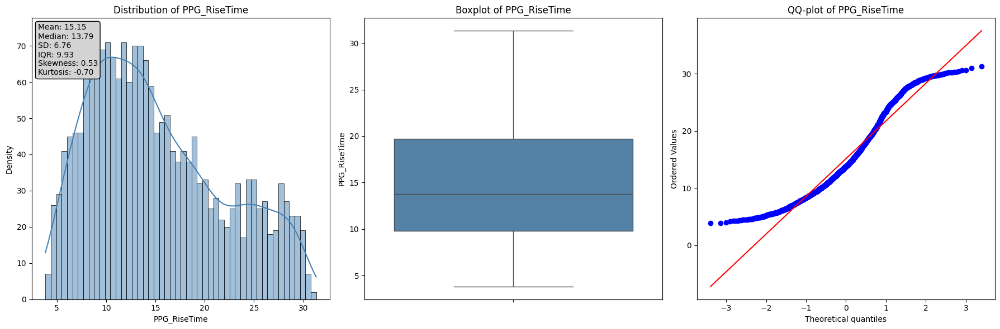

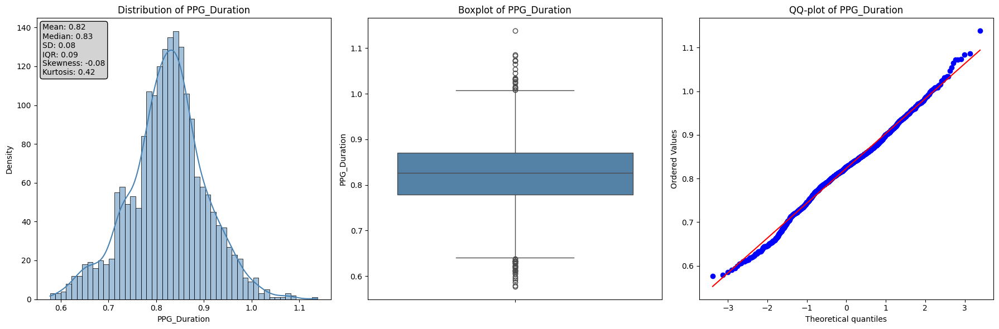

In [ ]:
plot_numerical_features(bvp_features)

In [ ]:
def shapiro_wilk_test(df, exclude_col='label', alpha=0.05):

    results = []
    numeric_cols = df.select_dtypes(include='number').columns.drop(exclude_col)

    for col in numeric_cols:
        stat, p_value = shapiro(df[col].dropna())
        is_normal = p_value > alpha
        results.append({
            "Feature": col,
            "W-Statistic": stat,
            "p-value": p_value,
            "Normally Distributed": "Yes" if is_normal else "No"
        })

    return pd.DataFrame(results).sort_values(by="p-value", ascending=True)

In [ ]:
shapiro_wilk_test(bvp_features)

,Feature,W-Statistic,p-value,Normally Distributed
15,HRV_SD1SD2,0.044718,1.322965e-71,No
13,HRV_LFHF,0.087822,1.075869e-70,No
1,HRV_SDNN,0.542154,8.147316e-58,No
18,HRV_GI,0.561642,4.776929e-57,No
35,HRV_KFD,0.635575,7.623749e-54,No
7,HRV_MinNN,0.671004,4.117513e-52,No
4,HRV_SDRMSSD,0.693920,6.606819e-51,No
27,HRV_MFDFA_alpha1_Fluctuation,0.695372,7.922708e-51,No
37,PPG_Amplitude,0.796440,2.269854e-44,No
6,HRV_pNN50,0.796925,2.471091e-44,No


In [ ]:
def test_label_subject_interaction(df, label_col='label', subject_col='subject', alpha=0.05):
    numerical_cols = df.drop(columns=[label_col, subject_col]).select_dtypes(include='number').columns
    summary = []

    for feature in numerical_cols:
        formula = f'{feature} ~ C({label_col}) + C({subject_col}) + C({label_col}):C({subject_col})'
        try:
            model = ols(formula, data=df).fit()
            anova_table = sm.stats.anova_lm(model, typ=2)

            p_label = anova_table.loc[f'C({label_col})', 'PR(>F)']
            p_subject = anova_table.loc[f'C({subject_col})', 'PR(>F)']
            p_interaction = anova_table.loc[f'C({label_col}):C({subject_col})', 'PR(>F)']

            summary.append({
                'feature': feature,
                'p_label': p_label,
                'p_subject': p_subject,
                'p_interaction': p_interaction,
                'significant_interaction': p_interaction < alpha
            })

        except Exception as e:
            summary.append({
                'feature': feature,
                'p_label': None,
                'p_subject': None,
                'p_interaction': None,
                'significant_interaction': None,
                'Error': str(e)
            })

    results_df = pd.DataFrame(summary)
    return results_df

In [ ]:
test_label_subject_interaction(bvp_features)

,feature,p_label,p_subject,p_interaction,significant_interaction
0,HRV_MeanNN,5.711618e-02,8.421441e-69,1.038482e-31,True
1,HRV_SDNN,1.122596e-11,2.778184e-31,2.142326e-08,True
2,HRV_MedianNN,2.708540e-07,7.866400e-119,2.356076e-56,True
3,HRV_MadNN,2.065606e-95,1.424220e-101,2.551910e-42,True
4,HRV_SDRMSSD,6.435257e-11,5.144160e-21,8.666971e-20,True
5,HRV_Prc20NN,7.421268e-67,9.495335e-97,5.345971e-34,True
6,HRV_pNN50,9.723931e-106,1.766542e-134,2.502715e-68,True
7,HRV_MinNN,3.786200e-32,7.243754e-41,4.759295e-13,True
8,HRV_HTI,4.961257e-92,1.778506e-86,8.866220e-46,True
9,HRV_TINN,7.921576e-03,4.711583e-39,8.114152e-17,True


In [ ]:
def plot_box_features(df, target="label", plots_per_row=3):

    continuous_features = df.select_dtypes(include='number').drop(columns=[target]).columns.tolist()
    num_features = len(continuous_features)
    num_rows = math.ceil(num_features / plots_per_row)

    fig, axes = plt.subplots(num_rows, plots_per_row, figsize=(plots_per_row * 6, num_rows * 5))
    axes = axes.flatten()

    for i, feature in enumerate(continuous_features):
        sns.boxplot(
            data=df,
            x=target,
            y=feature,
            hue=target,
            ax=axes[i],
            legend=False,
            palette=["lightcoral", "lightblue"]
        )
        axes[i].set_title(f"Boxplot of {feature} by {target}")
        axes[i].set_xlabel(target)
        axes[i].set_ylabel(feature)

    for j in range(i + 1, len(axes)):
        axes[j].axis("off")

    plt.tight_layout()
    plt.show()

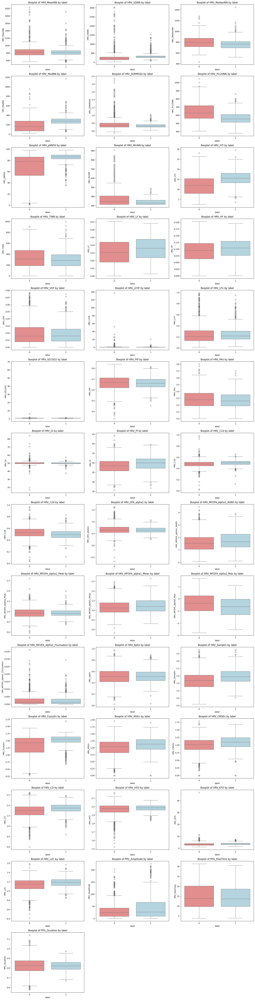

In [ ]:
plot_box_features(bvp_features)

In [ ]:
def mann_whitney_subjectwise(df, label_col='label', subject_col='subject', alpha=0.05, max_non_significant_subjects=5):
    subject_ids = df[subject_col].unique()
    features = [col for col in df.columns if col not in [label_col, subject_col] and pd.api.types.is_numeric_dtype(df[col])]

    non_significant_counts = {feature: 0 for feature in features}
    all_results = []

    for subject in subject_ids:
        df_s = df[df[subject_col] == subject]

        for feature in features:
            group1 = df_s[df_s[label_col] == 0][feature]
            group2 = df_s[df_s[label_col] == 1][feature]

            try:
                stat, p = mannwhitneyu(group1, group2, alternative='two-sided')
                if p > alpha:
                    non_significant_counts[feature] += 1
                all_results.append({
                    'subject': subject,
                    'feature': feature,
                    'U_stat': stat,
                    'p_value': p,
                    'significant': p < alpha
                })
            except:

                non_significant_counts[feature] += 1
                all_results.append({
                    'subject': subject,
                    'feature': feature,
                    'U_stat': None,
                    'p_value': None,
                    'significant': False
                })

    results_df = pd.DataFrame(all_results)

    to_drop = [feature for feature, count in non_significant_counts.items() if count > max_non_significant_subjects]

    return results_df, to_drop

In [ ]:
mw_results, features_to_drop = mann_whitney_subjectwise(bvp_features)

print("Feature da rimuovere:", features_to_drop)

Feature da rimuovere: ['HRV_MeanNN', 'HRV_SDRMSSD', 'HRV_MinNN', 'HRV_TINN', 'HRV_LF', 'HRV_HF', 'HRV_VHF', 'HRV_LFHF', 'HRV_LFn', 'HRV_SD1SD2', 'HRV_PIP', 'HRV_PAS', 'HRV_GI', 'HRV_PI', 'HRV_C1d', 'HRV_C2d', 'HRV_DFA_alpha1', 'HRV_MFDFA_alpha1_Width', 'HRV_MFDFA_alpha1_Peak', 'HRV_MFDFA_alpha1_Mean', 'HRV_MFDFA_alpha1_Max', 'HRV_MFDFA_alpha1_Fluctuation', 'HRV_ApEn', 'HRV_SampEn', 'HRV_MSEn', 'HRV_CMSEn', 'HRV_CD', 'HRV_HFD', 'HRV_LZC', 'PPG_RiseTime', 'PPG_Duration']


In [ ]:
bvp_features = bvp_features.drop(columns=features_to_drop, axis = 1)

In [ ]:
print("Final Shape of BVP Features:", bvp_features.shape)
bvp_features.head()

Final Shape of BVP Features: (1977, 13)


,HRV_SDNN,HRV_MedianNN,HRV_MadNN,HRV_Prc20NN,HRV_pNN50,HRV_HTI,HRV_FuzzyEn,HRV_KFD,PPG_Amplitude,label,subject,phase,session
0,241.082297,726.5625,162.159375,609.375,84.210526,12.666667,1.594395,3.505378,11.754638,0,P005,RELAX,PRE
1,227.699015,718.7500,138.993750,612.500,84.415584,11.000000,1.583590,3.557895,8.777484,0,P005,RELAX,PRE
2,227.041769,703.1250,162.159375,612.500,85.714286,11.000000,1.604215,2.784000,8.843158,0,P005,RELAX,PRE
3,196.316732,750.0000,138.993750,628.125,80.519481,15.400000,1.545847,3.367048,7.955898,0,P005,RELAX,PRE
4,165.391042,750.0000,162.159375,625.000,78.205128,15.600000,1.633012,5.517238,7.331028,0,P005,RELAX,PRE


In [ ]:
eda_raw = df["EDA"].values

fs = 64

eda_signals, eda_info = nk.eda_process(eda_raw, sampling_rate=fs)

eda_clean = eda_signals["EDA_Clean"]

df['EDA_CLEAN'] = eda_clean

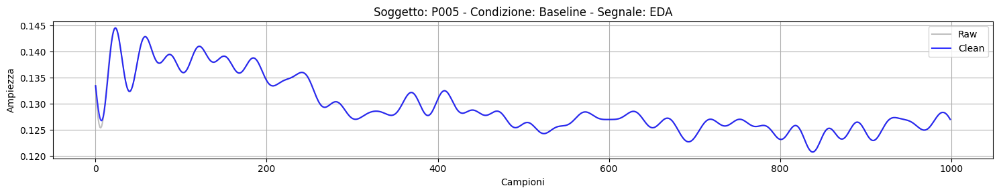

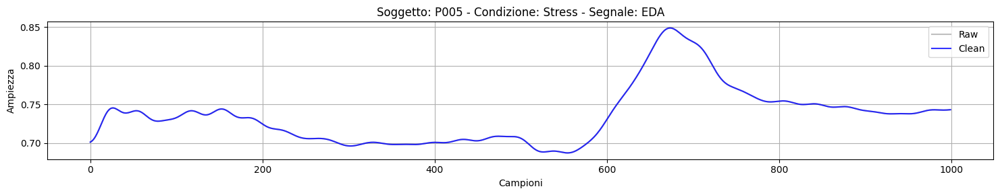

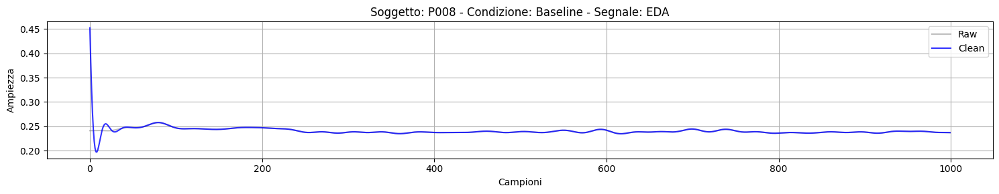

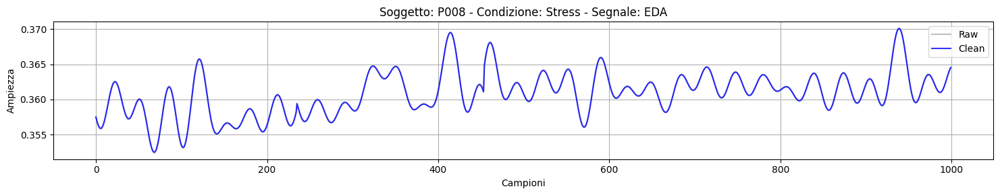

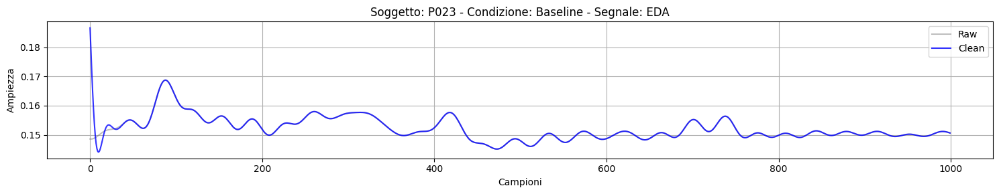

...

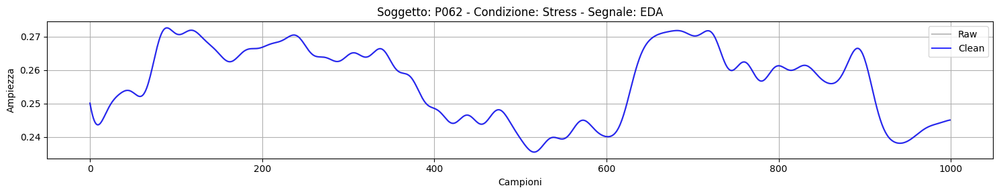

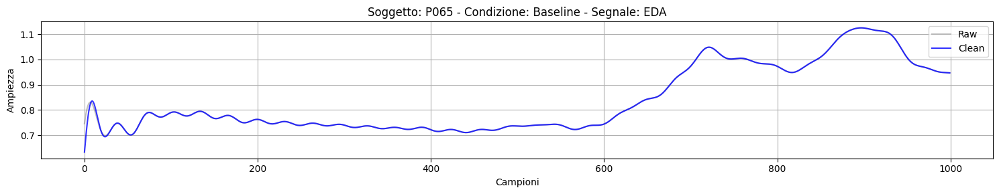

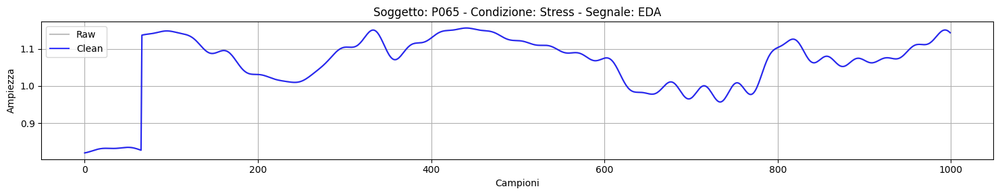

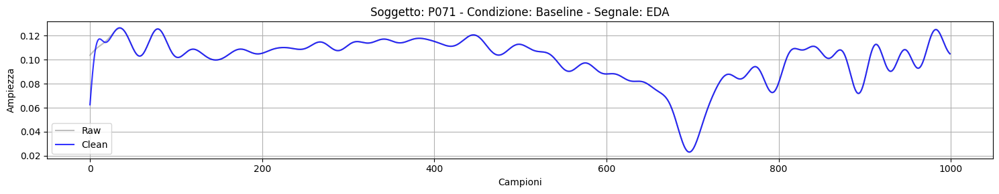

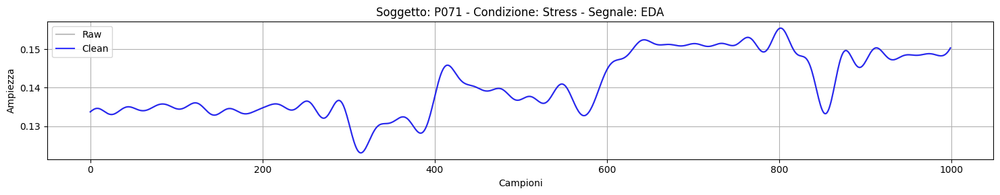

In [ ]:
plot_raw_vs_clean_from_single_df(df, 'EDA', 'EDA_CLEAN', n_points = 1000)

In [ ]:
# Parametri
fs = 64  # Frequenza di campionamento
window_sec = 60
overlap = 0.75
window_size = int(fs * window_sec)
step_size = int(window_size * (1 - overlap))

# Lista per raccogliere le feature
eda_features_list = []

# Scorri per finestra
for start in range(0, len(df) - window_size, step_size):
    window_signal = df["EDA_CLEAN"].iloc[start:start + window_size].values
    labels = df["label"].iloc[start:start + window_size].values
    subject = df["subject"].iloc[start]
    phase = df["phase"].iloc[start]
    session = df["session"].iloc[start]

    # Conta le etichette nella finestra
    counts = np.bincount(labels.astype(int), minlength=2)
    total = counts.sum()
    dominant_label = np.argmax(counts)
    dominant_ratio = counts[dominant_label] / total

    # Scarta finestre ambigue (<70% di predominanza)
    if dominant_ratio < 0.7:
        continue

    label = dominant_label

    try:
        # Estrai caratteristiche EDA da finestra
        eda_signals, eda_info = nk.eda_peaks(window_signal, sampling_rate=fs)
        features = nk.eda_intervalrelated(eda_signals, sampling_rate=fs)

        # Aggiungi metadati
        features["label"] = label
        features["subject"] = subject
        features["phase"] = phase
        features["session"] = session

        eda_features_list.append(features)

    except Exception as e:
        print(f"Errore nella finestra {start}-{start + window_size}: {e}")

# Combina tutte le feature in un unico DataFrame
if eda_features_list:
    eda_features = pd.concat(eda_features_list, ignore_index=True)
else:
    print("Nessuna finestra valida.")
    eda_features = pd.DataFrame()

In [ ]:
print("Shape of EDA features:", eda_features.shape)
eda_features.head()

Shape of EDA features: (1977, 9)


,SCR_Peaks_N,SCR_Peaks_Amplitude_Mean,EDA_Sympathetic,EDA_SympatheticN,EDA_Autocorrelation,label,subject,phase,session
0,37.0,0.004352,NaN,NaN,NaN,0,P005,RELAX,PRE
1,36.0,0.004107,NaN,NaN,NaN,0,P005,RELAX,PRE
2,35.0,0.003905,NaN,NaN,NaN,0,P005,RELAX,PRE
3,38.0,0.004363,NaN,NaN,NaN,0,P005,RELAX,PRE
4,41.0,0.004438,NaN,NaN,NaN,0,P005,RELAX,PRE


In [ ]:
eda_features.isna().sum()

,0
SCR_Peaks_N,0
SCR_Peaks_Amplitude_Mean,0
EDA_Sympathetic,1977
EDA_SympatheticN,1977
EDA_Autocorrelation,1977
label,0
subject,0
phase,0
session,0


In [ ]:
eda_features = drop_columns_with_nans(eda_features)
eda_features = eda_features.fillna(eda_features.median(numeric_only=True))

In [ ]:
sum(eda_features.isna().sum())

0

In [ ]:
eda_features.head()

,SCR_Peaks_N,SCR_Peaks_Amplitude_Mean,label,subject,phase,session
0,37.0,0.004352,0,P005,RELAX,PRE
1,36.0,0.004107,0,P005,RELAX,PRE
2,35.0,0.003905,0,P005,RELAX,PRE
3,38.0,0.004363,0,P005,RELAX,PRE
4,41.0,0.004438,0,P005,RELAX,PRE


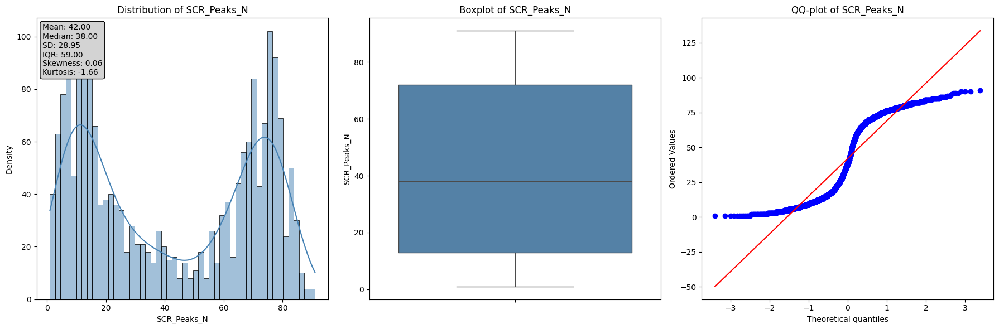

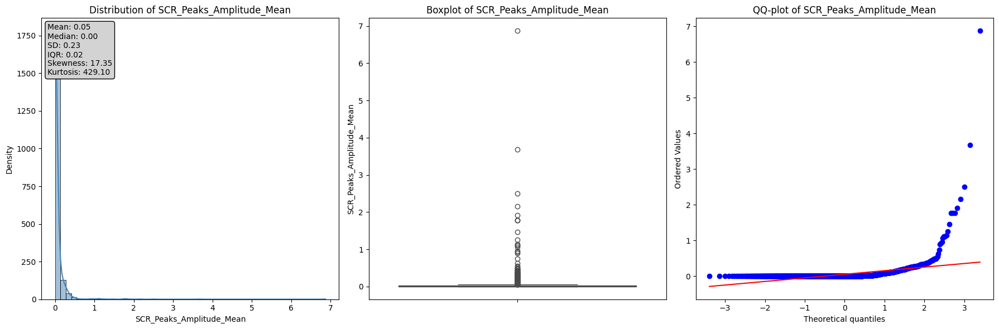

In [ ]:
plot_numerical_features(eda_features)

In [ ]:
shapiro_wilk_test(eda_features)

,Feature,W-Statistic,p-value,Normally Distributed
1,SCR_Peaks_Amplitude_Mean,0.191675,2.433818e-68,No
0,SCR_Peaks_N,0.870215,1.068498e-37,No


In [ ]:
test_label_subject_interaction(eda_features)

,feature,p_label,p_subject,p_interaction,significant_interaction
0,SCR_Peaks_N,5.927535e-52,3.130270e-57,1.024671e-10,True
1,SCR_Peaks_Amplitude_Mean,2.308252e-02,3.977274e-35,2.856129e-02,True


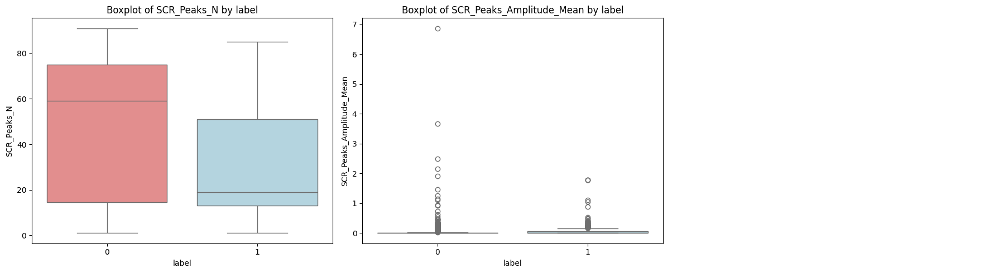

In [ ]:
plot_box_features(eda_features)

In [ ]:
mw_results, features_to_drop = mann_whitney_subjectwise(eda_features)

print("Feature da rimuovere:", features_to_drop)

Feature da rimuovere: ['SCR_Peaks_N']


In [ ]:
print("Final Shape of EDA Features:", eda_features.shape)
eda_features.head()

Final Shape of EDA Features: (1977, 6)


,SCR_Peaks_N,SCR_Peaks_Amplitude_Mean,label,subject,phase,session
0,37.0,0.004352,0,P005,RELAX,PRE
1,36.0,0.004107,0,P005,RELAX,PRE
2,35.0,0.003905,0,P005,RELAX,PRE
3,38.0,0.004363,0,P005,RELAX,PRE
4,41.0,0.004438,0,P005,RELAX,PRE


In [ ]:
def butter_highpass(cutoff, fs, order=5):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    b, a = butter(order, normal_cutoff, btype='high', analog=False)
    return b, a

def butter_lowpass(cutoff, fs, order=5):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    b, a = butter(order, normal_cutoff, btype='low', analog=False)
    return b, a

In [ ]:
def acc_denoise(acc_signal, fs):

    b_high, a_high = butter_highpass(0.5, fs)
    acc_signal = filtfilt(b_high, a_high, acc_signal)

    b_low, a_low = butter_lowpass(20.0, fs)
    acc_signal = filtfilt(b_low, a_low, acc_signal)

    return acc_signal

In [ ]:
df['ACC_MAG'] = np.sqrt(df['ACC1']**2+df['ACC2']**2+df['ACC3']**2)
df = df.drop(columns = ['ACC1', 'ACC2', 'ACC3'], axis = 1)

In [ ]:
fs = 64
df['ACC_MAG_CLEAN'] = acc_denoise(df['ACC_MAG'].values, fs)

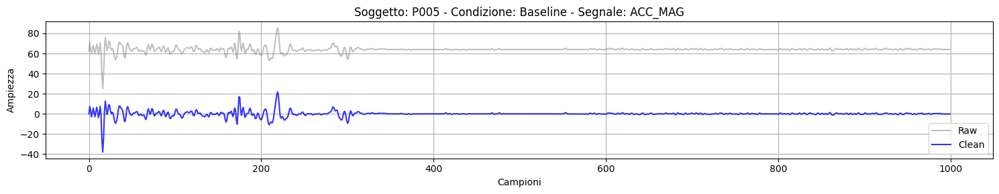

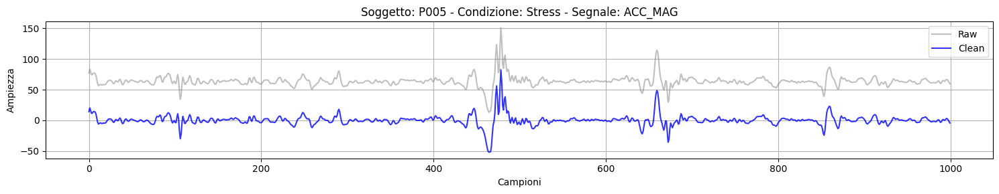

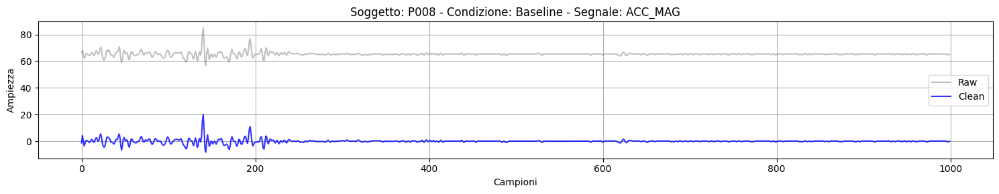

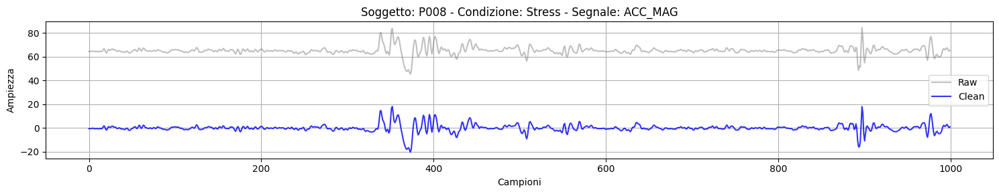

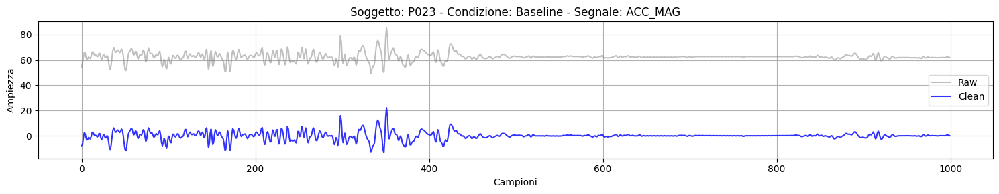

...

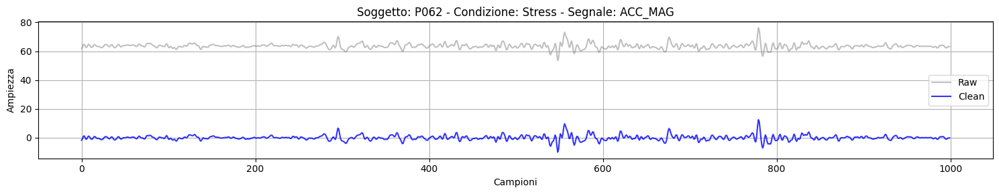

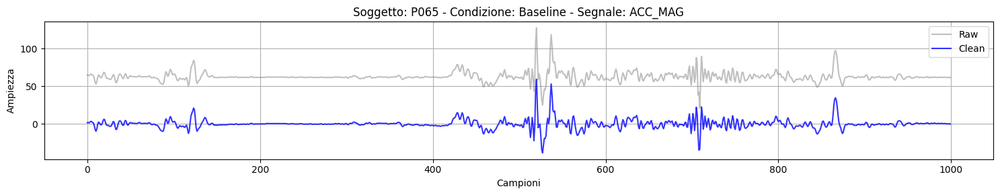

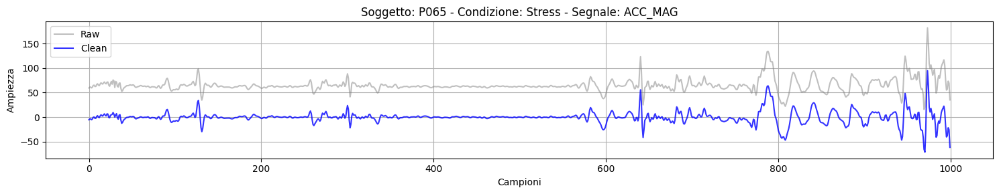

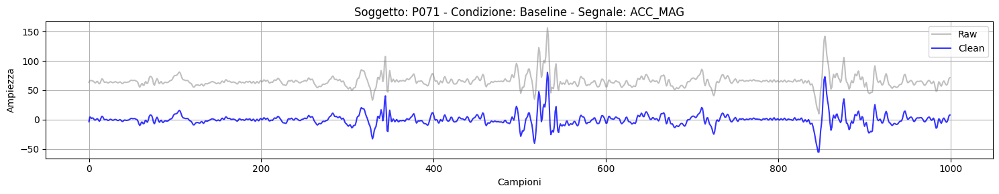

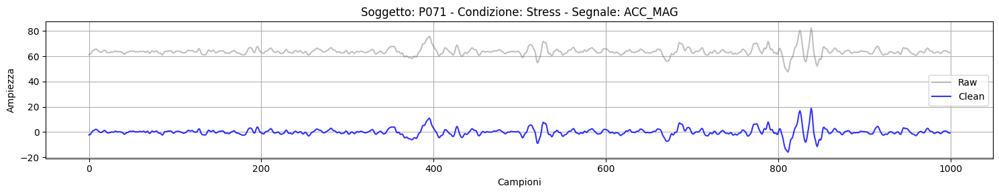

In [ ]:
plot_raw_vs_clean_from_single_df(df, 'ACC_MAG', 'ACC_MAG_CLEAN', n_points = 1000)

In [ ]:
# Parametri
fs = 64  # frequenza di campionamento
window_sec = 60
overlap = 0.75
window_size = int(fs * window_sec)
step_size = int(window_size * (1 - overlap))

# Lista per salvare le feature
acc_features_list = []

# Estrai feature per ciascun soggetto
for subject_id in df["subject"].unique():
    print(f"Elaborazione soggetto {subject_id}")
    df_s = df[df["subject"] == subject_id].reset_index(drop=True)

    for start in range(0, len(df_s) - window_size + 1, step_size):
        end = start + window_size
        window = df_s["ACC_MAG_CLEAN"].iloc[start:end].values
        labels = df_s["label"].iloc[start:start + window_size].values
        phases = df_s["phase"].iloc[start:start + window_size].values
        session = df_s["session"].iloc[start]

        if len(window) == 0:
            continue

        # Conta le etichette nella finestra
        counts = np.bincount(labels.astype(int), minlength=2)
        total = counts.sum()
        dominant_label = np.argmax(counts)
        dominant_ratio = counts[dominant_label] / total

        # Scarta la finestra se nessuna classe è predominante ≥ 70%
        if dominant_ratio < 0.7:
            continue

        label = dominant_label
        protocol_phase = pd.Series(phases).mode()[0]

        try:
            features = {
                "AccMag_Mean": np.mean(window),
                "AccMag_Std": np.std(window),
                "AccMag_Max": np.max(window),
                "AccMag_Min": np.min(window),
                "AccMag_Range": np.max(window) - np.min(window),
                "AccMag_Median": np.median(window),
                "AccMag_IQR": np.percentile(window, 75) - np.percentile(window, 25),
                "AccMag_Skew": scipy.stats.skew(window),
                "AccMag_Kurtosis": scipy.stats.kurtosis(window),
                "label": label,
                "subject": subject_id,
                "phase": protocol_phase,  # usa protocol_phase modalità se necessario
                "session": session
            }
            acc_features_list.append(features)

        except Exception as e:
            print(f"Errore finestra {start}-{end}: {e}")
            continue

# Combina le feature in un DataFrame
acc_features = pd.DataFrame(acc_features_list)

Elaborazione soggetto P005
Elaborazione soggetto P008
Elaborazione soggetto P023
Elaborazione soggetto P032
Elaborazione soggetto P035
Elaborazione soggetto P037
Elaborazione soggetto P038
Elaborazione soggetto P041
Elaborazione soggetto P043
Elaborazione soggetto P044
Elaborazione soggetto P046
Elaborazione soggetto P047
Elaborazione soggetto P049
Elaborazione soggetto P058
Elaborazione soggetto P062
Elaborazione soggetto P065
Elaborazione soggetto P071


In [ ]:
print("Shape of ACC Features", acc_features.shape)
acc_features.head()

Shape of ACC Features (1945, 13)


,AccMag_Mean,AccMag_Std,AccMag_Max,AccMag_Min,AccMag_Range,AccMag_Median,AccMag_IQR,AccMag_Skew,AccMag_Kurtosis,label,subject,phase,session
0,-0.006293,4.486040,54.849013,-38.144843,92.993857,-0.066113,1.282710,1.657764,30.981339,0,P005,RELAX,PRE
1,-0.000140,4.799695,54.849013,-32.159447,87.008460,-0.072885,1.483798,1.857713,27.438934,0,P005,RELAX,PRE
2,-0.001071,4.273247,44.474567,-32.159447,76.634014,-0.039412,1.489626,1.614605,28.032515,0,P005,RELAX,PRE
3,-0.001218,2.900711,44.474567,-24.412122,68.886689,-0.023265,0.877292,1.817050,49.947262,0,P005,RELAX,PRE
4,0.002359,2.429859,44.474567,-24.412122,68.886689,-0.028170,0.434830,3.031965,93.492645,0,P005,RELAX,PRE


In [ ]:
acc_features.isna().sum()

,0
AccMag_Mean,0
AccMag_Std,0
AccMag_Max,0
AccMag_Min,0
AccMag_Range,0
AccMag_Median,0
AccMag_IQR,0
AccMag_Skew,0
AccMag_Kurtosis,0
label,0


In [ ]:
acc_features, removed_cols = drop_highly_correlated_features(acc_features, exclude_cols=['label', 'subject', 'phase', 'session'])

print("Colonne rimosse:", removed_cols)
print("Dimensione dataset:", acc_features.shape)

Colonne rimosse: ['AccMag_Max', 'AccMag_Min', 'AccMag_Range', 'AccMag_IQR']
Dimensione dataset: (1945, 9)


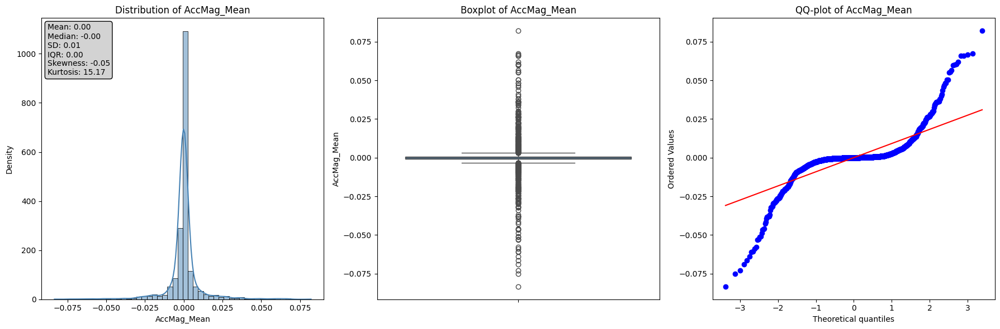

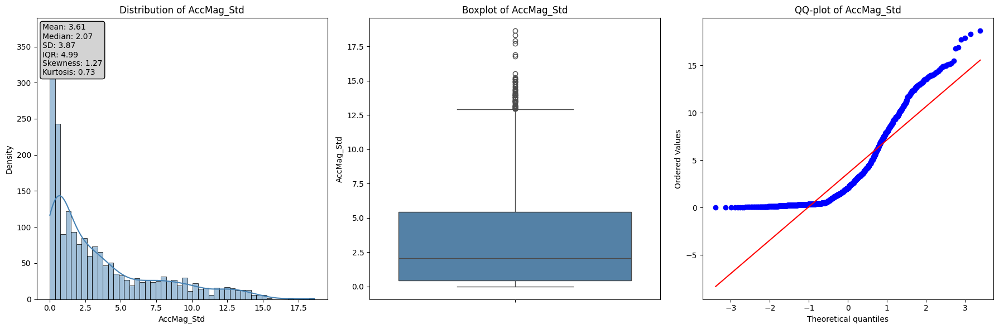

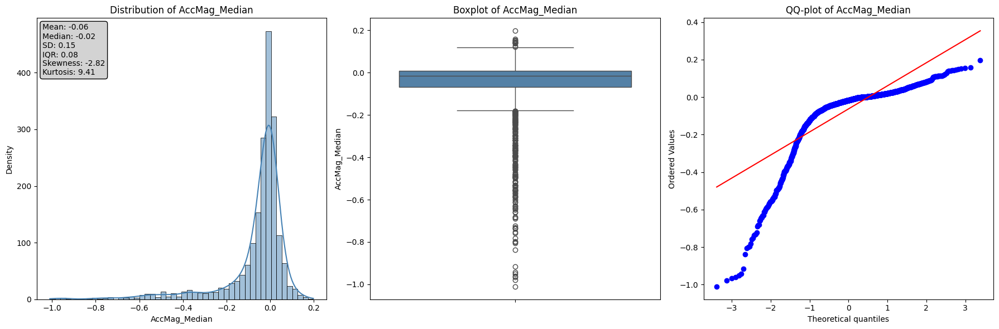

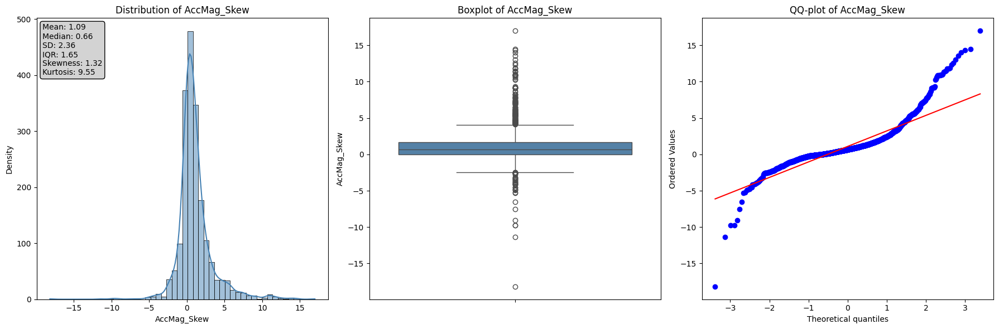

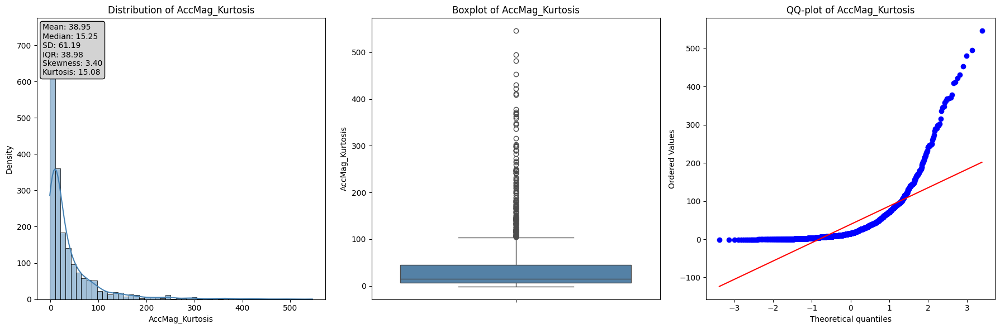

In [ ]:
plot_numerical_features(acc_features)

In [ ]:
shapiro_wilk_test(acc_features)

,Feature,W-Statistic,p-value,Normally Distributed
4,AccMag_Kurtosis,0.615664,1.939868e-54,No
0,AccMag_Mean,0.642034,3.170098e-53,No
2,AccMag_Median,0.673796,1.163542e-51,No
3,AccMag_Skew,0.816821,1.754307e-42,No
1,AccMag_Std,0.826620,1.174912e-41,No


In [ ]:
test_label_subject_interaction(acc_features)

,feature,p_label,p_subject,p_interaction,significant_interaction
0,AccMag_Mean,6.221819e-01,9.998812e-01,4.762848e-02,True
1,AccMag_Std,1.511033e-132,1.056135e-115,3.029870e-58,True
2,AccMag_Median,2.810296e-104,7.921162e-119,2.299550e-109,True
3,AccMag_Skew,1.722885e-01,1.224106e-06,9.945493e-02,False
4,AccMag_Kurtosis,3.441314e-24,7.610559e-06,9.096788e-02,False


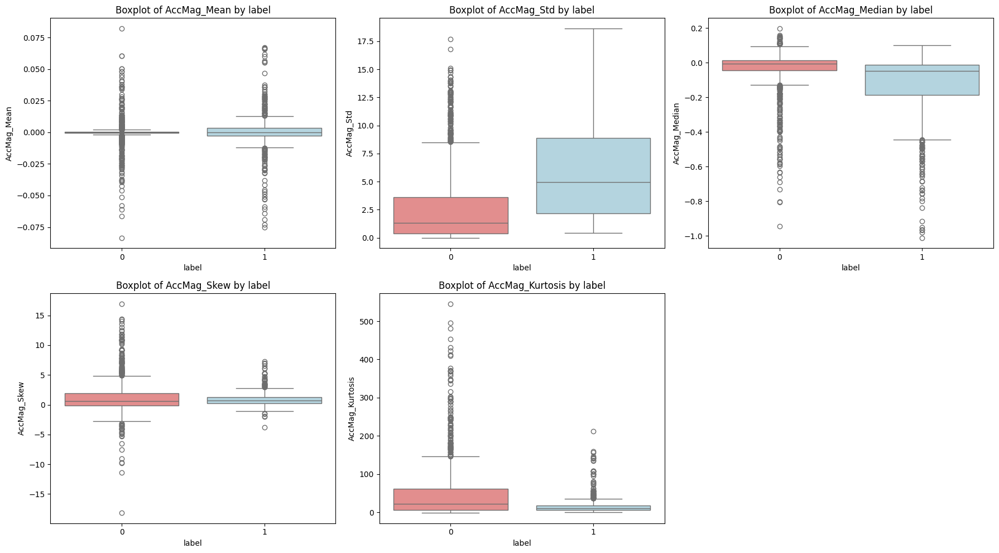

In [ ]:
plot_box_features(acc_features)

In [ ]:
mw_results, features_to_drop = mann_whitney_subjectwise(eda_features)

print("Feature da rimuovere:", features_to_drop)

Feature da rimuovere: ['SCR_Peaks_N']


In [ ]:
print("Final Shape of ACC Features:", acc_features.shape)
acc_features.head()

Final Shape of ACC Features: (1945, 9)


,AccMag_Mean,AccMag_Std,AccMag_Median,AccMag_Skew,AccMag_Kurtosis,label,subject,phase,session
0,-0.006293,4.486040,-0.066113,1.657764,30.981339,0,P005,RELAX,PRE
1,-0.000140,4.799695,-0.072885,1.857713,27.438934,0,P005,RELAX,PRE
2,-0.001071,4.273247,-0.039412,1.614605,28.032515,0,P005,RELAX,PRE
3,-0.001218,2.900711,-0.023265,1.817050,49.947262,0,P005,RELAX,PRE
4,0.002359,2.429859,-0.028170,3.031965,93.492645,0,P005,RELAX,PRE


In [ ]:
def temp_denoise(temp_signal, fs):
  b_low, a_low = butter_lowpass(0.5, fs)
  temp_signal = filtfilt(b_low, a_low, temp_signal)
  return temp_signal

In [ ]:
fs = 64
df['TEMP_CLEAN'] = temp_denoise(df['TEMP'].values, fs)

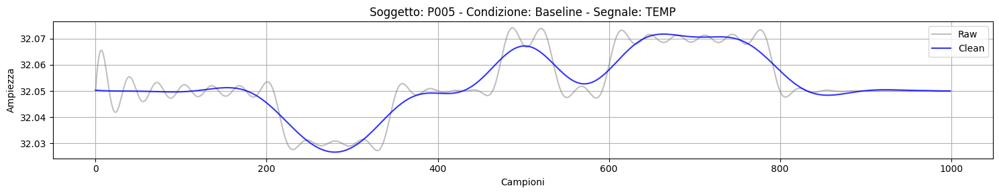

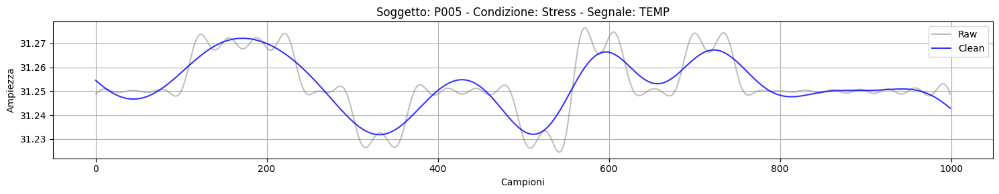

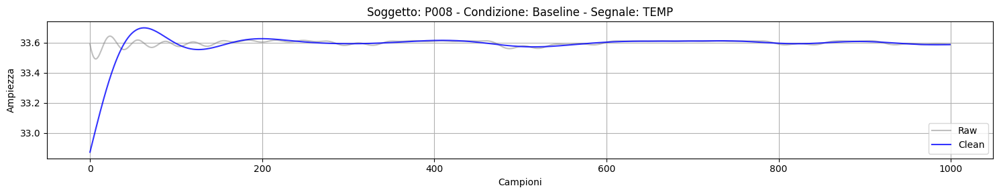

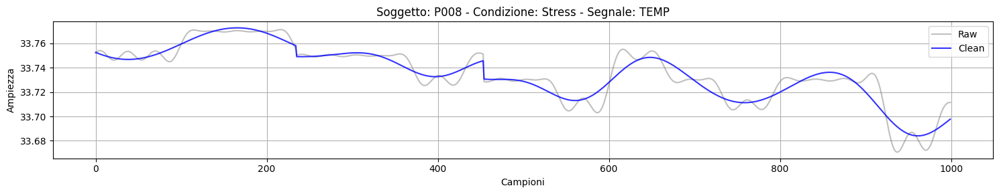

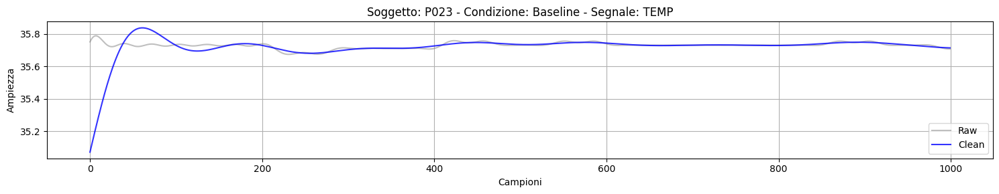

...

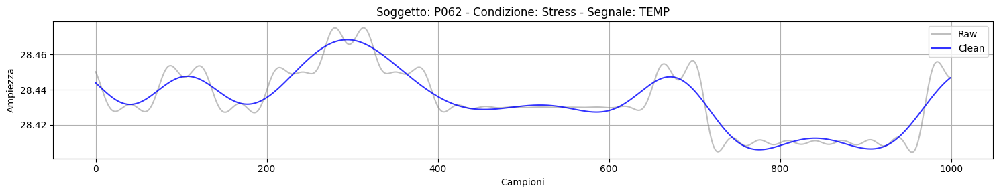

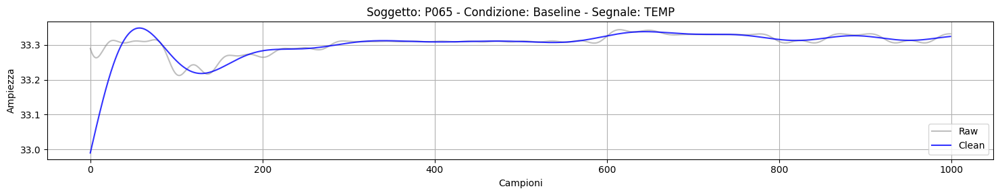

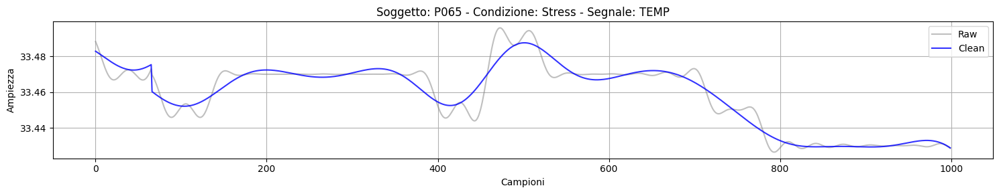

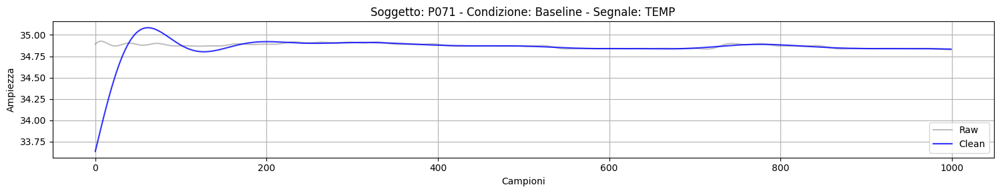

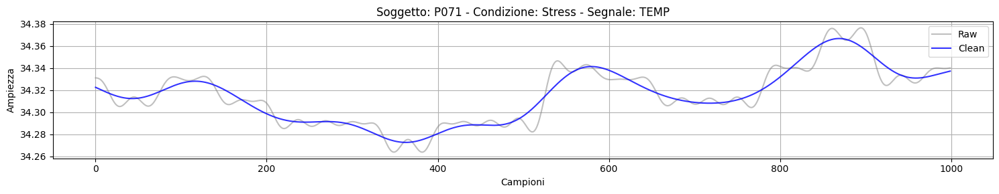

In [ ]:
plot_raw_vs_clean_from_single_df(df, 'TEMP', 'TEMP_CLEAN', n_points = 1000)

In [ ]:
# Parametri
fs = 64  # frequenza di campionamento
window_sec = 60
overlap = 0.75
window_size = int(window_sec * fs)
step_size = int(window_size * (1 - overlap))

# Lista per raccogliere le feature
features_list = []

# Estrazione feature per ogni finestra
for start in range(0, len(df) - window_size + 1, step_size):
    end = start + window_size
    window_signal = df["TEMP_CLEAN"].iloc[start:end].values
    window_labels = df["label"].iloc[start:end].values
    window_phases = df["phase"].iloc[start:end].values
    window_subject = df["subject"].iloc[start]
    window_session = df["session"].iloc[start]

    # Conta le etichette nella finestra
    counts = np.bincount(window_labels.astype(int), minlength=2)
    total = counts.sum()
    dominant_label = np.argmax(counts)
    dominant_ratio = counts[dominant_label] / total

    # Scarta la finestra se non c'è predominanza ≥ 70%
    if dominant_ratio < 0.7:
        continue

    label = dominant_label
    protocol_phase = pd.Series(window_phases).mode()[0]

    try:
        mean_val = np.mean(window_signal)
        std_val = np.std(window_signal)
        min_val = np.min(window_signal)
        max_val = np.max(window_signal)
        slope = np.polyfit(np.arange(len(window_signal)), window_signal, 1)[0]

        features = {
            "Temp_Mean": mean_val,
            "Temp_Std": std_val,
            "Temp_Min": min_val,
            "Temp_Max": max_val,
            "Temp_Slope": slope,
            "label": label,
            "subject": window_subject,
            "phase": protocol_phase,
            "session": window_session
        }

        features_list.append(features)

    except Exception as e:
        print(f"Errore nella finestra {start}-{end}: {e}")
        continue

# Combina tutte le feature in un unico DataFrame
if features_list:
    temp_features = pd.DataFrame(features_list)
else:
    print("Nessuna finestra valida.")
    temp_features = pd.DataFrame()

In [ ]:
print("Shape of TEMP Features", temp_features.shape)
temp_features.head()

Shape of TEMP Features (1977, 9)


,Temp_Mean,Temp_Std,Temp_Min,Temp_Max,Temp_Slope,label,subject,phase,session
0,32.051672,0.008743,32.026621,32.071759,0.000001,0,P005,RELAX,PRE
1,32.055670,0.011645,32.032514,32.088154,0.000007,0,P005,RELAX,PRE
2,32.056677,0.012085,32.030968,32.088154,0.000003,0,P005,RELAX,PRE
3,32.053362,0.016861,32.005182,32.088154,-0.000008,0,P005,RELAX,PRE
4,32.043338,0.024214,31.992677,32.088154,-0.000018,0,P005,RELAX,PRE


In [ ]:
temp_features.isna().sum()

,0
Temp_Mean,0
Temp_Std,0
Temp_Min,0
Temp_Max,0
Temp_Slope,0
label,0
subject,0
phase,0
session,0


In [ ]:
temp_features, removed_cols = drop_highly_correlated_features(temp_features, exclude_cols=['label', 'subject', 'phase', 'session'])

print("Colonne rimosse:", removed_cols)
print("Dimensione dataset:", temp_features.shape)

Colonne rimosse: ['Temp_Min', 'Temp_Max']
Dimensione dataset: (1977, 7)


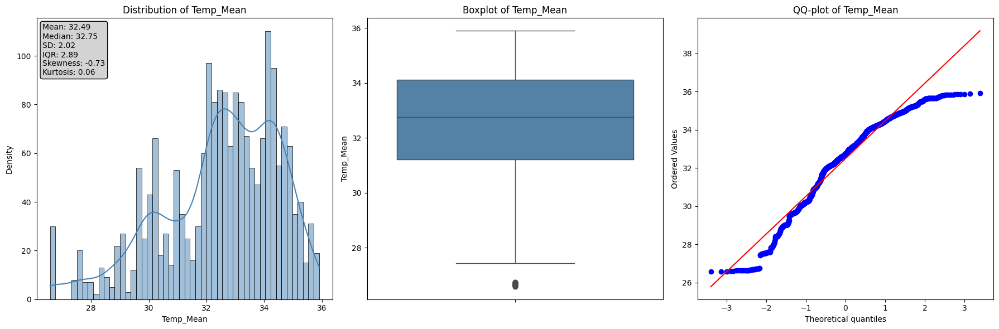

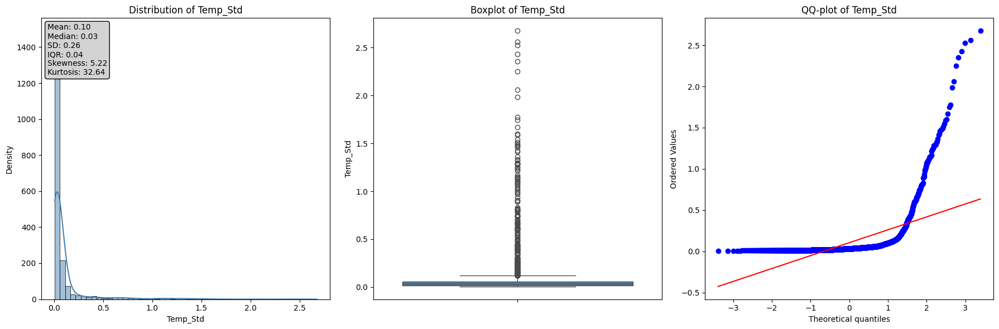

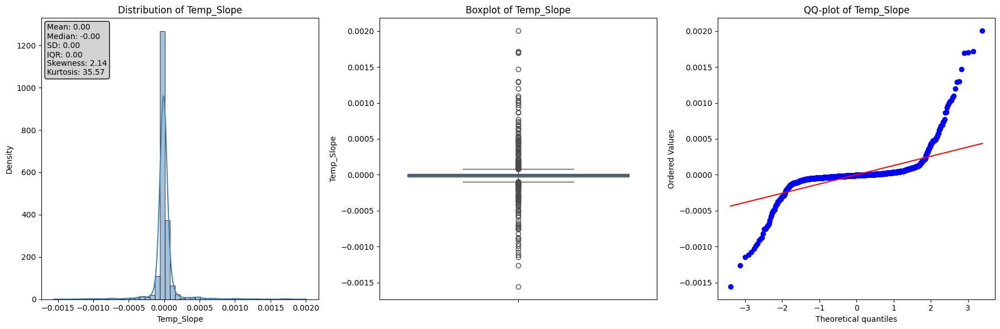

In [ ]:
plot_numerical_features(temp_features)

In [ ]:
shapiro_wilk_test(temp_features)

,Feature,W-Statistic,p-value,Normally Distributed
1,Temp_Std,0.361027,7.062297e-64,No
2,Temp_Slope,0.488654,8.622345e-60,No
0,Temp_Mean,0.953879,1.678901e-24,No


In [ ]:
test_label_subject_interaction(temp_features)

,feature,p_label,p_subject,p_interaction,significant_interaction
0,Temp_Mean,0.106253,7.732876e-119,0.011668,True
1,Temp_Std,0.223206,2.108792e-01,0.993738,False
2,Temp_Slope,0.008605,9.094186e-01,0.708761,False


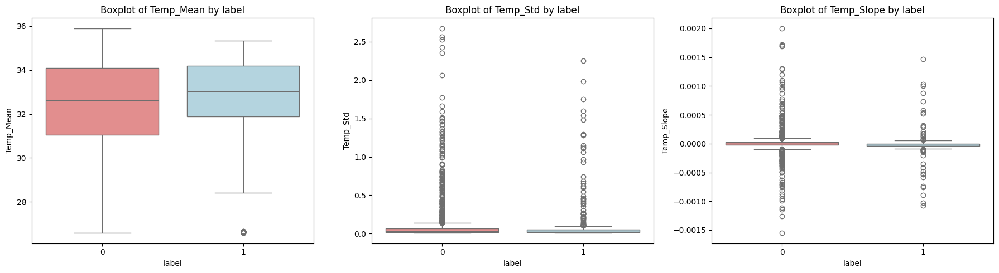

In [ ]:
plot_box_features(temp_features)

In [ ]:
mw_results, features_to_drop = mann_whitney_subjectwise(temp_features)

print("Feature da rimuovere:", features_to_drop)

Feature da rimuovere: ['Temp_Mean', 'Temp_Std']


In [ ]:
temp_features = temp_features.drop(columns = features_to_drop, axis = 1)

In [ ]:
print("Final Shape of TEMP Features:", temp_features.shape)
temp_features.head()

Final Shape of TEMP Features: (1977, 5)


,Temp_Slope,label,subject,phase,session
0,0.000001,0,P005,RELAX,PRE
1,0.000007,0,P005,RELAX,PRE
2,0.000003,0,P005,RELAX,PRE
3,-0.000008,0,P005,RELAX,PRE
4,-0.000018,0,P005,RELAX,PRE


In [ ]:
print("Final Shape of BVP Features:", bvp_features.shape)
print("Final Shape of EDA Features:", eda_features.shape)
print("Final Shape of ACC Features:", acc_features.shape)
print("Final Shape of TEMP Features:", temp_features.shape)

Final Shape of BVP Features: (1977, 13)
Final Shape of EDA Features: (1977, 6)
Final Shape of ACC Features: (1945, 9)
Final Shape of TEMP Features: (1977, 5)


In [ ]:
# Trova la lunghezza minima
min_len = min(len(bvp_features), len(eda_features), len(acc_features), len(temp_features))

# Troncamento e reindicizzazione
bvp_trimmed = bvp_features.iloc[:min_len].reset_index(drop=True)
eda_trimmed = eda_features.iloc[:min_len].reset_index(drop=True)
acc_trimmed = acc_features.iloc[:min_len].reset_index(drop=True)
temp_trimmed = temp_features.iloc[:min_len].reset_index(drop=True)

# Verifica che le colonne label e subject siano allineate
# Se presenti in ogni dataframe, tienile solo da uno (es: da bvp_trimmed)
eda_trimmed = eda_trimmed.drop(columns=['label', 'subject', 'phase', 'session'], errors='ignore')
acc_trimmed = acc_trimmed.drop(columns=['label', 'subject', 'phase', 'session'], errors='ignore')
temp_trimmed = temp_trimmed.drop(columns=['label', 'subject', 'phase', 'session'], errors='ignore')

# Concatenazione finale
all_features = pd.concat([bvp_trimmed, eda_trimmed, acc_trimmed, temp_trimmed], axis=1)

# Controllo dimensioni
print("Final shape of concatenated dataset:", all_features.shape)

Final shape of concatenated dataset: (1945, 21)


In [ ]:
all_features.head()

,HRV_SDNN,HRV_MedianNN,HRV_MadNN,HRV_Prc20NN,HRV_pNN50,HRV_HTI,HRV_FuzzyEn,HRV_KFD,PPG_Amplitude,label,...,phase,session,SCR_Peaks_N,SCR_Peaks_Amplitude_Mean,AccMag_Mean,AccMag_Std,AccMag_Median,AccMag_Skew,AccMag_Kurtosis,Temp_Slope
0,241.082297,726.5625,162.159375,609.375,84.210526,12.666667,1.594395,3.505378,11.754638,0,...,RELAX,PRE,37.0,0.004352,-0.006293,4.486040,-0.066113,1.657764,30.981339,0.000001
1,227.699015,718.7500,138.993750,612.500,84.415584,11.000000,1.583590,3.557895,8.777484,0,...,RELAX,PRE,36.0,0.004107,-0.000140,4.799695,-0.072885,1.857713,27.438934,0.000007
2,227.041769,703.1250,162.159375,612.500,85.714286,11.000000,1.604215,2.784000,8.843158,0,...,RELAX,PRE,35.0,0.003905,-0.001071,4.273247,-0.039412,1.614605,28.032515,0.000003
3,196.316732,750.0000,138.993750,628.125,80.519481,15.400000,1.545847,3.367048,7.955898,0,...,RELAX,PRE,38.0,0.004363,-0.001218,2.900711,-0.023265,1.817050,49.947262,-0.000008
4,165.391042,750.0000,162.159375,625.000,78.205128,15.600000,1.633012,5.517238,7.331028,0,...,RELAX,PRE,41.0,0.004438,0.002359,2.429859,-0.028170,3.031965,93.492645,-0.000018


In [ ]:
# Percorso per formato pickle
save_path_pkl = "/content/drive/MyDrive/VerBIO_Public/VERBIO DATASET PKL/VERBIO_E4_60SEC_75OL.pkl"

# Salvataggio
all_features.to_pickle(save_path_pkl)

print(f"Dataset salvato in formato pickle in: {save_path_pkl}")

Dataset salvato in formato pickle in: /content/drive/MyDrive/VerBIO_Public/VERBIO DATASET PKL/VERBIO_E4_60SEC_75OL.pkl
